In [2]:
import os
import glob
import numpy as np
import xarray as xr
from scipy.ndimage import rotate

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import matplotlib
matplotlib.rcParams.update({'font.size':15})
import time
import cartopy.crs as ccrs
import cartopy
CMIP6_FOLDER = "/global/cfs/projectdirs/m3522/cmip6/"
SCRATCH="/global/cscratch1/sd/qnicolas/"

import sys
p = os.path.abspath('/global/homes/q/qnicolas/')
if p not in sys.path:
    sys.path.append(p)

from orographicPrecipitation.observationsAndERA5.mountainUtils import *

from scipy.stats import linregress
xr.set_options(display_style='text') 

# Functions, data loading

In [2]:
def resample_monthly(ds):
    """performs the same job as resample(time="1M") but keeps missing months out"""
    dsm = ds.resample(time='1M').mean()
    return dsm.dropna('time')

In [3]:
# Monthly data
orogm=xr.open_dataset(CMIP6_FOLDER+"ERA5/e5.oper.invariant/197901/e5.oper.invariant.128_129_z.ll025sc.1979010100_1979010100.nc").Z.isel(time=0)/9.81

gpm_pr_seasmean=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/GPM-IMERG-seasonalmean-200101-201812.nc")

era5100u_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.228_246_100u.2001-2018.nc")
era5100v_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.228_247_100v.2001-2018.nc")

era5sst_seasmean=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.climatology.128_034_sstk.2001-2018.nc")
era5sst_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.128_034_sstk.2001-2018.nc")


In [4]:
#Ghats      = MountainRangeCustom("ghats"      ,[68,85,7.5,17]   ,"Western Ghats"           ,70 ,[6,7,8]  ,[ 75  ,   9  ,  72.5, 16   ,2  ],[68, 69, 10, 15]  )
#Myanmar    = MountainRangeCustom("myanmar"    ,[85,105,12,29]   ,"Myanmar"                 ,60 ,[6,7,8]  ,[ 98  ,  11  ,  90  , 21   ,4  ],[86,89,12,15]     )
#Vietnam    = MountainRangeCustom("vietnam"    ,[102,115,10,19.5],"Annamite range (Vietnam)",240,[10,11]  ,[107  ,  19  , 110.5, 14   ,2  ],[112, 115, 17, 20])
#Malaysia   = MountainRangeCustom("malaysia"   ,[97,107,1,10]    ,"Malaysia"                ,225,[11,12]  ,[100.5,  10  , 105  , 4    ,2  ],[105,107,7,9]    )
#Philippines= MountainRangeCustom("philippines",[118,130,10,22]  ,"Philippines"             ,225,[11,12]  ,[123.5,  19  , 127  , 11   ,3  ],[129,130,13,20]   )
#Newbritain = MountainRangeCustom("newbritain" ,[146,155,-12,0]  ,"New Britain"             ,320,[6,7,8]  ,[154  , - 6  , 150  , -8   ,2  ],[153,155,-11,-9] )

Ghats      = MountainRangeCustom("ghats"      ,[64,82,7,24]   ,"Western Ghats"           ,70 ,[6,7,8]  ,[ 75  ,   9  ,  71.5, 20   ,2  ])
Myanmar    = MountainRangeCustom("myanmar"    ,[84,102,7,24]  ,"Myanmar"                 ,60 ,[6,7,8]  ,[ 98  ,  11  ,  90  , 21   ,4  ])
Vietnam    = MountainRangeCustom("vietnam"    ,[100,118,8,25] ,"Annamite range (Vietnam)",240,[10,11]  ,[108  ,  18  , 111  , 13   ,2  ])
Malaysia   = MountainRangeCustom("malaysia"   ,[96,114,-2,15] ,"Malaysia"                ,225,[11,12]  ,[102.5,   8  , 105.5,  3   ,2  ])
Philippines= MountainRangeCustom("philippines",[117,135,5,22] ,"Philippines"             ,225,[11,12]  ,[123.5,  17  , 127  ,  9   ,2  ])
Newbritain = MountainRangeCustom("newbritain" ,[145,163,-17,0],"New Britain"             ,320,[6,7,8]  ,[154  , - 5.5, 150  , -8.5 ,2  ])

Ghats      .angleL = 90
Myanmar    .angleL = 60
Vietnam    .angleL = 250
Malaysia   .angleL = 240
Philippines.angleL = 260
Newbritain .angleL = 275

In [5]:
%%time
MRs = (Ghats,Myanmar,Vietnam,Malaysia,Philippines,Newbritain)
ti = time.time()
for MR in MRs:
    print(MR.name)
    MR.set_daily_spavg_var('128_133_q','Q','pl',where='upstream')
    MR.set_daily_spavg_var('128_130_t','T','pl',where='upstream')
    MR.set_daily_spavg_var('162_071_viwve','VIWVE','vinteg',where='upstream')
    MR.set_daily_spavg_var('162_072_viwvn','VIWVN','vinteg',where='upstream')
    MR.set_viwvperp_sfc()
    #MR.set_daily_spavg_var('128_137_tcwv','TCWV','sfc',where='upstream')
    
    MR.set_daily_sfc_var('228_246_100u','VAR_100U')
    MR.set_daily_sfc_var('228_247_100v','VAR_100V')
    MR.set_uperp_sfc()
    MR.vars['VAR_100U_PARA_DAILY'] = crossslopeflow(MR.vars['VAR_100U_DAILY'], MR.vars['VAR_100V_DAILY'],MR.angle-90)
    
    MR.set_daily_uLvL(extra_levels=['900'])
    MR.set_uperp_L(MR.angleL,extra_levels=['900'])
    MR.vars['UL_PARA_DAILY'] = crossslopeflow(MR.vars['UL_DAILY'], MR.vars['VL_DAILY'],MR.angle-90)
    
    print('%is'%(time.time()-ti));ti = time.time()
  
    MR.set_daily_imerg()
    MR.set_daily_Bl_vars()
    MR.set_daily_Blsimple_vars()
    MR.set_daily_Bl_vars()
    MR.set_daily_Blsimple_vars('deep')
    print('%is'%(time.time()-ti));ti = time.time()
    
    MR.set_2dvar('SST',era5sst_seasmean)
    MR.set_othervar('SST_3D',sel_box(era5sst_monthly,MR.box))
    
    
    
    for varname in 'TL','QL','TLDEEP','QLDEEP','EB','BL','BLSIMPLE','BLDEEPSIMPLE','GPM_PR':
        grid = MR.vars[varname+'_DAILY']
        MR.set_spatialmean(varname,'above',tilted_rect(grid,*MR.box_tilted,reverse=False),box=None)
        MR.set_spatialmean(varname,'rce',tilted_rect_distance(grid,*MR.box_tilted[:-1],-3,-5),box=None)
        MR.set_spatialmean(varname,'closeupstream',tilted_rect_distance(grid,*MR.box_tilted[:-1],-1,-2),box=None)
    print('%is'%(time.time()-ti));ti = time.time()
       
    for varname in 'VAR_100U_PERP','UL_PERP','U900_PERP':
        grid = MR.vars['VAR_100U_DAILY']
        MR.set_spatialmean(varname,'interval',tilted_rect_distance(grid,*MR.box_tilted[:-1],0,-3),box=None)
        MR.set_spatialmean(varname,'closeinterval',tilted_rect_distance(grid,*MR.box_tilted[:-1],0,-1),box=None)
    print('%is'%(time.time()-ti));ti = time.time()


ghats
0s
8s


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


12s
1s
myanmar
1s
9s
9s
1s
vietnam
0s
6s


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


7s
1s
malaysia
0s
6s


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


6s
1s
philippines
0s
6s
6s
1s
newbritain
1s
9s
9s
1s
CPU times: user 44.1 s, sys: 54 s, total: 1min 38s
Wall time: 1min 50s


In [6]:
%%time
ti = time.time()
for MR in MRs:
    print(MR.name)
    MR.set_othervar('VAR_100U_MONTHLY',sel_box(era5100u_monthly,MR.box))
    MR.set_othervar('VAR_100V_MONTHLY',sel_box(era5100v_monthly,MR.box))
    MR.vars['VAR_100U_PERP_MONTHLY'] = crossslopeflow(MR.vars['VAR_100U_MONTHLY'], MR.vars['VAR_100V_MONTHLY'],MR.angle)
    
    MR.set_4dvar('T_MONTHLY',"128_130_t")
    MR.set_4dvar('Q_MONTHLY',"128_133_q")
    MR.set_othervar('SST_MONTHLY',sel_box(era5sst_monthly,MR.box))
    
    MR.vars['EB_MONTHLY'] = MR.vars['T_MONTHLY'].sel(level=slice(900,1100)).mean('level') + 2.5e3*MR.vars['Q_MONTHLY'].sel(level=slice(900,1100)).mean('level')
    
    MR.vars['T_ABOVE_MONTHLY'] = spatial_mean(MR.vars['T_MONTHLY'],box=None,mask=tilted_rect(MR.vars['T_MONTHLY'],*MR.box_tilted,reverse=False))
    MR.vars['Q_ABOVE_MONTHLY'] = spatial_mean(MR.vars['Q_MONTHLY'],box=None,mask=tilted_rect(MR.vars['Q_MONTHLY'],*MR.box_tilted,reverse=False))
    
    #MR.vars['EB_ABOVE_MONTHLY'] = spatial_mean(MR.vars['EB_MONTHLY'],box=None,mask=tilted_rect(MR.vars['EB_MONTHLY'],*MR.box_tilted,reverse=False))
    #MR.vars['EB_RCE_MONTHLY'] = spatial_mean(MR.vars['EB_MONTHLY'],box=None,mask=tilted_rect_distance(MR.vars['EB_MONTHLY'],*MR.box_tilted[:-1],-3,-5))
    #MR.vars['SST_ABOVE_MONTHLY'] = spatial_mean(MR.vars['SST_MONTHLY'],box=None,mask=tilted_rect(MR.vars['EB_MONTHLY'],*MR.box_tilted,reverse=False))
    #MR.vars['SST_RCE_MONTHLY'] = spatial_mean(MR.vars['SST_MONTHLY'],box=None,mask=tilted_rect_distance(MR.vars['EB_MONTHLY'],*MR.box_tilted[:-1],-3,-5))
    #MR.vars['VAR_100U_PERP_INTERVAL_MONTHLY'] = spatial_mean(MR.vars['VAR_100U_PERP_MONTHLY'],box=None,mask=tilted_rect_distance(MR.vars['EB_MONTHLY'],*MR.box_tilted[:-1],0,-3))
    
    
    print('%is'%(time.time()-ti));ti = time.time()


ghats
17s
myanmar
14s
vietnam
17s
malaysia
15s
philippines
14s
newbritain
14s
CPU times: user 1min 13s, sys: 11.5 s, total: 1min 25s
Wall time: 1min 33s


In [7]:
def get_bins(var,nbins):
    var_sorted = sorted(np.array(var).reshape(-1))
    quantiles=np.linspace(0.,len(var)-1,nbins+1)
    bins = [var_sorted[int(i)]  for i in quantiles]
    bin_centers = [np.mean(var_sorted[int(quantiles[i]):int(quantiles[i+1])]) for i in range(len(quantiles)-1)]
    return np.array(bins)#,np.array(bin_centers)

def get_binned(a,b,bins):
    idx_bin_inf = max(0,np.argmax(bins>float(a.min()))-1)
    idx_bin_sup = np.argmin(bins<float(a.max()))
    if idx_bin_sup==0 or idx_bin_sup==len(bins)-1:
        bins=bins[idx_bin_inf:]
    else:
        bins=bins[idx_bin_inf:idx_bin_sup+1]
    bin_centers=(bins[1:]+bins[:-1])/2
    digitized = np.digitize(np.array(a), bins)
    bin_means = np.array([np.array(b)[digitized == i].mean() for i in range(1, len(bins))])
    return bin_centers,bin_means

def get_count(a,bins):
    idx_bin_inf = max(0,np.argmax(bins>float(a.min()))-1)
    idx_bin_sup = np.argmin(bins<float(a.max()))
    if idx_bin_sup==0 or idx_bin_sup==len(bins)-1:
        bins=bins[idx_bin_inf:]
    else:
        bins=bins[idx_bin_inf:idx_bin_sup+1]
    bin_centers=(bins[1:]+bins[:-1])/2
    count = np.histogram(a,bins)[0]
    return bin_centers,count

# Pr maps

In [197]:
def tilted_rect_angledistance(grid,x1,y1,x2,y2,width,angle,dist):
    x1new = x1 + np.sin(angle/180*np.pi)*dist
    y1new = y1 + np.cos(angle/180*np.pi)*dist
    x2new = x2 + np.sin(angle/180*np.pi)*dist
    y2new = y2 + np.cos(angle/180*np.pi)*dist
    return tilted_rect(grid,x1new,y1new,x2new,y2new,width)


In [198]:
for MR in MRs:
    MR.vars['UL_PERPL_DAILY'] = crossslopeflow(MR.vars['UL_DAILY'], MR.vars['VL_DAILY'],MR.angleL)
    MR.vars['U900_PERPL_DAILY'] = crossslopeflow(MR.vars['U900_DAILY'], MR.vars['V900_DAILY'],MR.angleL)
    for varname in 'TL','QL':
        grid = MR.vars[varname+'_DAILY']
        MR.set_spatialmean(varname,'rcel',tilted_rect_angledistance(grid,*MR.box_tilted[:-1],2,MR.angleL,-5),box=None)
    for varname in 'UL_PERPL','U900_PERPL':
        grid = MR.vars[varname+'_DAILY']
        MR.set_spatialmean(varname,'intervall',tilted_rect_angledistance(grid,*MR.box_tilted[:-1],2,MR.angleL,-2.5),box=None)    

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/

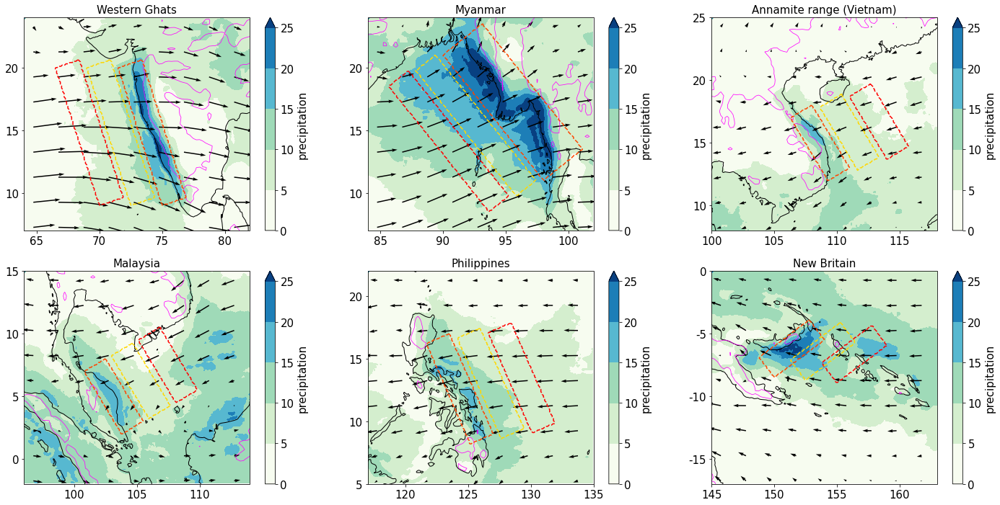

In [105]:
fig,axs = plt.subplots(2,3,figsize=(20,10),subplot_kw={'projection':ccrs.PlateCarree()})
axs=axs.reshape(-1)
for i,MR in enumerate(MRs):
    ax=axs[i]
    ax.set_anchor('W')
    ax.coastlines()
    
    box=MR.box
    pr=sel_months(sel_box(gpm_pr_seasmean,box),MR.months).mean('month')
    pr[0,0]=26.
    pr.plot.contourf(ax=ax,transform=ccrs.PlateCarree(),levels=np.arange(0.,26.,5.),cmap=plt.cm.GnBu)#,cbar_kwargs={'shrink':0.8,'label':'mm/day'})

    sel_box(orogm,box).plot.contour(ax=ax,transform=ccrs.PlateCarree(),levels=[500.],linewidths=[0.75],colors=['magenta'])
    tilted_rect(pr,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['orangered'])

    #tilted_rect_distance(pr,*MR.box_tilted[:-1],-3,-5).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['red'])
    tilted_rect_angledistance(pr,*MR.box_tilted[:-1],2,MR.angleL,-5).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['red'])
    tilted_rect_angledistance(pr,*MR.box_tilted[:-1],2,MR.angleL,-2.5).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['gold'])

    u=MR.vars['UL_DAILY'].mean('time')
    v=MR.vars['VL_DAILY'].mean('time')
    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = u.longitude.expand_dims({"latitude":u.latitude})
    n=len(u.latitude)//8
    m=n
    ibeg=3
    iend=-1
    Q=ax.quiver(np.array(Y)[ibeg:iend:n,ibeg:iend:n],np.array(X)[ibeg:iend:n,ibeg:iend:n], np.array(u)[ibeg:iend:n,ibeg:iend:n], np.array(v)[ibeg:iend:n,ibeg:iend:n],color="k",transform=ccrs.PlateCarree(),scale=100,scale_units='height',width=1.5,units='dots')
    
    
    dl=5
    lons=range(dl*(1+(int(box[0])-1)//dl),dl*(int(box[1])//dl)+1,dl)
    ax.set_xticks(lons)
    ax.set_xticklabels(lons)
    lats=range(dl*(1+(int(box[2])-1)//dl),dl*(int(box[3])//dl)+1,dl)
    ax.set_yticks(lats)
    ax.set_yticklabels(lats)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_title(MR.Lname,fontsize=15)

fig.tight_layout()

# Daily data

## Scatterplots

In [10]:
from scipy.optimize import curve_fit
def fit(pred,dep,model='linear'):
    predrange = np.linspace(np.min(pred),np.max(pred),41)
    if model=='linear':
        func = lambda x,a,b : a*x+b
    elif model=='exponential':
        func = lambda x,a,b : np.exp(a*x+b)
    elif model=='softplus':
        func = lambda x,a,b : np.log(1+np.exp(a*x+b))
    popt,_ = curve_fit(func,pred,dep)
    fitrange = func(predrange,*popt)
    residual = dep - func(pred,*popt)
    rss = np.sum(residual**2)
    tss = len(dep)*np.var(dep)
    rsq = 1-rss/tss
    return predrange,fitrange,rsq

CPU times: user 2.81 s, sys: 338 ms, total: 3.15 s
Wall time: 3.21 s


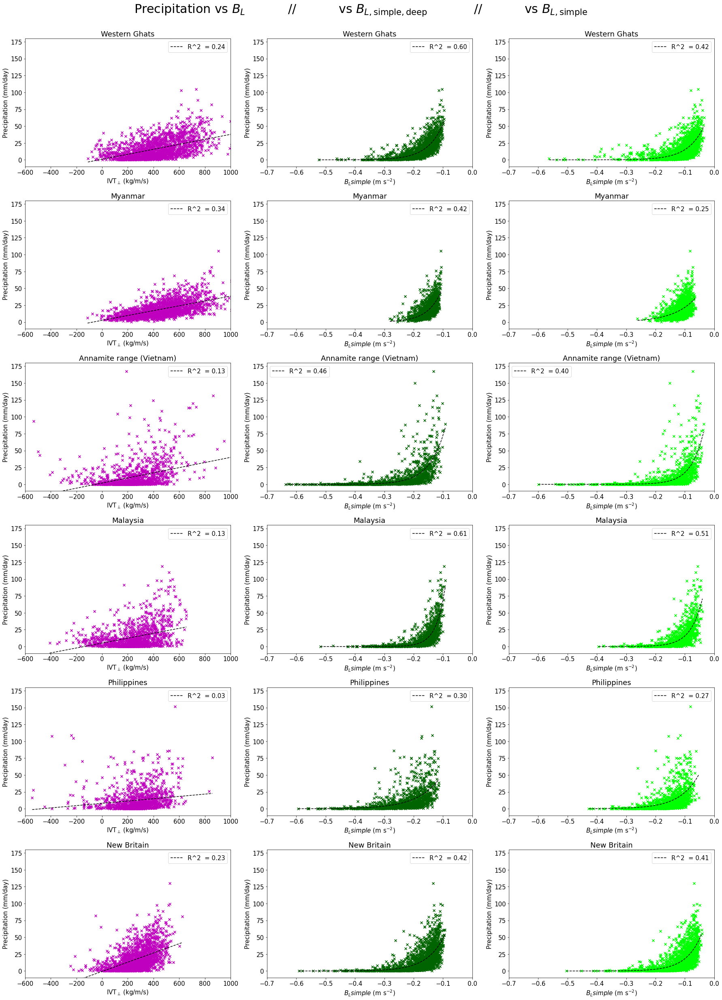

In [15]:
%%time
fig,axs = plt.subplots(6,3,figsize=(25,35))
for j,MR in enumerate(MRs):
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    viwvperp = MR.vars['VIWV_PERP_UPSTREAM_DAILY']
    Blsimple = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Blsimpledeep = MR.vars['BLDEEPSIMPLE_ABOVE_DAILY']
    
    for i,(pred,c,model) in enumerate(zip((viwvperp,Blsimpledeep,Blsimple),('m','darkgreen','lime'),('linear','exponential','exponential'))):
        axs[j,i].scatter(pred,pr,marker='x',color=c)
        x,y,rsq = fit(pred,pr,model)
        axs[j,i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
        axs[j,i].set_ylabel("Precipitation (mm/day)")
        axs[j,i].set_title(MR.Lname)
        axs[j,i].legend()
        axs[j,i].set_ylim(-10,180)
    axs[j,0].set_xlabel(r"IVT$_\perp$ (kg/m/s)")
    axs[j,1].set_xlabel(r"$B_Lsimple$ (m s$^{-2}$)")
    axs[j,2].set_xlabel(r"$B_Lsimple$ (m s$^{-2}$)")
    axs[j,0].set_xlim(-600,1000)
    axs[j,1].set_xlim(-0.7,0)
    axs[j,2].set_xlim(-0.7,0)

       
fig.suptitle(r"Precipitation vs $B_L$           //           vs $B_{L,\mathrm{simple,deep}}$            //           vs $B_{L,\mathrm{simple}}$",fontsize=30)
fig.tight_layout(rect=[0, 0, 1, 0.98])

In [24]:
def fit_coefs(pred,dep,model='linear'):
    predrange = np.linspace(np.min(pred),np.max(pred),41)
    if model=='linear':
        func = lambda x,a,b : a*x+b
    elif model=='exponential':
        func = lambda x,a,b : np.exp(a*x+b)
    elif model=='softplus':
        func = lambda x,a,b : np.log(1+np.exp(a*x+b))
    popt,_ = curve_fit(func,pred,dep)
    fitrange = func(predrange,*popt)
    residual = dep - func(pred,*popt)
    rss = np.sum(residual**2)
    tss = len(dep)*np.var(dep)
    rsq = 1-rss/tss
    return predrange,fitrange,rsq,popt

def rsq_fixedcoefs(pred,dep,popt,model='linear'):
    if model=='linear':
        func = lambda x,a,b : a*x+b
    elif model=='exponential':
        func = lambda x,a,b : np.exp(a*x+b)
    elif model=='softplus':
        func = lambda x,a,b : np.log(1+np.exp(a*x+b))
    residual = dep - func(pred,*popt)
    rss = np.sum(residual**2)
    tss = len(dep)*np.var(dep)
    rsq = 1-rss/tss
    return rsq

ghats [18.30776066  4.54696637]
myanmar [13.5034727   4.43870654]
vietnam [23.39890166  5.19381902]
malaysia [25.13671175  5.2752291 ]
philippines [15.47868446  4.73826774]
newbritain [19.27149316  4.83070743]
CPU times: user 305 ms, sys: 4.21 ms, total: 309 ms
Wall time: 305 ms


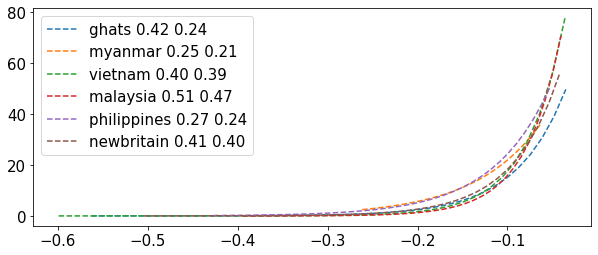

In [27]:
%%time
fig,ax = plt.subplots(1,1,figsize=(10,4))
for j,MR in enumerate(MRs):
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Blsimple = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Blsimpledeep = MR.vars['BLDEEPSIMPLE_ABOVE_DAILY']
    
    pred = Blsimple
    x,y,rsq,popt = fit_coefs(pred,pr,'exponential')
    
    rsq2 = rsq_fixedcoefs(pred,pr,[18.,4.8],model='exponential')
    
    ax.plot(x,y,linestyle='--',label=MR.name+ " %.2f"%rsq+ " %.2f"%rsq2)
    print(MR.name, popt)
    
ax.legend()

In [28]:
BL_exp_fit = lambda bl : np.exp(18*bl+4.8)

CPU times: user 291 ms, sys: 2.72 ms, total: 294 ms
Wall time: 292 ms


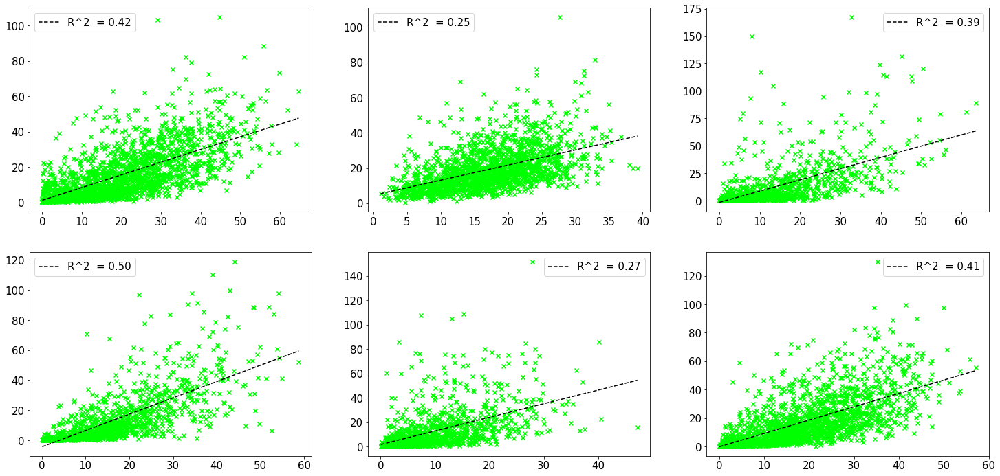

In [32]:
%%time
fig,axs = plt.subplots(2,3,figsize=(25,12))
axs=axs.reshape(-1)
for j,MR in enumerate(MRs):
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Blsimple = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Blsimpledeep = MR.vars['BLDEEPSIMPLE_ABOVE_DAILY']
    
    pred = Blsimple
    c='lime'
    
    axs[j].scatter(BL_exp_fit(pred),pr,marker='x',color=c)
    x,y,rsq = fit(BL_exp_fit(pred),pr,'linear')
    axs[j].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    axs[j].legend()

    


## Binned

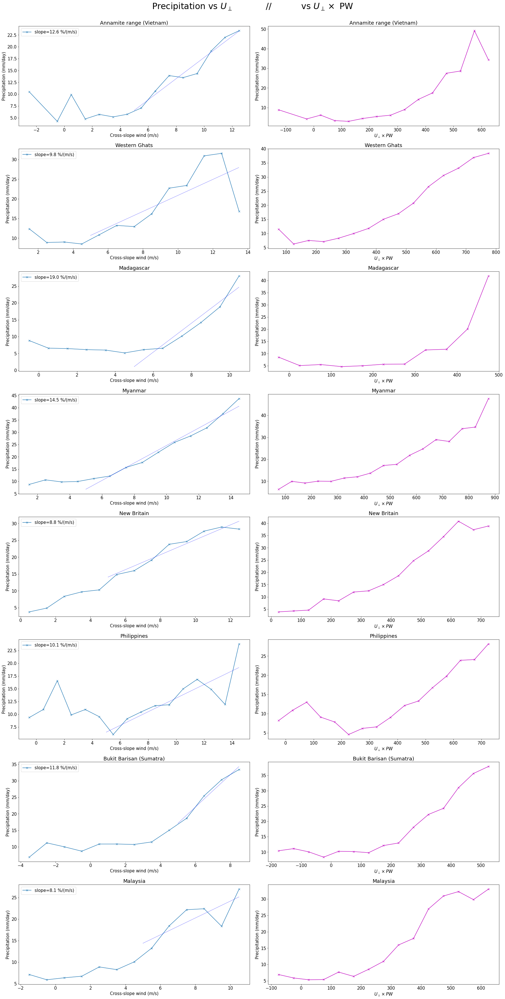

In [140]:
fig,ax = plt.subplots(8,2,figsize=(25,50))
ubins = np.arange(-10,20,1)
upwbins = np.arange(-500,1000,50)
for j,MR in enumerate(MRs):
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    PW = MR.vars['TCWV_UPSTREAM_DAILY']

    with warnings.catch_warnings():
        warnings.simplefilter("ignore",RuntimeWarning)
        bin_centers,bin_means = get_binned(crossslopeu,pr,ubins)
        #Filter bins so that at least 10 days are included
        _,bin_counts = get_count(crossslopeu,ubins)   
        idx = bin_counts>=10
        bin_centers=bin_centers[idx]
        bin_means=bin_means[idx]
        reg = linregress(bin_centers[bin_centers>5],bin_means[bin_centers>5])
    ax[j,0].plot(bin_centers,bin_means,'-x',label=r'slope=%.1f %%/(m/s)'%( 100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1) ))
    uu = np.linspace(5,max(bin_centers),10)
    ax[j,0].plot(uu,reg.intercept+uu*reg.slope,color='b',linestyle='--',linewidth=0.75)  
    
    ax[j,0].set_xlabel("Cross-slope wind (m/s)")
    ax[j,0].set_ylabel("Precipitation (mm/day)")
    ax[j,0].legend()
    ax[j,0].set_title(MR.Lname)
    
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore",RuntimeWarning)
        bin_centers,bin_means = get_binned(crossslopeu*PW,pr,upwbins)
        #Filter bins so that at least 10 days are included
        _,bin_counts = get_count(crossslopeu*PW,upwbins)   
        idx = bin_counts>=10
        bin_centers=bin_centers[idx]
        bin_means=bin_means[idx]
    ax[j,1].plot(bin_centers,bin_means,'-x',color='m')
    ax[j,1].set_xlabel(r"$U_\perp \times PW$")
    ax[j,1].set_ylabel("Precipitation (mm/day)")
    ax[j,1].set_title(MR.Lname)
       
fig.suptitle(r"Precipitation vs $U_\perp$            //           vs $U_\perp \times$ PW",fontsize=30)
fig.tight_layout(rect=[0, 0, 1, 0.98])

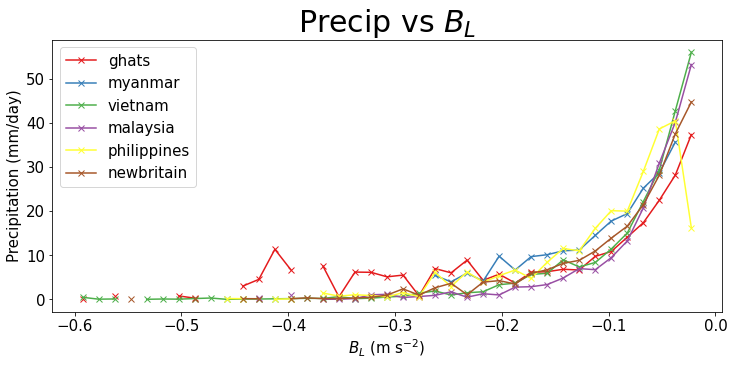

In [24]:
fig,ax = plt.subplots(1,1,figsize=(12,5))
colors=plt.cm.Set1(np.linspace(0,1,8))
Blbins = np.arange(-0.6,0,1.5e-2)
for j,MR in enumerate(MRs):
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Bl = MR.vars['BL_ABOVE_DAILY']
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore",RuntimeWarning)
        bin_centers,bin_means = get_binned(Bl,pr,Blbins)
    ax.plot(bin_centers,bin_means,'-x',color=colors[j],label=MR.name)
            
ax.set_xlabel(r"$B_L$ (m s$^{-2}$)")
ax.set_ylabel("Precipitation (mm/day)")
ax.set_title(r"Precip vs $B_L$",fontsize=30)
ax.legend()

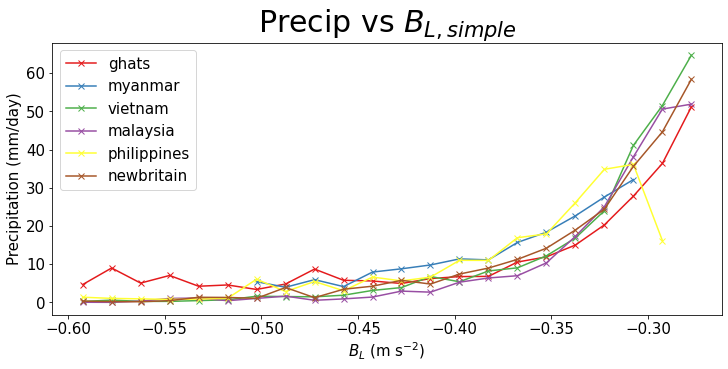

In [26]:
fig,ax = plt.subplots(1,1,figsize=(12,5))
colors=plt.cm.Set1(np.linspace(0,1,8))
Blbins = np.arange(-0.6,0,1.5e-2)
for j,MR in enumerate(MRs):
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Bl = MR.vars['BLSIMPLE_ABOVE_DAILY']
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore",RuntimeWarning)
        bin_centers,bin_means = get_binned(Bl,pr,Blbins)
    ax.plot(bin_centers,bin_means,'-x',color=colors[j],label=MR.name)
            
ax.set_xlabel(r"$B_L$ (m s$^{-2}$)")
ax.set_ylabel("Precipitation (mm/day)")
ax.set_title(r"Precip vs $B_{L,simple}$",fontsize=30)
ax.legend()

## Separated by Bl

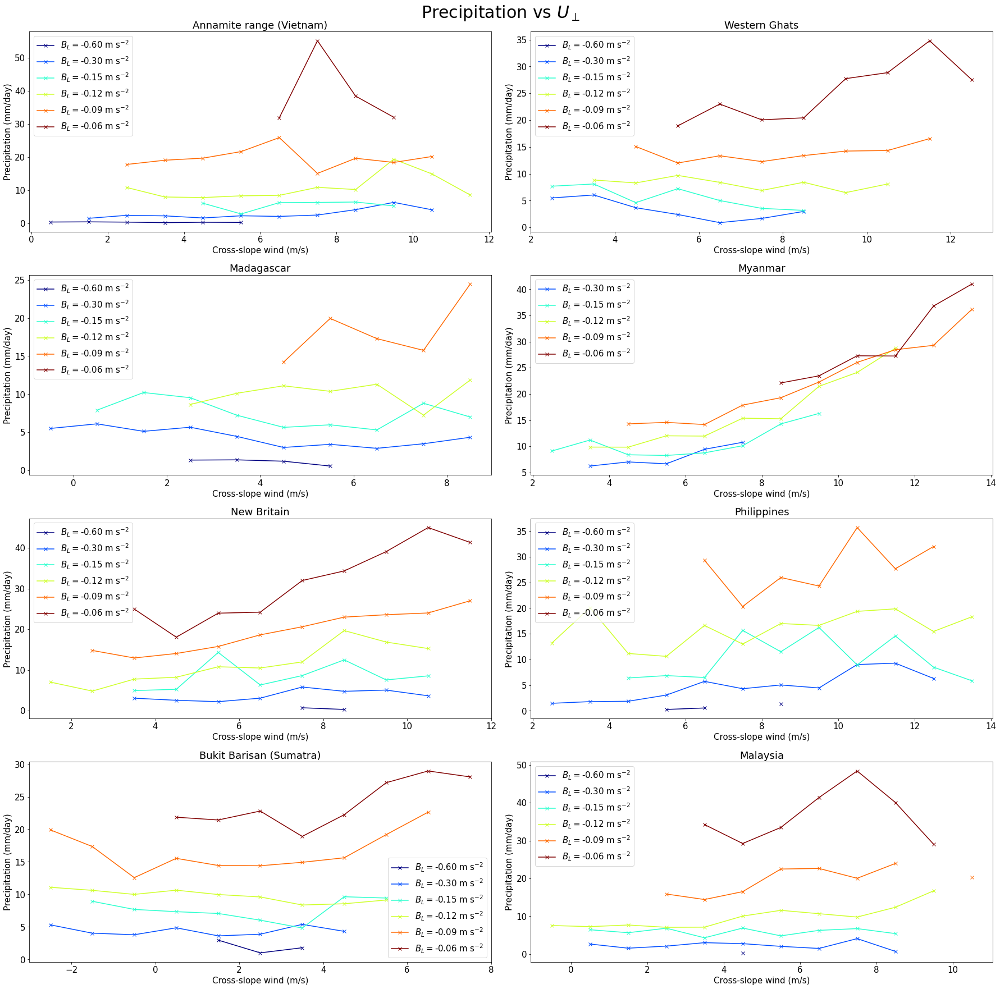

In [14]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    sep_measure = MR.vars['BL_ABOVE_DAILY']
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    
    sep_bins = 3*np.array([-0.2,-0.1,-0.05,-0.04,-0.03,-0.02,-0.01])
    colors=plt.cm.jet(np.linspace(0,1,len(sep_bins)-1))
    
    for i,s in enumerate(sep_bins[:-1]):
        condition=(sep_measure>=s) & (sep_measure<sep_bins[i+1])#& (pr>2.)
        us  = crossslopeu.where(condition,drop=True)
        prs = pr.where(condition,drop=True)
        if len(us)!=0:
            with warnings.catch_warnings():
                warnings.simplefilter("ignore",RuntimeWarning)
                bin_centers,bin_means = get_binned(us,prs,ubins)
                _,bin_counts = get_count(us,ubins)
            bin_means[bin_counts<10]=np.nan
            ax[j].plot(bin_centers,bin_means,'-x',color=colors[i],label=r'$B_L=$%.2f m s$^{-2}$'%s)#,label=r'slope=%.1f %%/(m/s)'%( 100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1) ))
            #uu = np.linspace(5,max(bin_centers),10)
            #ax[j].plot(uu,reg.intercept+uu*reg.slope,color='b',linestyle='--',linewidth=0.75)  
    
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel("Precipitation (mm/day)")
    ax[j].legend()
    ax[j].set_title(MR.Lname)
fig.suptitle(r"Precipitation vs $U_\perp$",fontsize=30)
fig.tight_layout()

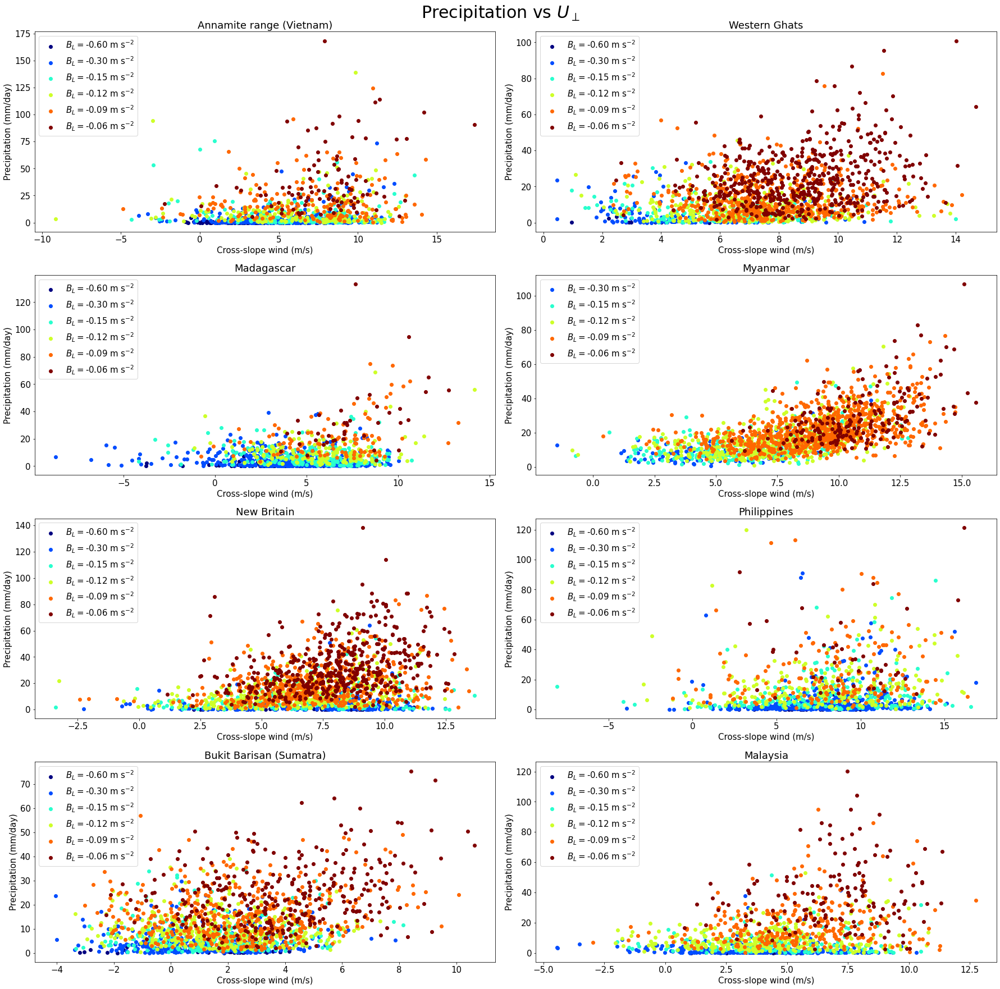

In [15]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    sep_measure = MR.vars['BL_ABOVE_DAILY']
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    
    sep_bins = 3*np.array([-0.2,-0.1,-0.05,-0.04,-0.03,-0.02,-0.01])
    colors=plt.cm.jet(np.linspace(0,1,len(sep_bins)-1))
    
    for i,s in enumerate(sep_bins[:-1]):
        condition=(sep_measure>=s) & (sep_measure<sep_bins[i+1])#& (pr>2.)
        us  = crossslopeu.where(condition,drop=True)
        prs = pr.where(condition,drop=True)
        if len(us)!=0:
            ax[j].scatter(us,prs,color=colors[i],label=r'$B_L=$%.2f m s$^{-2}$'%s)#,label=r'slope=%.1f %%/(m/s)'%( 100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1) ))
            #uu = np.linspace(5,max(bin_centers),10)
            #ax[j].plot(uu,reg.intercept+uu*reg.slope,color='b',linestyle='--',linewidth=0.75)  
    
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel("Precipitation (mm/day)")
    ax[j].legend()
    ax[j].set_title(MR.Lname)
fig.suptitle(r"Precipitation vs $U_\perp$",fontsize=30)
fig.tight_layout()

## Separated by PW, $q_L$, $q_{surf}$

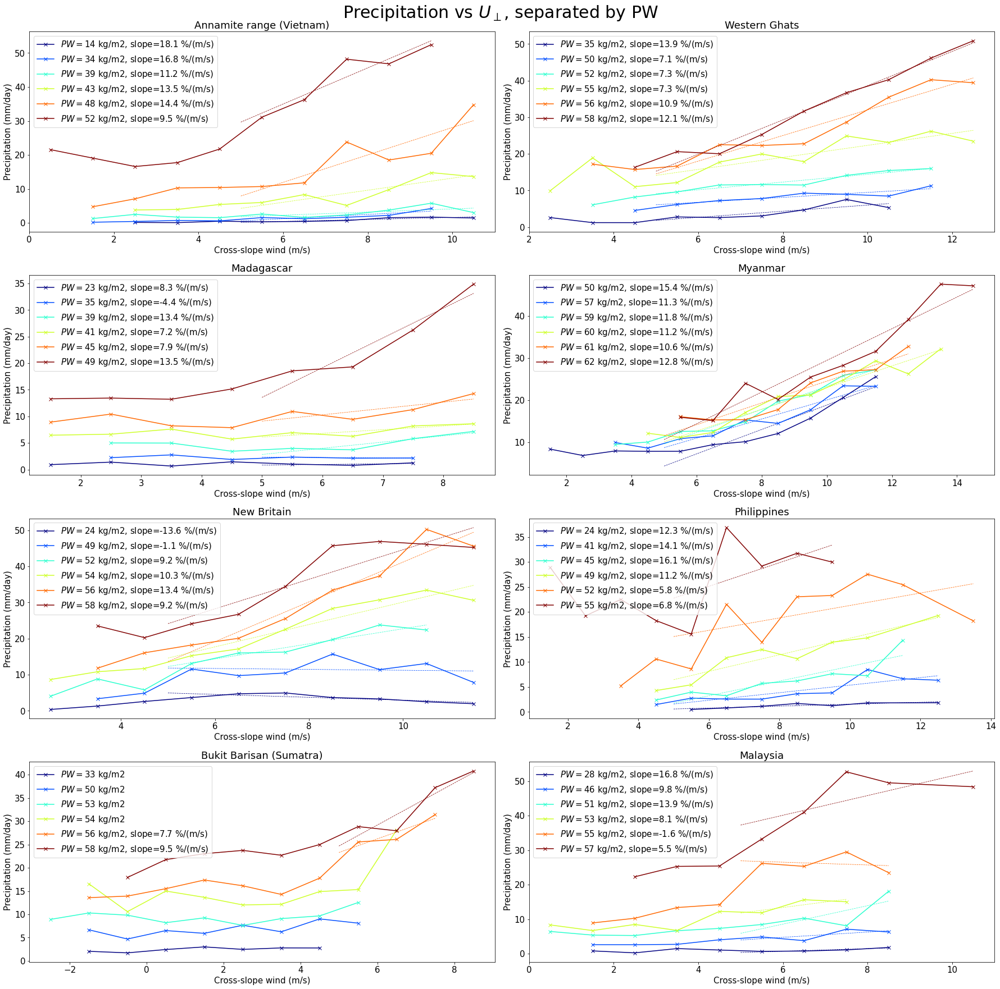

In [131]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    sep_measure = MR.vars['TCWV_UPSTREAM_DAILY']
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    
    #sep_bins = [0.008,0.012,0.014,0.016,0.017,0.018,0.019,0.02]
    sep_bins=get_bins(sep_measure,6)
    colors=plt.cm.jet(np.linspace(0,1,len(sep_bins)-1))
    
    for i,s in enumerate(sep_bins[:-1]):
        condition=(sep_measure>=s) & (sep_measure<sep_bins[i+1])#& (pr>2.)
        us  = crossslopeu.where(condition,drop=True)
        prs = pr.where(condition,drop=True)
        if len(us)!=0:
            with warnings.catch_warnings():
                warnings.simplefilter("ignore",RuntimeWarning)
                bin_centers,bin_means = get_binned(us,prs,ubins)
                #Filter bins so that at least 10 days are included
                _,bin_counts = get_count(us,ubins)   
                idx = bin_counts>=10
                bin_centers=bin_centers[idx]
                bin_means=bin_means[idx]

            if (bin_centers>5).sum()>=3:
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore",RuntimeWarning)
                    reg = linregress(bin_centers[(bin_centers>5)],bin_means[(bin_centers>5)])
                    uu = np.linspace(5,max(bin_centers),10)
                    ax[j].plot(uu,reg.intercept+uu*reg.slope,color=colors[i],linestyle='--',linewidth=0.75)  
                    ax[j].plot(bin_centers,bin_means,'-x',color=colors[i],label=r'$PW=$%i kg/m2, slope=%.1f %%/(m/s)'%(s, 100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1) ))
            else:
                ax[j].plot(bin_centers,bin_means,'-x',color=colors[i],label=r'$PW=$%i kg/m2'%s)
            
    
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel("Precipitation (mm/day)")
    ax[j].legend()
    ax[j].set_title(MR.Lname)
fig.suptitle(r"Precipitation vs $U_\perp$, separated by PW",fontsize=30)
fig.tight_layout()

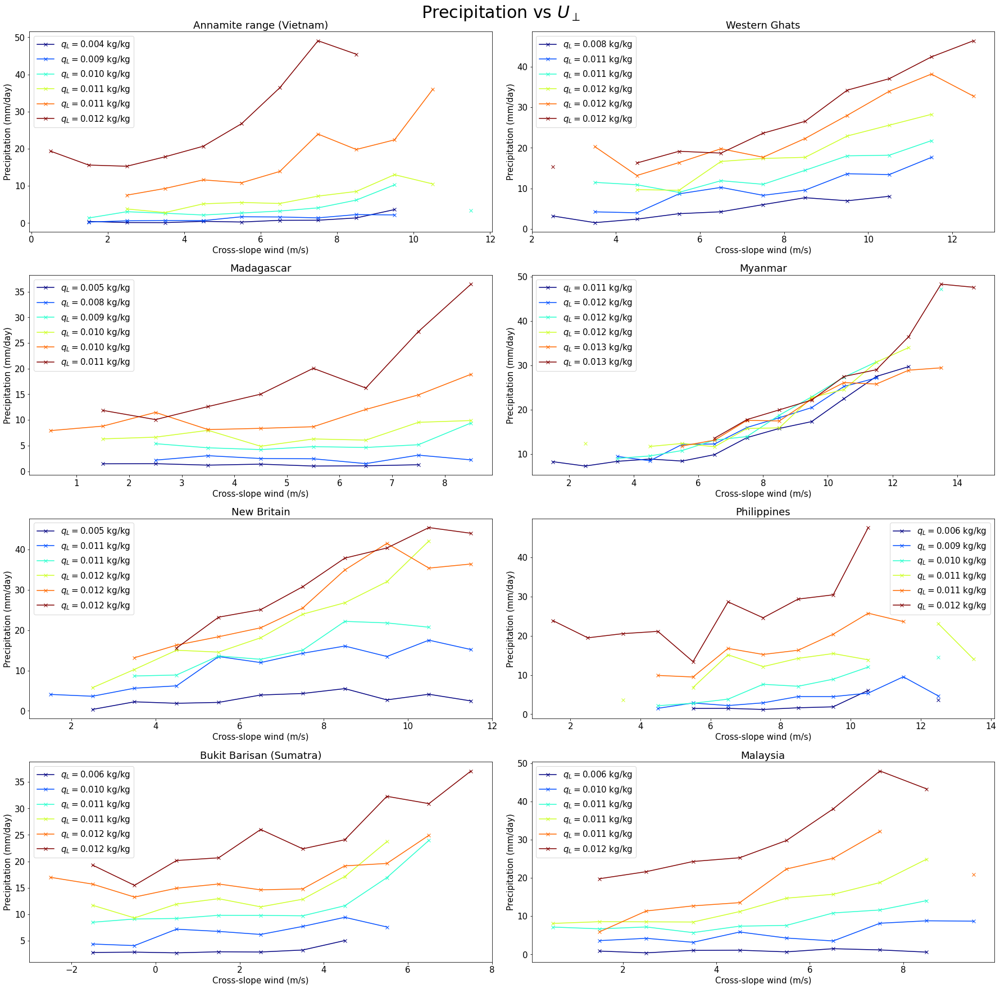

In [116]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    sep_measure = MR.vars['Q_ABOVE_DAILY'].sel(level=slice(700,900)).mean('level')
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    
    #sep_bins = [0.008,0.012,0.014,0.016,0.017,0.018,0.019,0.02]
    sep_bins=get_bins(sep_measure,6)
    colors=plt.cm.jet(np.linspace(0,1,len(sep_bins)-1))
    
    for i,s in enumerate(sep_bins[:-1]):
        condition=(sep_measure>=s) & (sep_measure<sep_bins[i+1])#& (pr>2.)
        us  = crossslopeu.where(condition,drop=True)
        prs = pr.where(condition,drop=True)
        if len(us)!=0:
            with warnings.catch_warnings():
                warnings.simplefilter("ignore",RuntimeWarning)
                bin_centers,bin_means = get_binned(us,prs,ubins)
                _,bin_counts = get_count(us,ubins)
            bin_means[bin_counts<10]=np.nan
            ax[j].plot(bin_centers,bin_means,'-x',color=colors[i],label=r'$q_L=$%.3f kg/kg'%s)#,label=r'slope=%.1f %%/(m/s)'%( 100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1) ))
            #uu = np.linspace(5,max(bin_centers),10)
            #ax[j].plot(uu,reg.intercept+uu*reg.slope,color='b',linestyle='--',linewidth=0.75)  
    
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel("Precipitation (mm/day)")
    ax[j].legend()
    ax[j].set_title(MR.Lname)
fig.suptitle(r"Precipitation vs $U_\perp$, separated by $q_L$",fontsize=30)
fig.tight_layout()

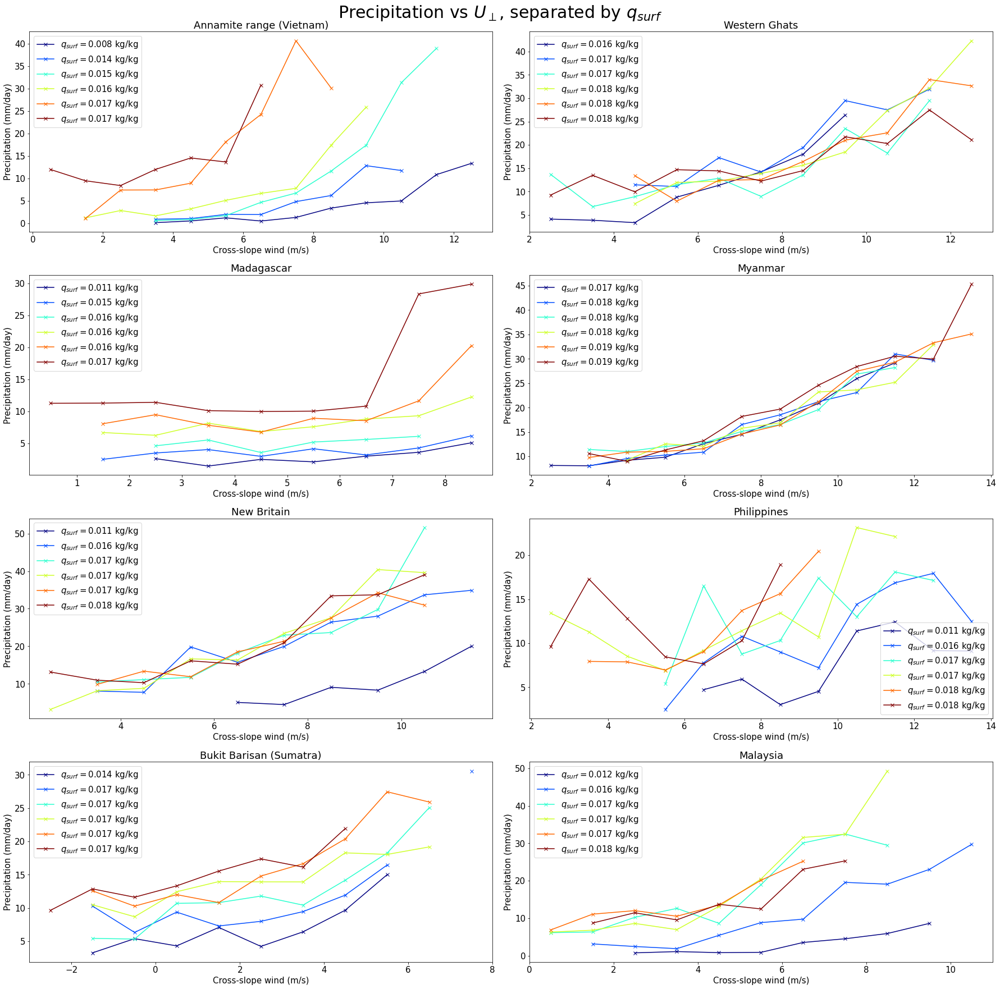

In [118]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    sep_measure = MR.vars['Q_ABOVE_DAILY'].sel(level=1000.)
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    
    #sep_bins = [0.008,0.012,0.014,0.016,0.017,0.018,0.019,0.02]
    sep_bins=get_bins(sep_measure,6)
    colors=plt.cm.jet(np.linspace(0,1,len(sep_bins)-1))
    
    for i,s in enumerate(sep_bins[:-1]):
        condition=(sep_measure>=s) & (sep_measure<sep_bins[i+1])#& (pr>2.)
        us  = crossslopeu.where(condition,drop=True)
        prs = pr.where(condition,drop=True)
        if len(us)!=0:
            with warnings.catch_warnings():
                warnings.simplefilter("ignore",RuntimeWarning)
                bin_centers,bin_means = get_binned(us,prs,ubins)
                _,bin_counts = get_count(us,ubins)
            bin_means[bin_counts<10]=np.nan
            ax[j].plot(bin_centers,bin_means,'-x',color=colors[i],label=r'$q_{surf}=$%.3f kg/kg'%s)#,label=r'slope=%.1f %%/(m/s)'%( 100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1) ))
            #uu = np.linspace(5,max(bin_centers),10)
            #ax[j].plot(uu,reg.intercept+uu*reg.slope,color='b',linestyle='--',linewidth=0.75)  
    
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel("Precipitation (mm/day)")
    ax[j].legend()
    ax[j].set_title(MR.Lname)
fig.suptitle(r"Precipitation vs $U_\perp$, separated by $q_{surf}$",fontsize=30)
fig.tight_layout()

## U vs $B_L-B_{L,upstream}$

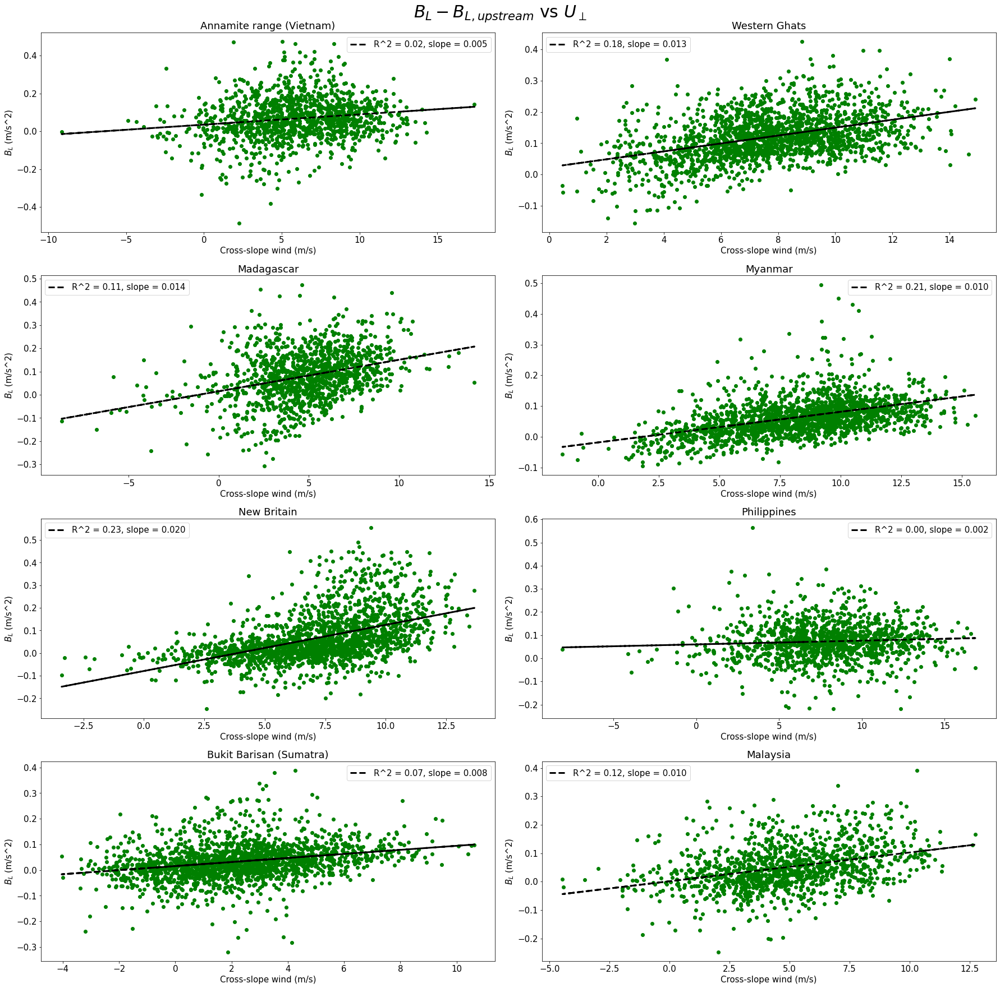

In [17]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    Bl_above = MR.vars['BL_ABOVE_DAILY']
    Bl_rce = MR.vars['BL_RCE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    

    ax[j].scatter(crossslopeu,Bl_above-Bl_rce,color='g')
    reg = linregress(crossslopeu,Bl_above-Bl_rce)
    ax[j].plot(crossslopeu,reg.intercept+reg.slope*crossslopeu,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.3f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel(r"$B_L$ (m/s^2)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$B_L-B_{L,upstream}$ vs $U_\perp$",fontsize=30)
fig.tight_layout()

Estimating the slope of the $B_L$ - $U$ relationship.
Linearizing about a background state and neglecting the $\theta_{eb}$ dependence, one writes
$$B_L' = \dfrac{\partial B_L}{\partial q_L} q_L' + \dfrac{\partial B_L}{\partial T_L} T_L'$$
$\dfrac{\partial B_L}{\partial q_L}$ and $\dfrac{\partial B_L}{\partial T_L}$ are estimated from the Ahmed et al 2021 paper. For $q_L'$ and $T_L'$, we write 
$$q_L' \simeq -\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \eta_L, ~~~T_L' \simeq -\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \eta_L$$
where $\eta_L$ is the orographically-forced displacement averaged over the lower troposphere. Hence 
$$\dfrac{\partial B_L}{\partial U} = -\dfrac{\partial \eta_L}{\partial U}\left(\dfrac{\partial B_L}{\partial q_L}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} + \dfrac{\partial B_L}{\partial T_L}\dfrac{\mathrm{d} s_0}{\mathrm{d} z}\right) $$

Simulation (and linear theory at winds $>12$ m/s) indicate $\dfrac{\partial \eta_L}{\partial U} \simeq 30$ m/(m/s)

In [30]:
from orographicConvectionTheory.orographicConvectionTheory import k_vector,m_exponent,topographic_profile
def linear_etaL(U,N=0.012):
    xx,hx = topographic_profile('cos',a=100e3,A=1000)
    z=np.arange(0,10000,100)
    k=k_vector(len(xx),xx[1]-xx[0])
    zbot=1000
    ztop=3000
    z_slice = z[np.where((z>=zbot) & (z<=ztop))]
    etahat = np.fft.fft(hx)*np.exp( m_exponent(k[:,None],N,U)  *  z_slice[None,:]).mean(axis=1)
    return np.max(np.real(np.fft.ifft(etahat)))

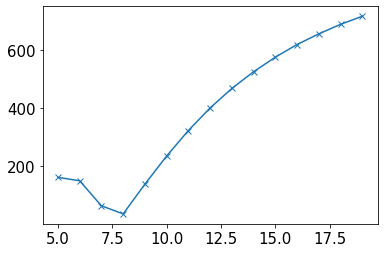

In [34]:
us = range(5,20)
etas = [linear_etaL(u) for u in us]
plt.plot(us,etas,'-x')

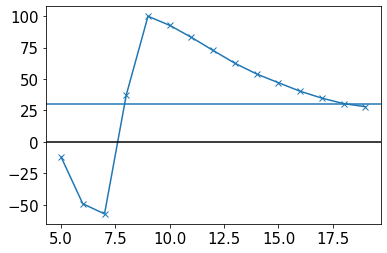

In [42]:
us = range(5,20)
etas = [linear_etaL(u) for u in us]
plt.plot(us,np.gradient(etas,us),'-x')
plt.axhline(30)
plt.axhline(0,color='k')

In [18]:
# Evaluating slopes theoretically
alpha = 20.6/3600*2.5e6
dBLdqL = 1/(11.3*3600)*1004*8000/alpha
dBLdTL = -1/(2.7*3600)*1004*8000/alpha
# For a 500m mountain
dqdz = -8e-3 # K/m
dsdz = 4e-3  # K/m
BLovU = -30*(dBLdqL*dqdz+dBLdTL*dsdz)
BLovU


0.010244056858645741

In [19]:
Newbritain.set_3dvar('PHI',"128_129_z")
sample_geopotential = Newbritain.vars['PHI'].mean(['latitude','longitude'])/9.81
dzdp = sample_geopotential.differentiate('level')

In [ ]:
Vietnam       .mtnheight = 750.
Ghats     .mtnheight = 750.
Madagascar    .mtnheight = 1000.
Myanmar   .mtnheight = 1000.
Newbritain.mtnheight = 500.
Philippines   .mtnheight = 250.
Sumatra       .mtnheight = 500.
Malaysia      .mtnheight = 250.

for MR in MRs:
    dqdp = sel_box(MR.vars['Q'],MR.box_rce).mean(['latitude','longitude']).differentiate('level')
    dqdz_K = 2.5e6/1004. * dqdp/dzdp
    dqdz_K=float(dqdz_K.sel(level=slice(700,900)).mean('level'))
    
    dTdp = sel_box(MR.vars['T'],MR.box_rce).mean(['latitude','longitude']).differentiate('level')
    dsdz = dTdp/dzdp + 9.81/1004.
    dsdz=float(dsdz.sel(level=slice(700,900)).mean('level'))
    
    BLovU = -30*(dBLdqL*dqdz_K+dBLdTL*dsdz) # if 500m mtn
    BLovU *= MR.mtnheight/500. #correct for mtn height
    print("{:<14}: BL - U slope = {:.4f} m/s2 / (m/s) - dqdz = {:.2e} - dsdz = {:.2e}".format(MR.name,BLovU,dqdz_K,float((dTdp/dzdp).sel(level=slice(700,900)).mean('level'))))
    
    

vietnam       : BL - U slope = 0.0188 m/s2 / (m/s) - dqdz = -8.33e-03 - dsdz = -4.54e-03
ghatswide     : BL - U slope = 0.0180 m/s2 / (m/s) - dqdz = -9.60e-03 - dsdz = -5.15e-03
madagascar    : BL - U slope = 0.0259 m/s2 / (m/s) - dqdz = -9.44e-03 - dsdz = -4.56e-03
myanmarwide   : BL - U slope = 0.0227 m/s2 / (m/s) - dqdz = -8.61e-03 - dsdz = -5.28e-03
newbritainwide: BL - U slope = 0.0123 m/s2 / (m/s) - dqdz = -8.17e-03 - dsdz = -4.62e-03
philippines   : BL - U slope = 0.0066 m/s2 / (m/s) - dqdz = -8.73e-03 - dsdz = -4.28e-03
sumatra       : BL - U slope = 0.0112 m/s2 / (m/s) - dqdz = -7.37e-03 - dsdz = -5.07e-03
malaysia      : BL - U slope = 0.0056 m/s2 / (m/s) - dqdz = -7.41e-03 - dsdz = -5.06e-03


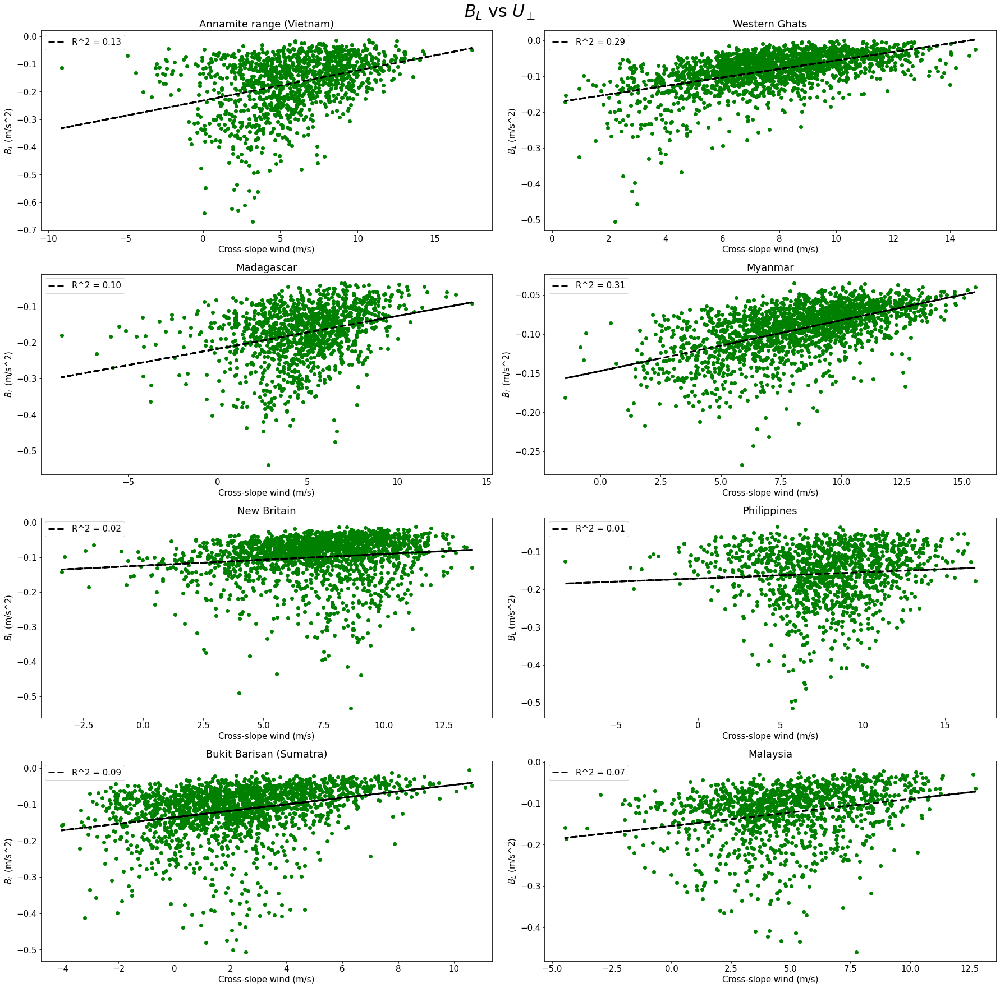

In [21]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    Bl_above = MR.vars['BL_ABOVE_DAILY']
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']

    ax[j].scatter(crossslopeu,Bl_above,color='g')
    reg = linregress(crossslopeu,Bl_above)
    ax[j].plot(crossslopeu,reg.intercept+reg.slope*crossslopeu,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f'%(reg.rvalue**2))
    
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel(r"$B_L$ (m/s^2)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$B_L$ vs $U_\perp$",fontsize=30)
fig.tight_layout()

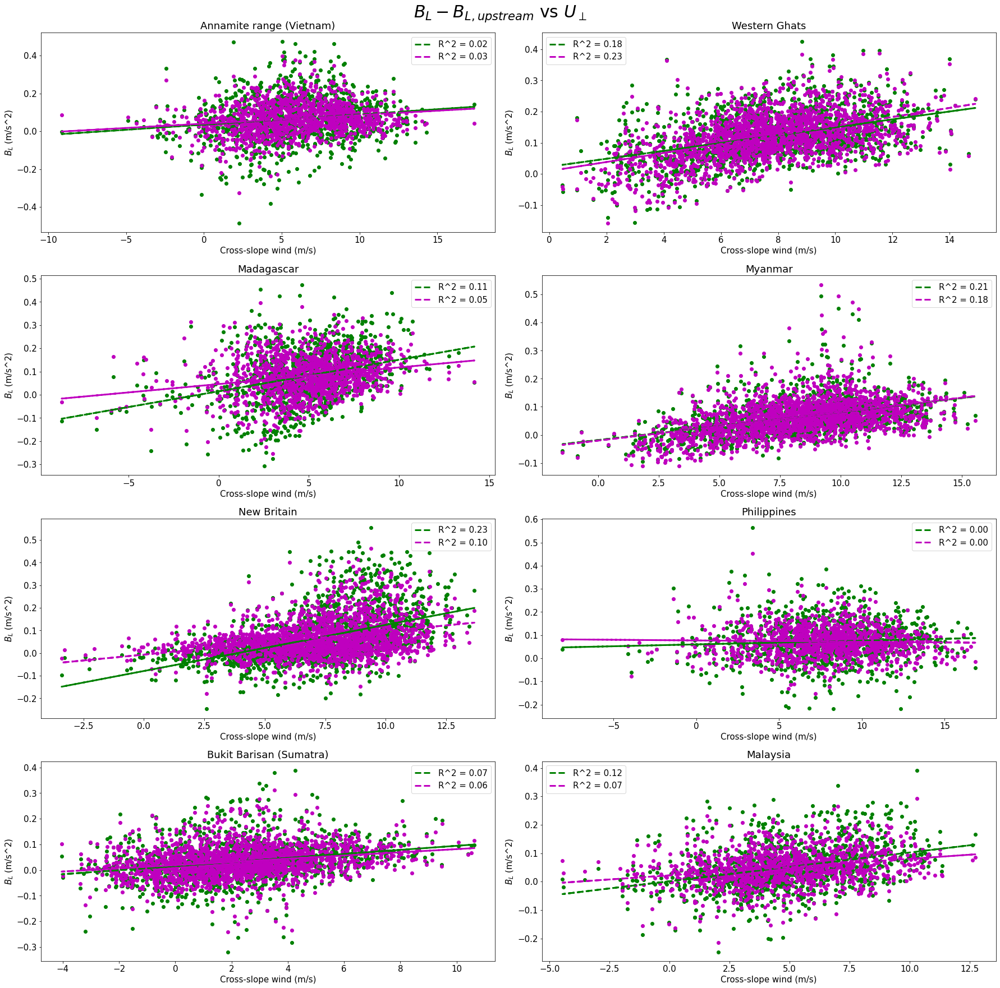

In [22]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    Bl_above = MR.vars['BL_ABOVE_DAILY']
    Bl_rce = MR.vars['BL_RCE_DAILY']
    Bl_lft_above = MR.vars['BL_LFT_ABOVE_DAILY']
    Bl_lft_rce = MR.vars['BL_LFT_RCE_DAILY']
    
    crossslopeu = MR.vars['VAR_100U_PERP_UPSTREAM_DAILY']
    

    ax[j].scatter(crossslopeu,Bl_above-Bl_rce,color='g')
    ax[j].scatter(crossslopeu,Bl_lft_above-Bl_lft_rce,color='m')
    reg = linregress(crossslopeu,Bl_above-Bl_rce)
    ax[j].plot(crossslopeu,reg.intercept+reg.slope*crossslopeu,color='g',linewidth=3,linestyle='--',label = 'R^2 = %.2f'%(reg.rvalue**2))
    reg = linregress(crossslopeu,Bl_lft_above-Bl_lft_rce)
    ax[j].plot(crossslopeu,reg.intercept+reg.slope*crossslopeu,color='m',linewidth=3,linestyle='--',label = 'R^2 = %.2f'%(reg.rvalue**2))
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel(r"$B_L$ (m/s^2)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$B_L-B_{L,upstream}$ vs $U_\perp$",fontsize=30)
fig.tight_layout()

Text(0.5, 1.0, 'Standard deviations in daily $B_L$')

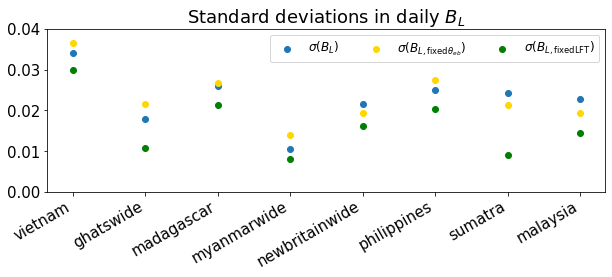

In [44]:
_,ax=plt.subplots(1,1,figsize=(10,3))
names = [MR.name for MR in MRs]
ax.scatter([MR.name for MR in MRs],[float(np.std(MR.vars['BL_ABOVE_DAILY'])) for MR in MRs],label=r"$\sigma(B_L)$")
ax.scatter([MR.name for MR in MRs],[float(np.std(MR.vars['BL_LFT_ABOVE_DAILY'])) for MR in MRs],color='gold',label=r"$\sigma(B_{L,\mathrm{fixed } \theta_{eb}})$")
ax.scatter([MR.name for MR in MRs],[float(np.std(MR.vars['BL_BLAYER_ABOVE_DAILY'])) for MR in MRs],color='g',label=r"$\sigma(B_{L,\mathrm{fixed LFT}})$")
plt.xticks(rotation=30, ha='right')
ax.set_ylim(0,0.04)
ax.legend(ncol=3,fontsize=12)
ax.set_title("Standard deviations in daily $B_L$")

## Wind variations

In [38]:
for MR in MRs:
    for varname in 'VAR_100U','VAR_100V','VAR_100U_PARA':
        grid = MR.vars['VAR_100U_DAILY']
        MR.set_spatialmean(varname,'interval',tilted_rect_distance(grid,*MR.box_tilted[:-1],0,-3),box=None)
        MR.set_spatialmean(varname,'closeinterval',tilted_rect_distance(grid,*MR.box_tilted[:-1],0,-1),box=None)

ghats 70
myanmar 66
vietnam 72
malaysia 69
philippines 73
newbritain 69


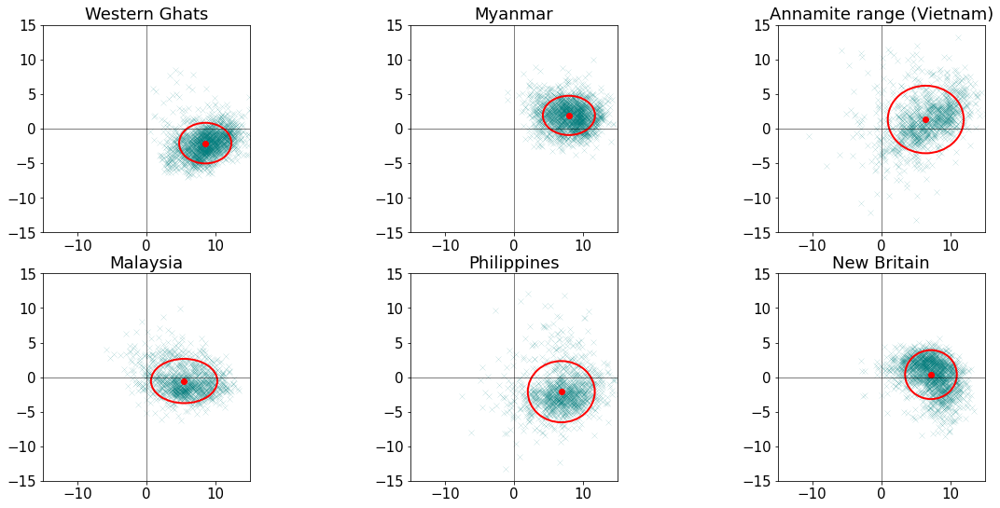

In [63]:
fig,axs = plt.subplots(2,3,figsize=(20,9))
axs = axs.reshape(-1)
for ax,MR in zip(axs,MRs):
    u = MR.vars['VAR_100U_PERP_INTERVAL_DAILY']
    v = MR.vars['VAR_100U_PARA_INTERVAL_DAILY']
    ax.scatter(u,v,marker='x',linewidth=0.1,color='teal')
    umean,vmean = u.mean(),v.mean()
    ustd,vstd = 3*u.std(),3*v.std()
    ax.scatter(umean,vmean,color='r')
    ax.add_patch(mpatches.Ellipse((umean,vmean),width=ustd,height=vstd,edgecolor='r',facecolor='none',linewidth=2))
    ax.set_title(MR.Lname)
    ax.set_aspect('equal')
    ax.set_xlim(-15,15)
    ax.set_ylim(-15,15)
    ax.axvline(0.,color='k',linewidth=0.5)
    ax.axhline(0.,color='k',linewidth=0.5)
    print(MR.name, "%i"%((((u-umean)/(ustd/2))**2+((v-vmean)/(vstd/2))**2 < 1).sum()/len(u)*100))
    


ghats 73
myanmar 66
vietnam 73
malaysia 68
philippines 73
newbritain 70


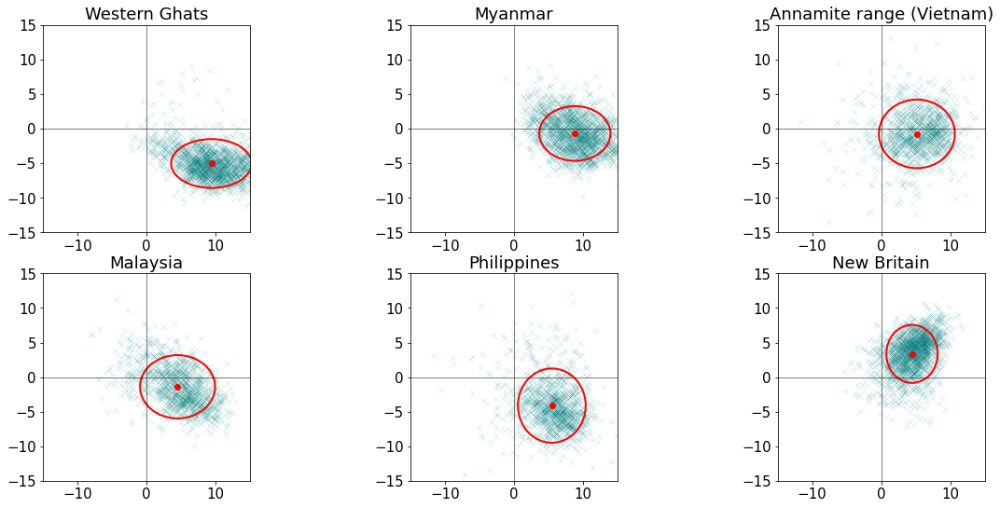

In [66]:
fig,axs = plt.subplots(2,3,figsize=(20,9))
axs = axs.reshape(-1)
for ax,MR in zip(axs,MRs):
    u = MR.vars['UL_PERP_INTERVAL_DAILY']
    v = MR.vars['UL_PARA_INTERVAL_DAILY']
    ax.scatter(u,v,marker='x',linewidth=0.1,color='teal')
    umean,vmean = u.mean(),v.mean()
    ustd,vstd = 3*u.std(),3*v.std()
    ax.scatter(umean,vmean,color='r')
    ax.add_patch(mpatches.Ellipse((umean,vmean),width=ustd,height=vstd,edgecolor='r',facecolor='none',linewidth=2))
    ax.set_title(MR.Lname)
    ax.set_aspect('equal')
    ax.set_xlim(-15,15)
    ax.set_ylim(-15,15)
    ax.axvline(0.,color='k',linewidth=0.5)
    ax.axhline(0.,color='k',linewidth=0.5)
    print(MR.name, "%i"%((((u-umean)/(ustd/2))**2+((v-vmean)/(vstd/2))**2 < 1).sum()/len(u)*100))
    


## Predictors of $B_L$

### Linearized $\Delta B_Ls$

In [118]:
# Evaluating slopes theoretically
alpha = 20.6/3600*2.5e6
dBLdqL = 1/(11.3*3600)*1004*8000/alpha
dBLdTL = -1/(2.7*3600)*1004*8000/alpha
dBLdeb = 1/(11.5*3600)*1004*8000/alpha

In [33]:
Newbritain.set_3dvar('PHI',"128_129_z")
sample_geopotential = Newbritain.vars['PHI'].mean(['latitude','longitude'])/9.81
dzdp = sample_geopotential.differentiate('level')

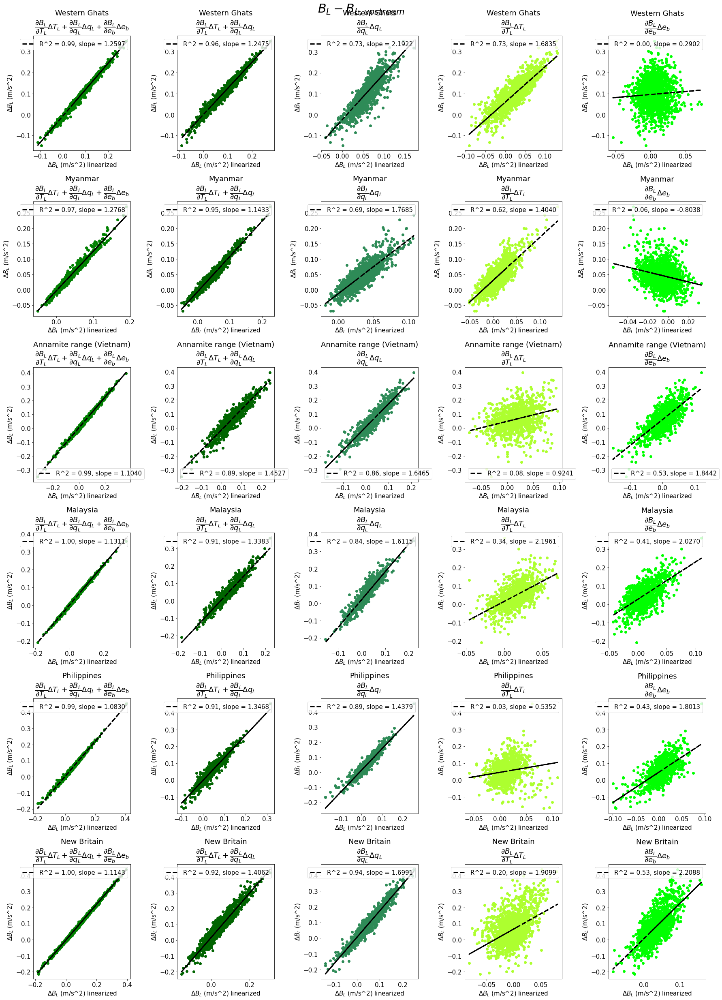

In [15]:
fig,axss = plt.subplots(6,5,figsize=(25,35))
for i,MR in enumerate(MRs):
    axs = axss[i]
    Bl_above = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Bl_rce = MR.vars['BLSIMPLE_RCE_DAILY']
    
    predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY'])
    predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_RCE_DAILY'])
    
    for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
        reg = linregress(pred,Bl_above-Bl_rce)
        axs[j].scatter(pred,Bl_above-Bl_rce,color=c)
        axs[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
        axs[j].set_xlabel("$\Delta B_L$ (m/s^2) linearized")
        axs[j].set_ylabel(r"$\Delta B_L$ (m/s^2)")
        axs[j].legend()
    axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
    axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
    axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
    axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

In [241]:
for i,MR in enumerate(MRs):
    Bl_above = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Bl_rce = MR.vars['BLSIMPLE_RCE_DAILY']
    
    predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY'])
    predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_RCE_DAILY'])
    
    varbase =  np.var(Bl_above-Bl_rce)
    print("{:<12} : B_L variance due to q_L = {:3.0f}%, T_L = {:2.0f}%, e_b = {:0.0f}%".format(MR.name, 100*float(np.var(predqL)/varbase ),100*float(np.var(predTL)/varbase ),100*float(np.var(predeb)/varbase )))
print("On monthly time scales:")
for i,MR in enumerate(MRs):
    Bl_above = resample_monthly(MR.vars['BLSIMPLE_ABOVE_DAILY'])
    Bl_rce   = resample_monthly(MR.vars['BLSIMPLE_RCE_DAILY'])
    
    predqL = resample_monthly(dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004.) 
    predTL = resample_monthly(dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY']))
    predeb = resample_monthly(dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_RCE_DAILY']))
    
    varbase =  np.var(Bl_above-Bl_rce)
    print("{:<12} : B_L variance due to q_L = {:3.0f}%, T_L = {:2.0f}%, e_b = {:0.0f}%".format(MR.name, 100*float(np.var(predqL)/varbase ),100*float(np.var(predTL)/varbase ),100*float(np.var(predeb)/varbase )))



ghats        : B_L variance due to q_L =  15%, T_L = 26%, e_b = 5%
myanmar      : B_L variance due to q_L =  22%, T_L = 31%, e_b = 9%
vietnam      : B_L variance due to q_L =  32%, T_L = 10%, e_b = 16%
malaysia     : B_L variance due to q_L =  32%, T_L =  7%, e_b = 10%
philippines  : B_L variance due to q_L =  43%, T_L = 10%, e_b = 13%
newbritain   : B_L variance due to q_L =  32%, T_L =  5%, e_b = 11%
On monthly time scales:
ghats        : B_L variance due to q_L =  13%, T_L = 27%, e_b = 10%
myanmar      : B_L variance due to q_L =  17%, T_L = 44%, e_b = 14%
vietnam      : B_L variance due to q_L =  35%, T_L = 16%, e_b = 23%
malaysia     : B_L variance due to q_L =  32%, T_L =  6%, e_b = 19%
philippines  : B_L variance due to q_L =  46%, T_L = 16%, e_b = 26%
newbritain   : B_L variance due to q_L =  33%, T_L =  6%, e_b = 15%


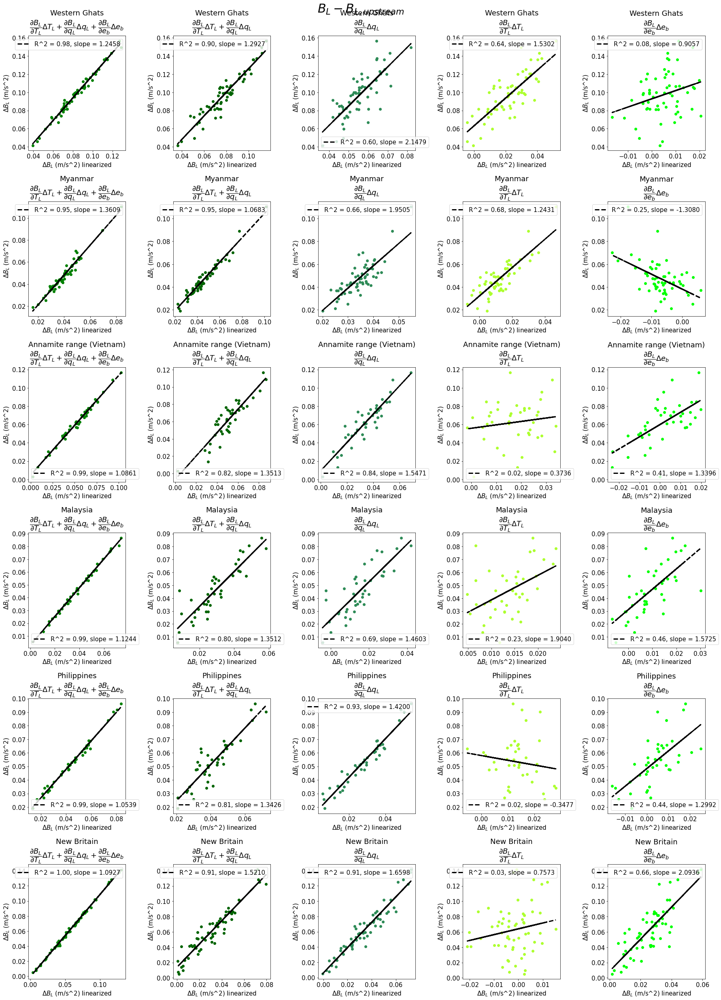

In [240]:
fig,axss = plt.subplots(6,5,figsize=(25,35))
for i,MR in enumerate(MRs):
    axs = axss[i]
    Bl_above = resample_monthly(MR.vars['BLSIMPLE_ABOVE_DAILY'])
    Bl_rce = resample_monthly(MR.vars['BLSIMPLE_RCE_DAILY'])
    
    predqL = resample_monthly(dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004. )
    predTL = resample_monthly(dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY']))
    predeb = resample_monthly(dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_RCE_DAILY']))
    
    for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
        reg = linregress(pred,Bl_above-Bl_rce)
        axs[j].scatter(pred,Bl_above-Bl_rce,color=c)
        axs[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
        axs[j].set_xlabel("$\Delta B_L$ (m/s^2) linearized")
        axs[j].set_ylabel(r"$\Delta B_L$ (m/s^2)")
        axs[j].legend()
    axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
    axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
    axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
    axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

### $\Delta T_L$ vs U

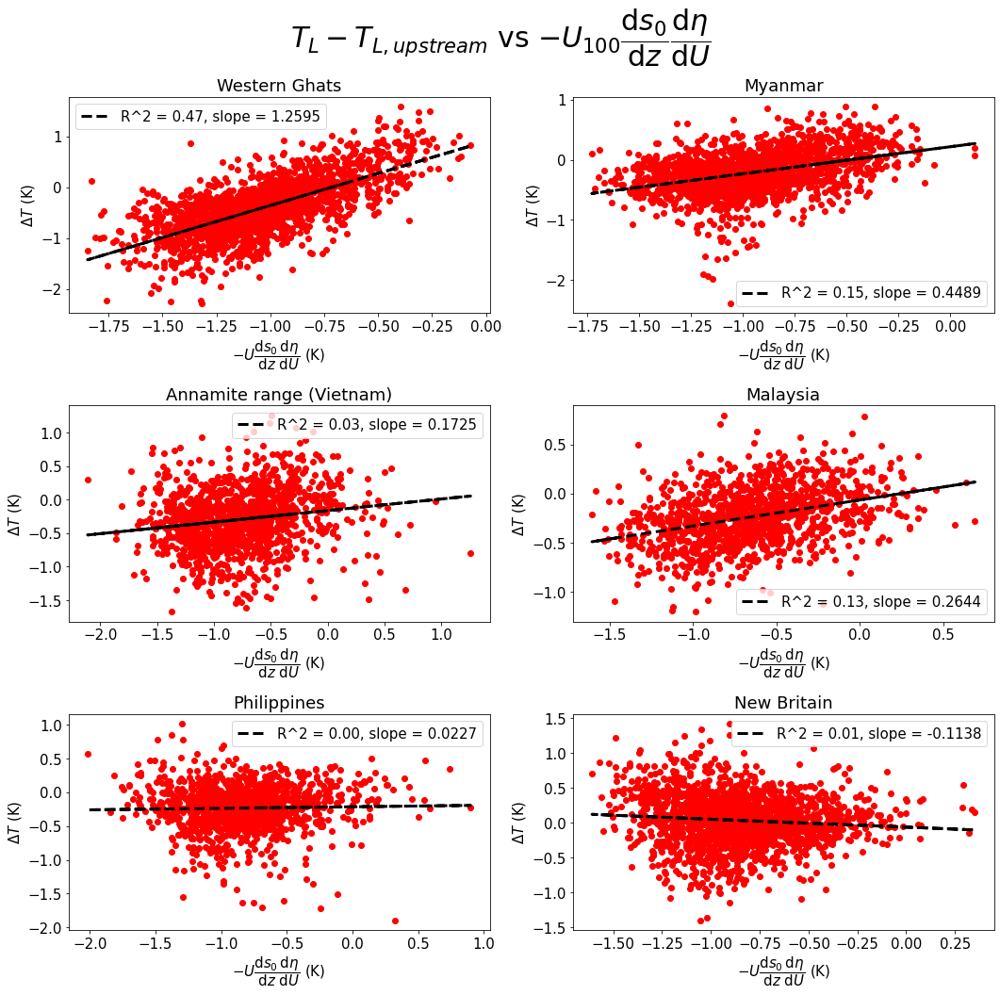

In [31]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dT = (MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY'])
    dsdz_base = 4e-3
    detadu = 30
    crossslopeu = MR.vars['VAR_100U_PERP_INTERVAL_DAILY']
    pred = -crossslopeu*detadu*dsdz_base
    
    reg = linregress(pred,dT)
    
    ax[j].scatter(pred,dT,color='r')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta T$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$T_L-T_{L,upstream}$ vs $-U_{100}\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

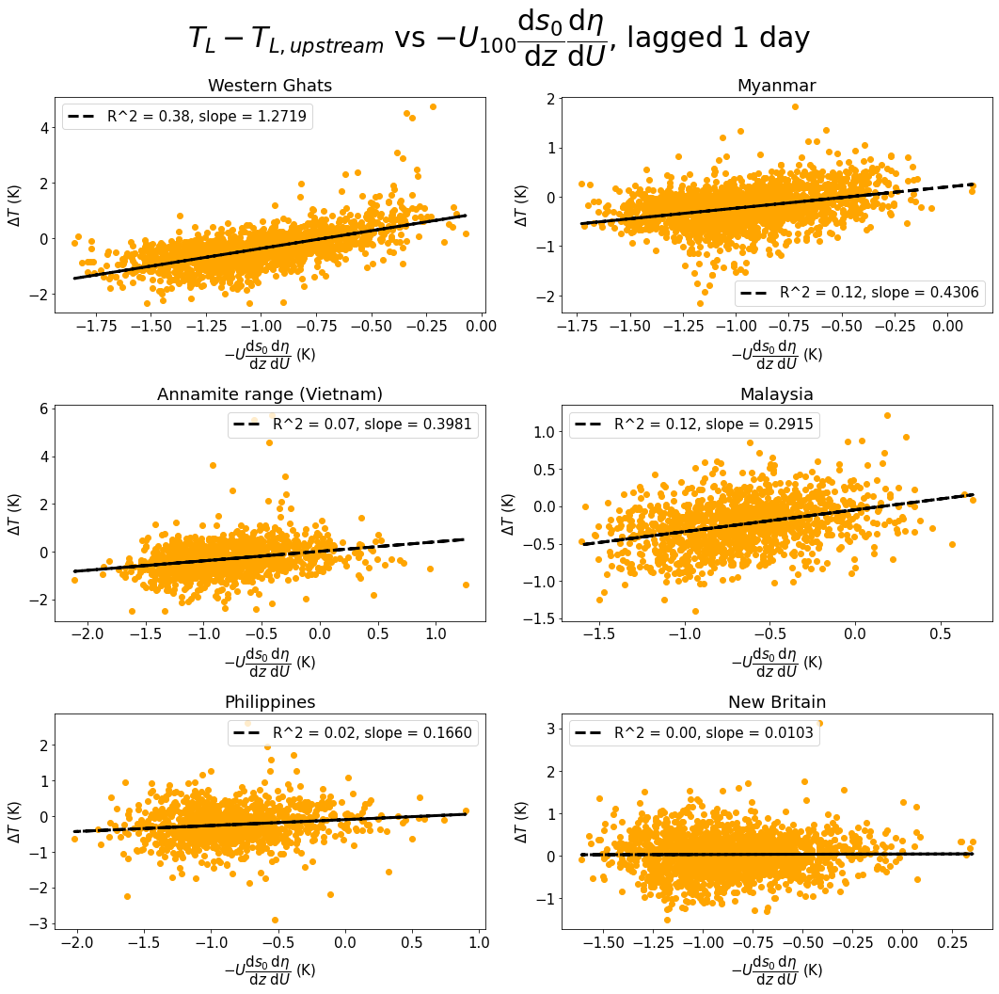

In [32]:
# Shifting 1 day
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dT = (np.array(MR.vars['TL_ABOVE_DAILY'][1:])-np.array(MR.vars['TL_RCE_DAILY'][:-1]))
    dsdz_base = 4e-3
    detadu = 30
    crossslopeu = MR.vars['VAR_100U_PERP_INTERVAL_DAILY'][1:]
    pred = -crossslopeu*detadu*dsdz_base
    
    reg = linregress(pred,dT)
    
    ax[j].scatter(pred,dT,color='orange')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta T$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$T_L-T_{L,upstream}$ vs $-U_{100}\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$, lagged 1 day",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

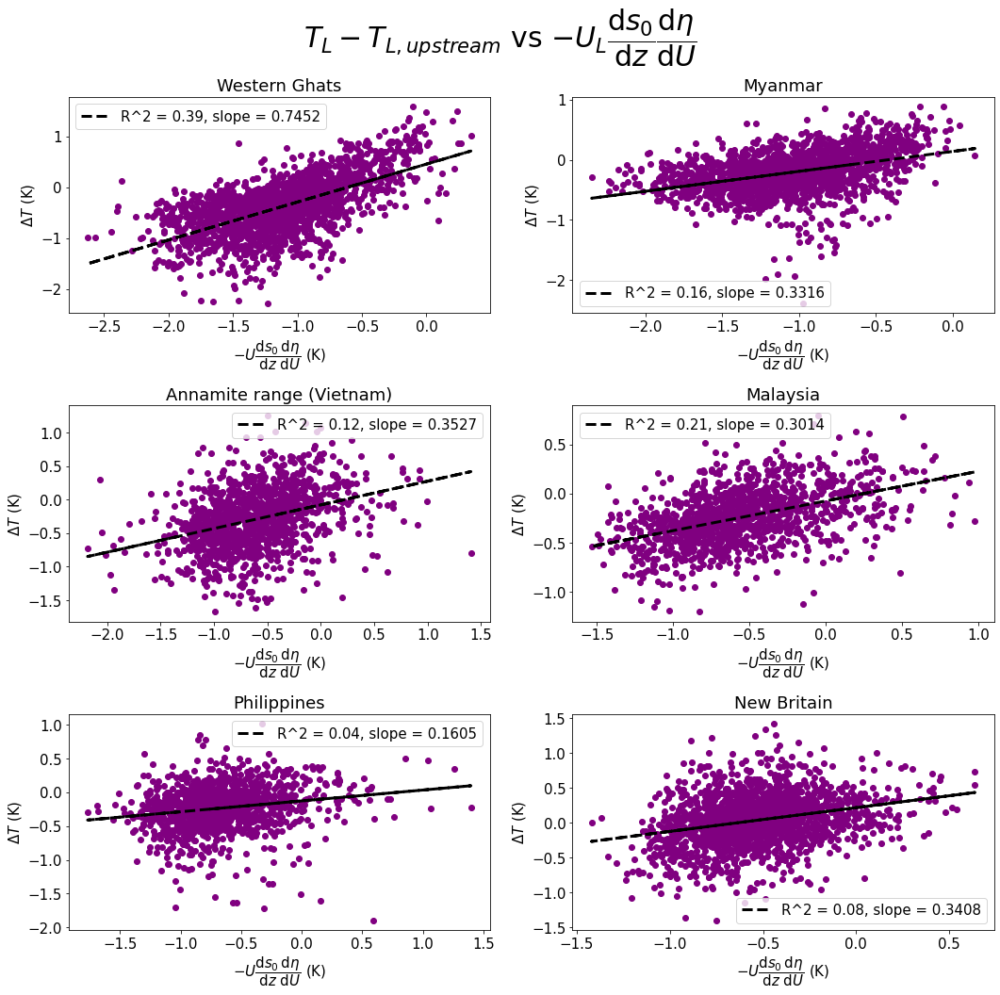

In [33]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dT = (MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY'])
    dsdz_base = 4e-3
    detadu = 30
    crossslopeu = MR.vars['UL_PERP_INTERVAL_DAILY']
    pred = -crossslopeu*detadu*dsdz_base
    
    reg = linregress(pred,dT)
    
    ax[j].scatter(pred,dT,color='purple')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta T$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$T_L-T_{L,upstream}$ vs $-U_{L}\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

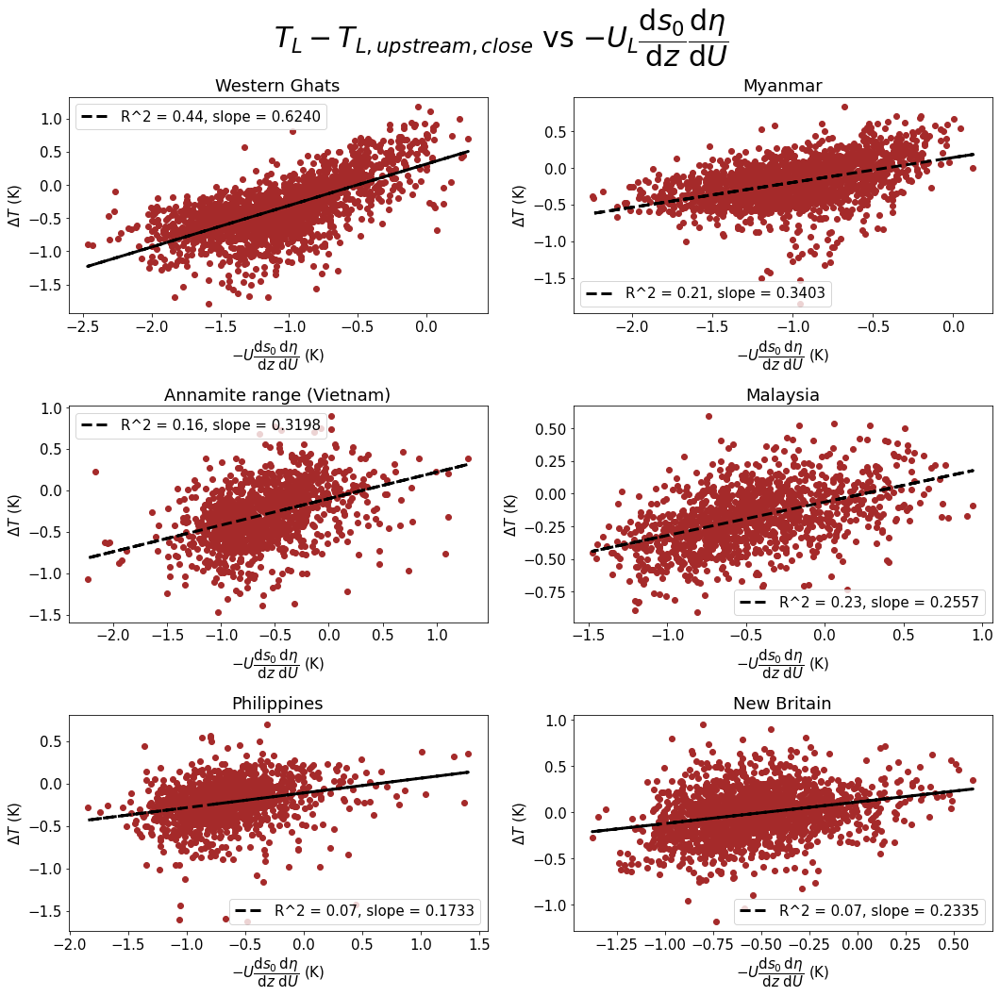

In [37]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dT = (MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_CLOSEUPSTREAM_DAILY'])
    dsdz_base = 4e-3
    detadu = 30
    crossslopeu = MR.vars['UL_PERP_CLOSEINTERVAL_DAILY']
    pred = -crossslopeu*detadu*dsdz_base
    
    reg = linregress(pred,dT)
    
    ax[j].scatter(pred,dT,color='brown')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta T$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$T_L-T_{L,upstream,close}$ vs $-U_{L}\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

### $\Delta q_L$ vs $U$

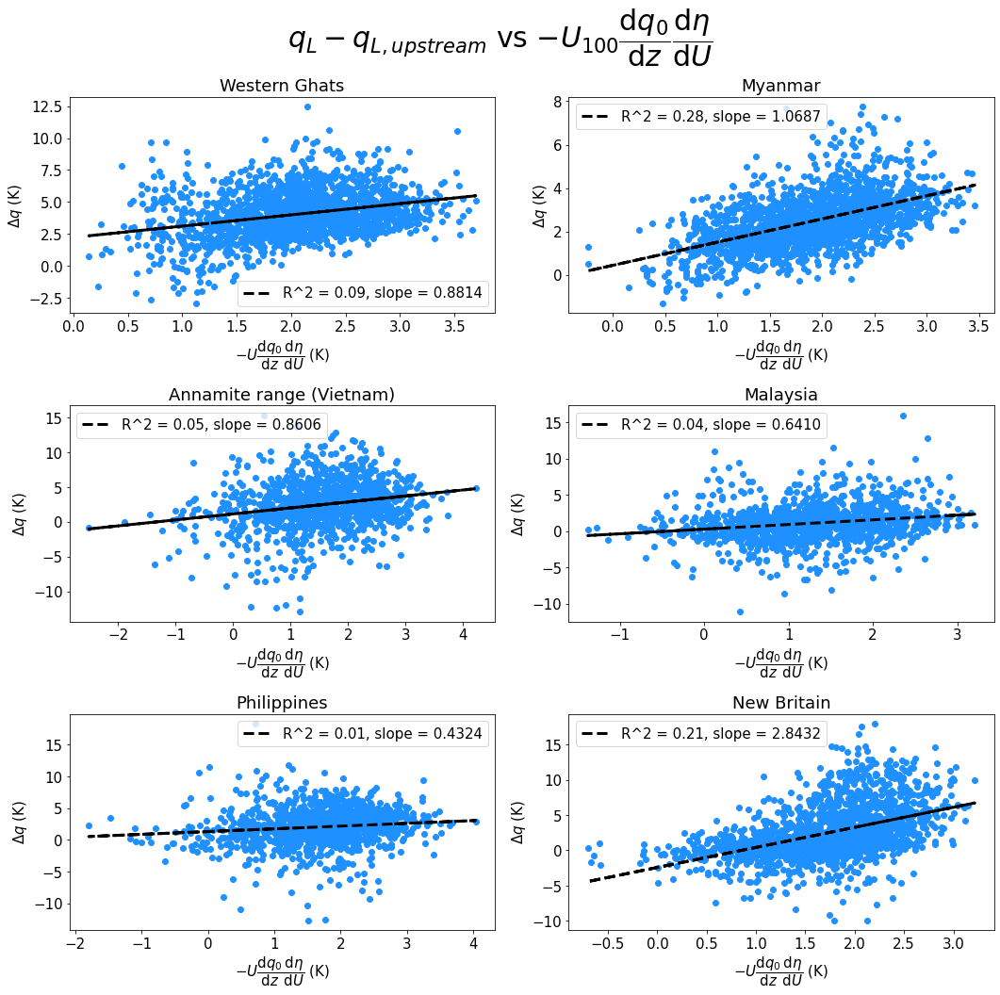

In [38]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dq = (MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004.
    dqdz_base = -8e-3
    detadu = 30
    crossslopeu = MR.vars['VAR_100U_PERP_INTERVAL_DAILY']
    pred = -crossslopeu*detadu*dqdz_base
    
    reg = linregress(pred,dq)
    
    ax[j].scatter(pred,dq,color='dodgerblue')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta q$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$q_L-q_{L,upstream}$ vs $-U_{100}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

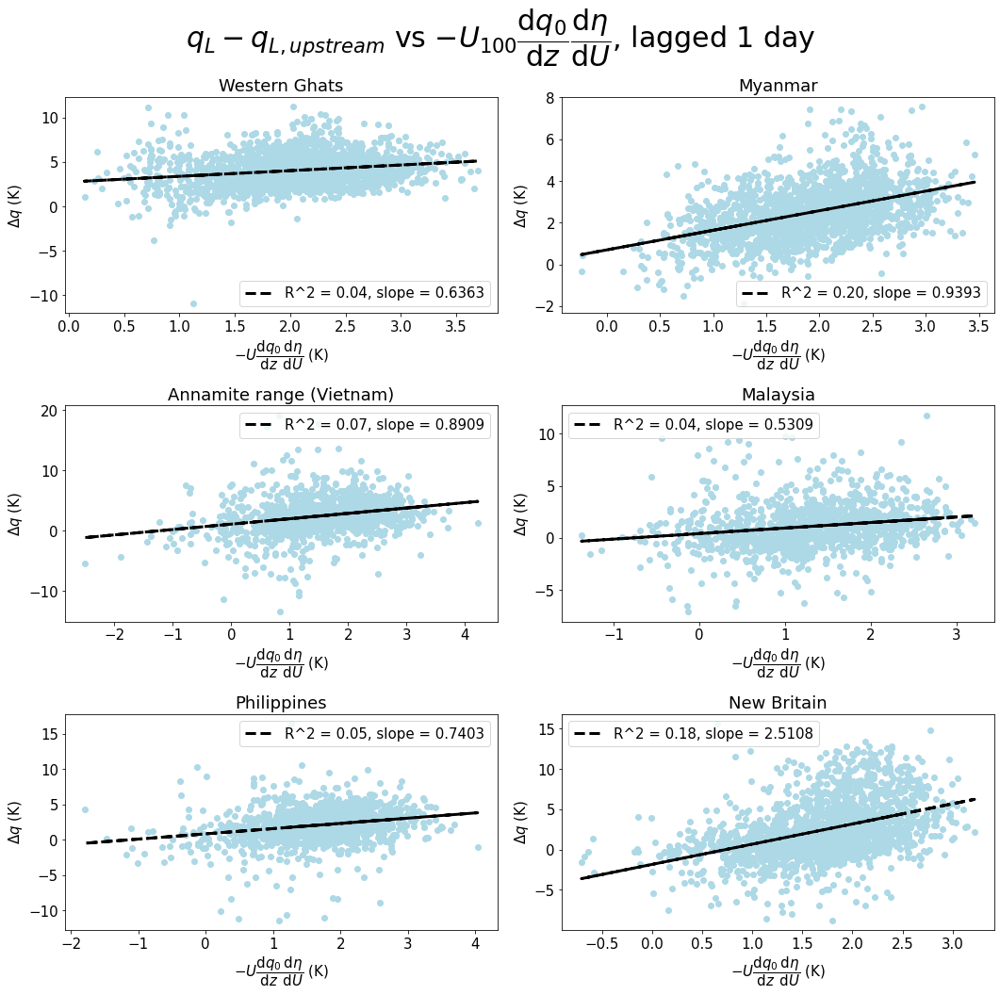

In [39]:
# Shifting 1 day
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dq = (np.array(MR.vars['QL_ABOVE_DAILY'][1:])-np.array(MR.vars['QL_RCE_DAILY'][:-1]))*2.5e6/1004.
    dqdz_base = -8e-3
    detadu = 30
    crossslopeu = MR.vars['VAR_100U_PERP_INTERVAL_DAILY'][1:]
    pred = -crossslopeu*detadu*dqdz_base
    
    reg = linregress(pred,dq)
    
    ax[j].scatter(pred,dq,color='lightblue')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta q$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$q_L-q_{L,upstream}$ vs $-U_{100}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$, lagged 1 day",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

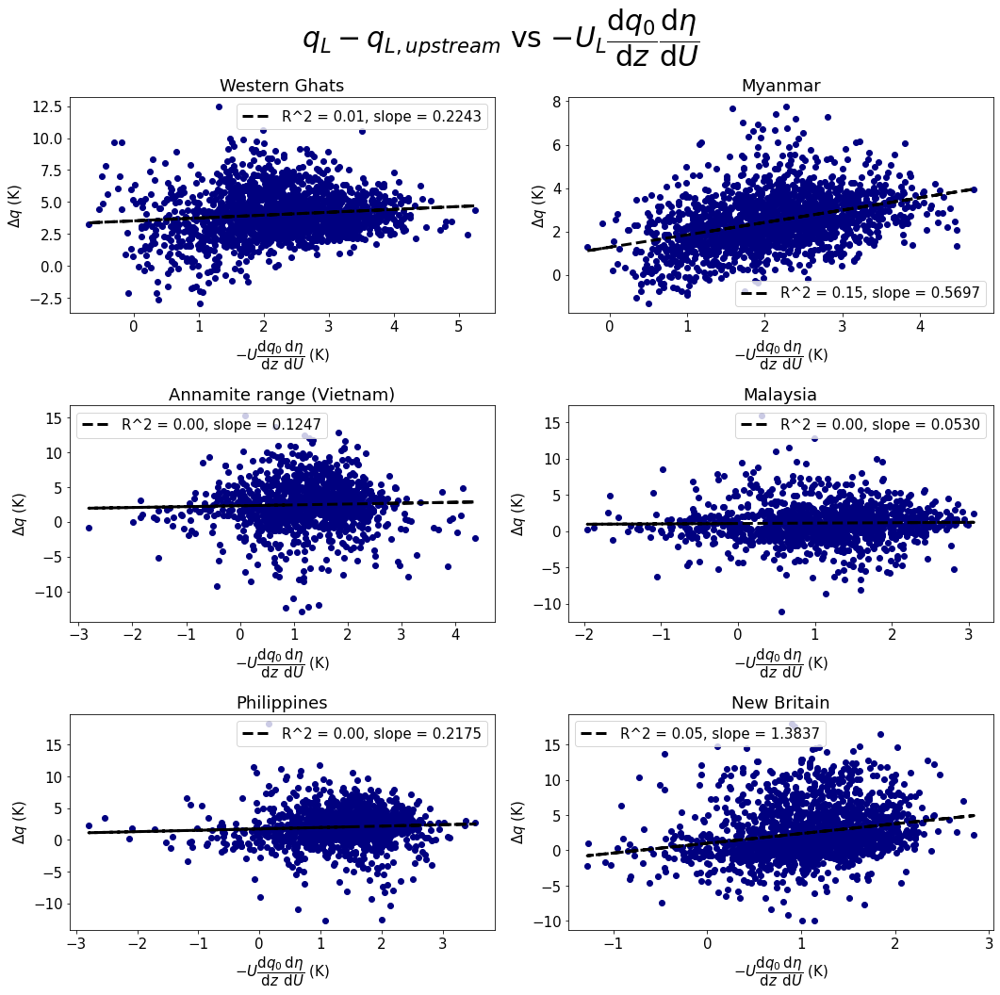

In [40]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dq = (MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004.
    dqdz_base = -8e-3
    detadu = 30
    crossslopeu = MR.vars['UL_PERP_INTERVAL_DAILY']
    pred = -crossslopeu*detadu*dqdz_base
    
    reg = linregress(pred,dq)
    
    ax[j].scatter(pred,dq,color='navy')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta q$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$q_L-q_{L,upstream}$ vs $-U_{L}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

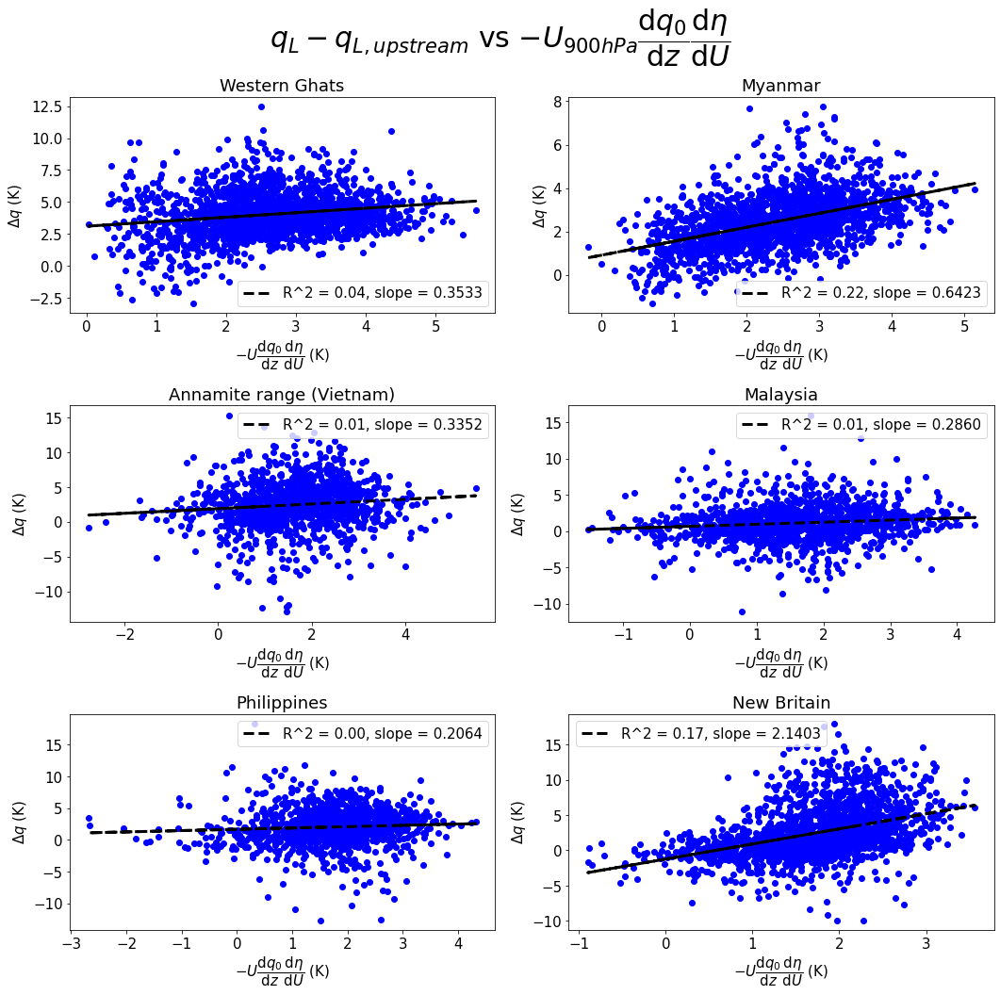

In [48]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dq = (MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCE_DAILY'])*2.5e6/1004.
    dqdz_base = -8e-3
    detadu = 30
    crossslopeu = MR.vars['U900_PERP_INTERVAL_DAILY']
    pred = -crossslopeu*detadu*dqdz_base
    
    reg = linregress(pred,dq)
    
    ax[j].scatter(pred,dq,color='b')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta q$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$q_L-q_{L,upstream}$ vs $-U_{900hPa}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

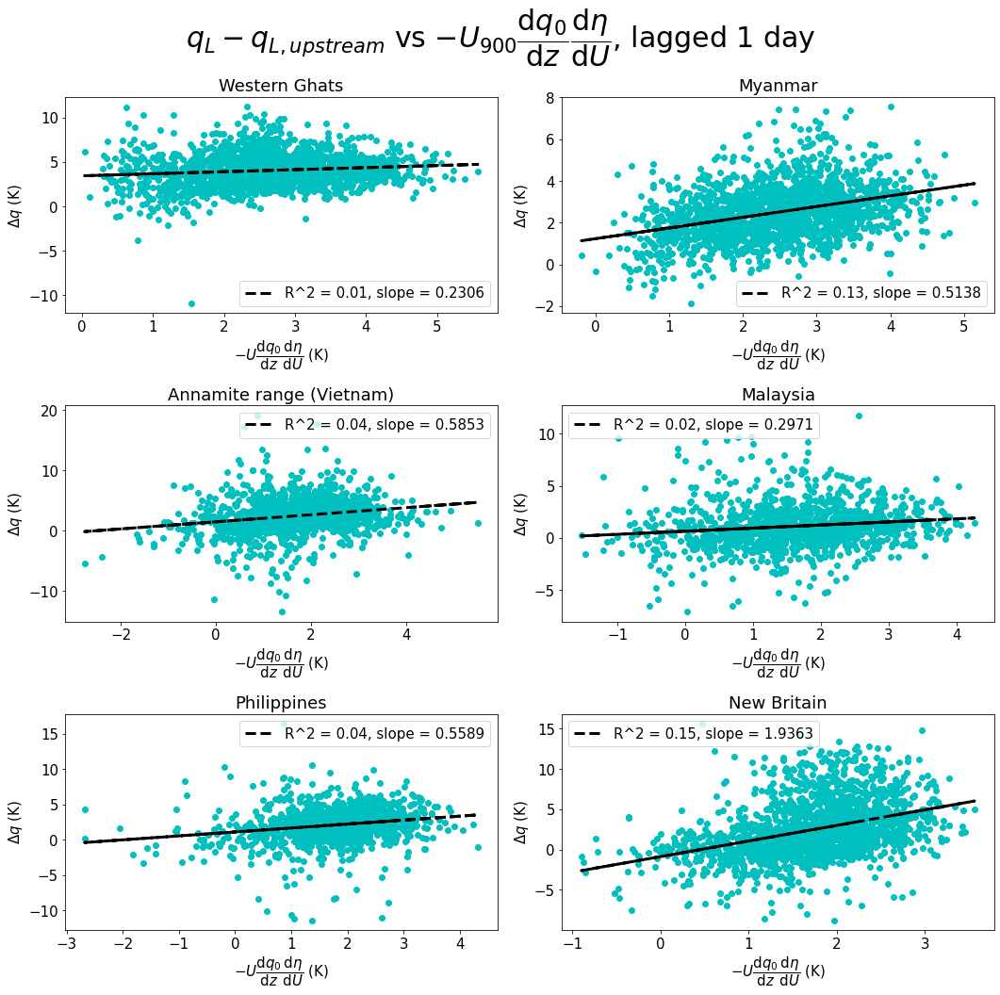

In [50]:
# Shifting 1 day
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dq = (np.array(MR.vars['QL_ABOVE_DAILY'][1:])-np.array(MR.vars['QL_RCE_DAILY'][:-1]))*2.5e6/1004.
    dqdz_base = -8e-3
    detadu = 30
    crossslopeu = MR.vars['U900_PERP_INTERVAL_DAILY'][1:]
    pred = -crossslopeu*detadu*dqdz_base
    
    reg = linregress(pred,dq)
    
    ax[j].scatter(pred,dq,color='c')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta q$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$q_L-q_{L,upstream}$ vs $-U_{900}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$, lagged 1 day",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

### New boxes

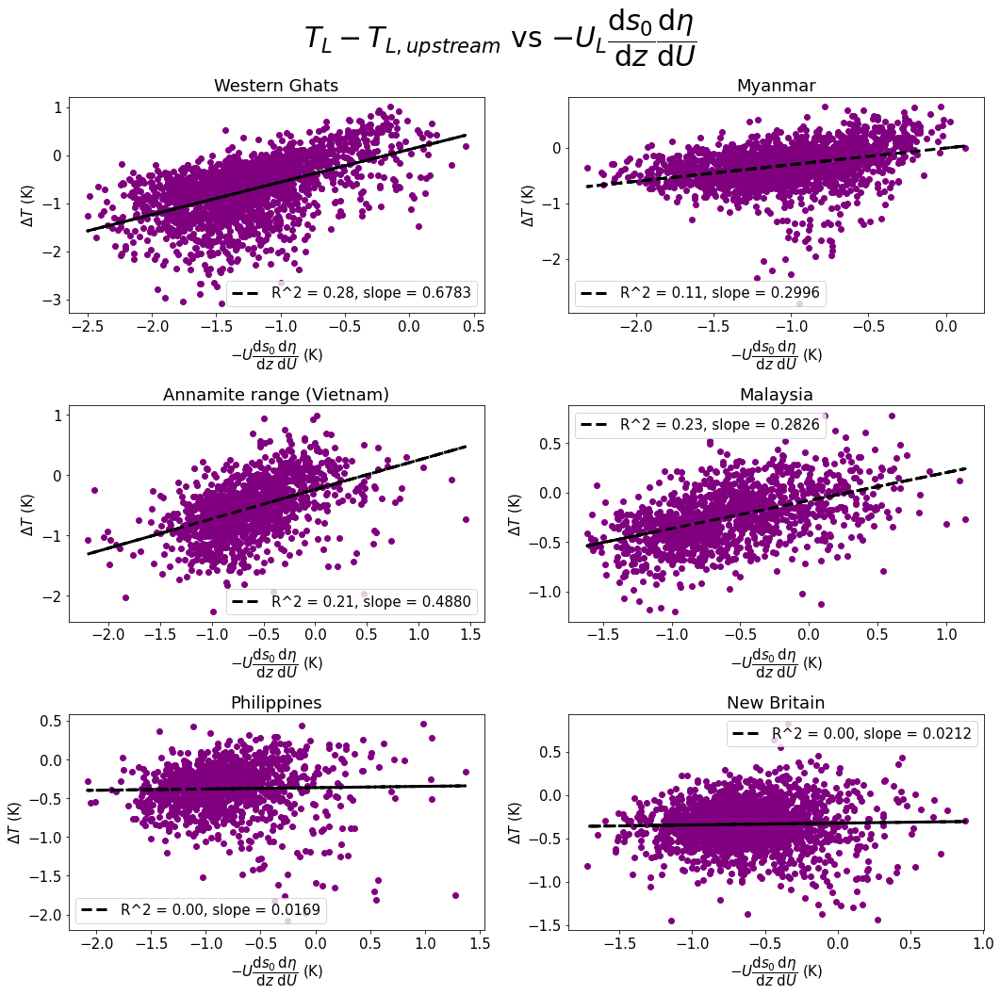

In [108]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dT = (MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCEL_DAILY'])
    dsdz_base = 4e-3
    detadu = 30
    crossslopeu = MR.vars['UL_PERPL_INTERVALL_DAILY']
    pred = -crossslopeu*detadu*dsdz_base
    
    reg = linregress(pred,dT)
    
    ax[j].scatter(pred,dT,color='purple')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta T$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$T_L-T_{L,upstream}$ vs $-U_{L}\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

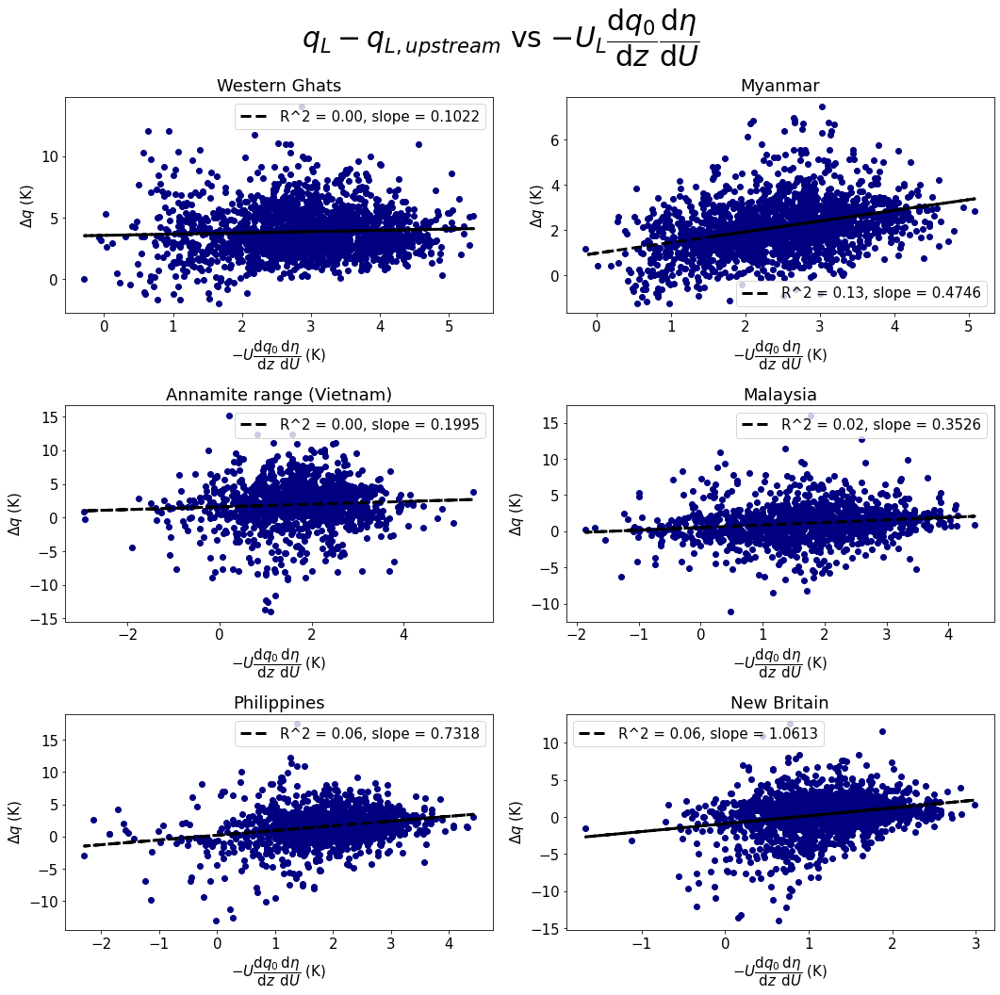

In [111]:
fig,ax = plt.subplots(3,2,figsize=(15,15))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    dq = (MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_RCEL_DAILY'])*2.5e6/1004.
    dqdz_base = -8e-3
    detadu = 30
    crossslopeu = MR.vars['U900_PERPL_INTERVALL_DAILY']
    pred = -crossslopeu*detadu*dqdz_base
    
    reg = linregress(pred,dq)
    
    ax[j].scatter(pred,dq,color='navy')
    
    ax[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel(r"$-U\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
    ax[j].set_ylabel(r"$\Delta q$ (K)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$q_L-q_{L,upstream}$ vs $-U_{L}\dfrac{\mathrm{d} q_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$",fontsize=30)#$U_\perp(\dfrac{\partial s}{\partial z}\dfrac{\partial s}{\partial z})$
fig.tight_layout()

### Finding best wind predictor regions

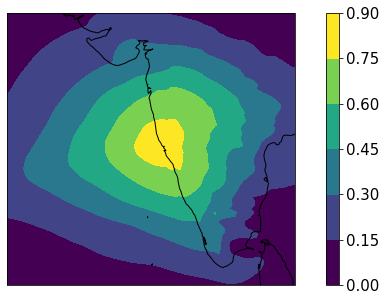

In [66]:
# Regressing a q index
MR=Ghats

def rsq_xr(var,pred):
    reg = var.assign_coords({'pred':('time',np.array(pred))}).swap_dims({'time':'pred'}).polyfit('pred',1).polyfit_coefficients#.sel(degree=1)
    residual = var - reg.sel(degree=1)*pred-reg.sel(degree=0)
    rss = (residual**2).sum('time')
    tss = len(var.time)*var.var(dim='time')
    rsq = 1-rss/tss
    return reg.sel(degree=1),rsq
_,rsq = rsq_xr(MR.vars['QL_DAILY'],MR.vars['QL_ABOVE_DAILY'])

fig,ax = plt.subplots(1,1,figsize=(11,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
scale=0.1
rsq.plot.contourf(ax=ax)#,levels=np.linspace(-scale,scale,11),cmap=plt.cm.RdBu_r,cbar_kwargs={'label':'K/(mm/day)'})
#ax.set_title('SST regressed on SMO precip',{'horizontalalignment': 'right'})
ax.coastlines()


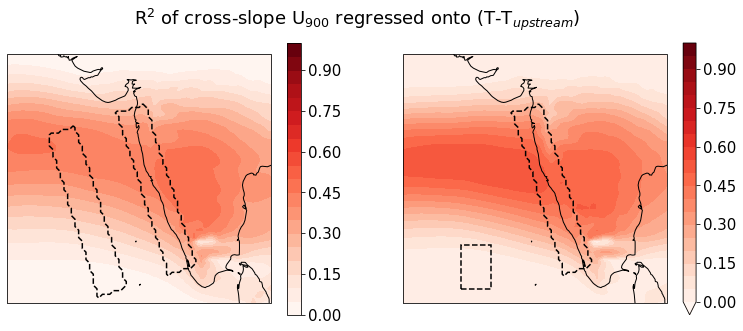

In [74]:
# Regressing a q index
MR=Ghats

fig,(ax1,ax2) = plt.subplots(1,2,figsize=(13,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
reg,rsq = rsq_xr(MR.vars['U900_PERP_DAILY'],MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_RCE_DAILY'])
rsq.plot.contourf(ax=ax1,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)

Ghats.box_rce_test = [68,70,8,11]
reg,rsq = rsq_xr(MR.vars['U900_PERP_DAILY'],MR.vars['TL_ABOVE_DAILY']-spatial_mean(MR.vars['TL_DAILY'],box = Ghats.box_rce_test))
rsq.plot.contourf(ax=ax2,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)

tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax1,levels=[0.5],linestyles=['--'],colors=['k'])
tilted_rect_distance(MR.vars['UL_PERP_DAILY'],*MR.box_tilted[:-1],-3,-5).plot.contour(ax=ax1,levels=[0.5],linestyles=['--'],colors=['k'])

tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax2,levels=[0.5],linestyles=['--'],colors=['k'])
box=Ghats.box_rce_test
ax2.add_patch(mpatches.Rectangle(xy=[box[0], box[2]], width=box[1]-box[0], height=box[3]-box[2],
                                    edgecolor='k',
                                    fill = False,
                                    lw=1.5,
                                    linestyle='--',
                                    transform=ccrs.PlateCarree()))
ax1.coastlines();ax2.coastlines()
fig.suptitle(r'R$^2$ of cross-slope U$_{900}$ regressed onto (T-T$_{upstream}$) ');None

In [75]:
from joblib import Parallel, delayed
from multiprocessing.pool import ThreadPool

def reg_rsq_np(var,pred,tss):
    reg,rss,_,_,_ = np.polyfit(pred,np.array(var).reshape((len(var),-1)),1,full=True)
    rsq = 1-rss/tss
    argm = np.argmax(rsq)
    return float(reg[0,argm]),float(rsq[argm])

def rsquareds(MR,varname):
    num_cores=16
    
    tss = len(MR.vars['VAR_100U_PERP_DAILY'].time)*MR.vars['VAR_100U_PERP_DAILY'].var(dim='time')
    _toberun = lambda pred:reg_rsq_np(MR.vars['VAR_100U_PERP_DAILY'],pred,tss)
    all_args = [MR.vars[varname+'_ABOVE_DAILY']-MR.vars[varname+'_DAILY'][:,lat,lon] for lon in range(73) for lat in range(69)]
    
    p=ThreadPool(num_cores)
    results = p.imap_unordered(_toberun, all_args)
    
    p.close()
    p.join()
    
    rsqs = 0*MR.vars['VAR_100U_PERP_DAILY'][0]
    for i,(reg,r2) in enumerate(results):
        rsqs[i%69,i//69] = r2 * np.sign(reg) * (-1*(varname=='T') + 1*(varname=='Q'))
    return rsqs

def rsquareds_monthly(MR,varname,uname,levs=(700,900)):
    num_cores=4
    
    u = resample_monthly(MR.vars['{}_PERP_DAILY'.format(uname)])
    u = u.sel(time=(u['time.year']<=2018))
    tss = len(u.time)*u.var(dim='time')
    tss = np.array(tss).reshape(-1)
    
    _toberun = lambda pred:reg_rsq_np(u,pred,tss)
    
    var_mo = sel_months(MR.vars[varname+'_MONTHLY'],MR.months).sel(level=slice(700,900)).mean('level')
    varabove_mo = sel_months(MR.vars[varname+'_ABOVE_MONTHLY'],MR.months).sel(level=slice(*levs)).mean('level')
    all_args = [varabove_mo-var_mo[:,lat,lon] for lon in range(73) for lat in range(69)]
    
    p=ThreadPool(num_cores)
    results = p.imap_unordered(_toberun, all_args)
    
    p.close()
    p.join()
    
    rsqs = 0*MR.vars['VAR_100U_PERP_DAILY'][0]
    for i,(reg,r2) in enumerate(results):
        rsqs[i%69,i//69] = r2 * np.sign(reg) * (-1*(varname=='T') + 1*(varname=='Q'))
    return rsqs

In [76]:
for MR in MRs:
    print(MR.name)
    %time MR.vars['TL_U100_MONTHLY_R2'] = rsquareds_monthly(MR,'T','VAR_100U')
    %time MR.vars['QL_U100_MONTHLY_R2'] = rsquareds_monthly(MR,'Q','VAR_100U')
    %time MR.vars['TL_U900_MONTHLY_R2'] = rsquareds_monthly(MR,'T','U900')
    %time MR.vars['QL_U900_MONTHLY_R2'] = rsquareds_monthly(MR,'Q','U900')

ghats
CPU times: user 43 s, sys: 2.64 s, total: 45.6 s
Wall time: 9.87 s
CPU times: user 43.5 s, sys: 2.61 s, total: 46.1 s
Wall time: 9.83 s
myanmar
CPU times: user 42.6 s, sys: 2.57 s, total: 45.2 s
Wall time: 9.76 s
CPU times: user 40.4 s, sys: 2.49 s, total: 42.9 s
Wall time: 9.27 s
vietnam
CPU times: user 38.6 s, sys: 2.42 s, total: 41.1 s
Wall time: 9.32 s
CPU times: user 39.9 s, sys: 2.58 s, total: 42.5 s
Wall time: 9.48 s
malaysia
CPU times: user 39.6 s, sys: 2.36 s, total: 42 s
Wall time: 9.26 s
CPU times: user 41.5 s, sys: 2.44 s, total: 44 s
Wall time: 10 s
philippines
CPU times: user 40.4 s, sys: 2.55 s, total: 43 s
Wall time: 9.32 s
CPU times: user 38.5 s, sys: 2.55 s, total: 41.1 s
Wall time: 9.28 s
newbritain
CPU times: user 43.9 s, sys: 2.47 s, total: 46.4 s
Wall time: 9.72 s
CPU times: user 44 s, sys: 2.67 s, total: 46.7 s
Wall time: 10 s


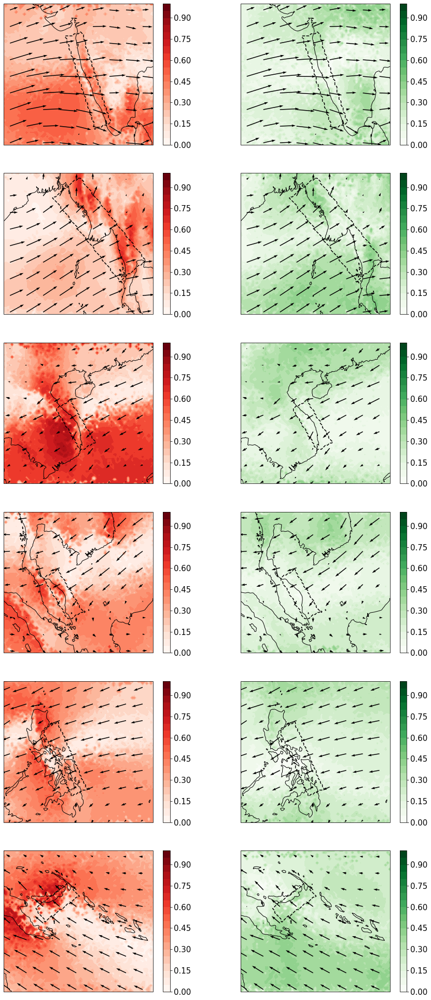

In [358]:
fig,axs = plt.subplots(6,2,figsize=(15,35),subplot_kw={"projection":ccrs.PlateCarree()})
for ((ax1,ax2),MR) in zip(axs,MRs):
    MR.vars['TL_R2'].plot.contourf(ax=ax1,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)
    MR.vars['QL_R2'].plot.contourf(ax=ax2,levels=np.linspace(0,1,21),cmap=plt.cm.Greens)

    for ax in ax1,ax2:
        tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
        ax.coastlines()
        u=MR.vars['U900_DAILY'].mean('time')
        v=MR.vars['V900_DAILY'].mean('time')
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = u.longitude.expand_dims({"latitude":u.latitude})
        n=len(u.latitude)//8
        m=n
        ibeg=3
        iend=-1
        Q=ax.quiver(np.array(Y)[ibeg:iend:n,ibeg:iend:n],np.array(X)[ibeg:iend:n,ibeg:iend:n], np.array(u)[ibeg:iend:n,ibeg:iend:n], np.array(v)[ibeg:iend:n,ibeg:iend:n],color="k",transform=ccrs.PlateCarree(),scale=100,scale_units='height',width=1.5,units='dots')
     

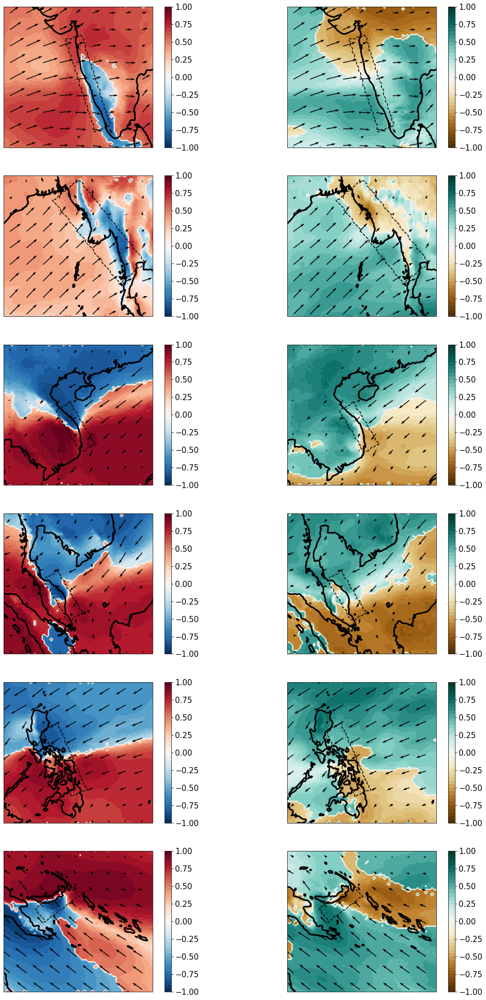

In [77]:
fig,axss = plt.subplots(6,2,figsize=(18,35),subplot_kw={"projection":ccrs.PlateCarree()})
for (axs,MR) in zip(axss,MRs):
    for ax,varname,cm in zip(axs,['T','Q'],[plt.cm.RdBu_r,plt.cm.BrBG]):
        MR.vars['{}L_U100_MONTHLY_R2'     .format(varname)].plot.contourf(ax=ax,levels=np.linspace(-1,1,41),cmap=cm)
        ax.set_title(MR.Lname + ' ' + varname)
    
        tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
        ax.coastlines(linewidth=3)
        u=MR.vars['VAR_100U_DAILY'].mean('time')
        v=MR.vars['VAR_100V_DAILY'].mean('time')
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = u.longitude.expand_dims({"latitude":u.latitude})
        n=len(u.latitude)//8
        m=n
        ibeg=3
        iend=-1
        Q=ax.quiver(np.array(Y)[ibeg:iend:n,ibeg:iend:n],np.array(X)[ibeg:iend:n,ibeg:iend:n], np.array(u)[ibeg:iend:n,ibeg:iend:n], np.array(v)[ibeg:iend:n,ibeg:iend:n],color="k",transform=ccrs.PlateCarree(),scale=100,scale_units='height',width=1.5,units='dots')
     

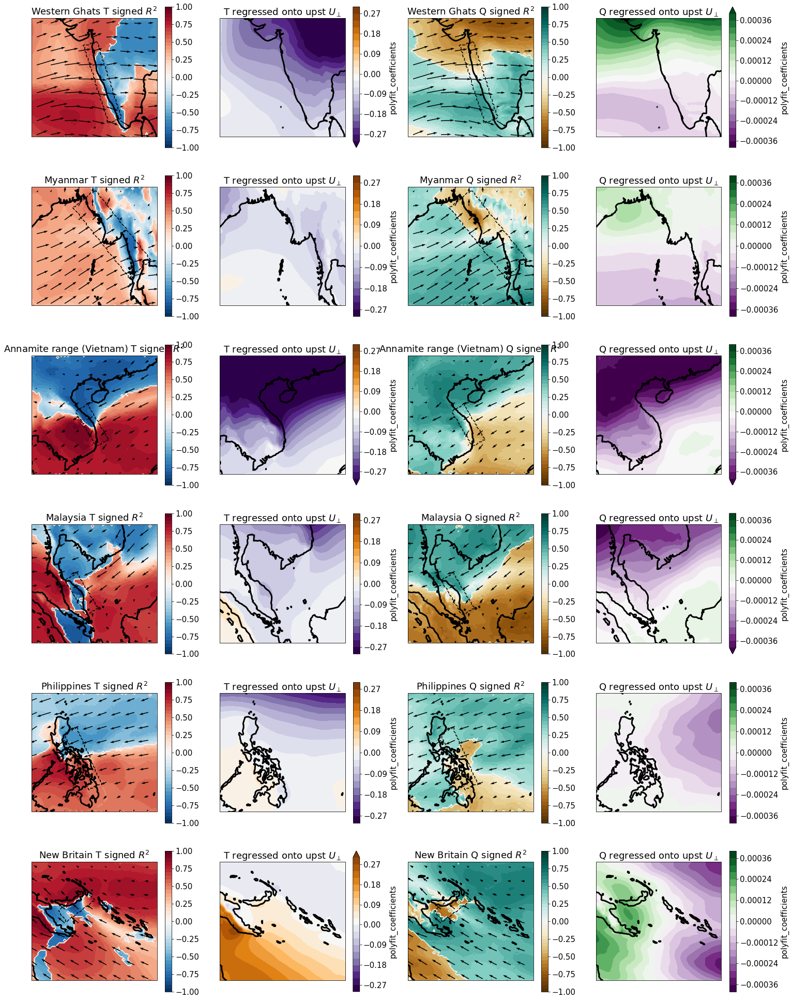

In [226]:
fig,axss = plt.subplots(6,4,figsize=(25,35),subplot_kw={"projection":ccrs.PlateCarree()})
for (axs,MR) in zip(axss[:,::2],MRs):
    for ax,varname,cm in zip(axs,['T','Q'],[plt.cm.RdBu_r,plt.cm.BrBG]):
        MR.vars['{}L_U900_MONTHLY_R2'     .format(varname)].plot.contourf(ax=ax,levels=np.linspace(-1,1,41),cmap=cm)
    
        tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
        ax.coastlines(linewidth=3)
        u=MR.vars['U900_DAILY'].mean('time')
        v=MR.vars['V900_DAILY'].mean('time')
        X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
        Y = u.longitude.expand_dims({"latitude":u.latitude})
        n=len(u.latitude)//8
        m=n
        ibeg=3
        iend=-1
        Q=ax.quiver(np.array(Y)[ibeg:iend:n,ibeg:iend:n],np.array(X)[ibeg:iend:n,ibeg:iend:n], np.array(u)[ibeg:iend:n,ibeg:iend:n], np.array(v)[ibeg:iend:n,ibeg:iend:n],color="k",transform=ccrs.PlateCarree(),scale=100,scale_units='height',width=1.5,units='dots')
        ax.set_title(MR.Lname + ' ' + varname + r' signed $R^2$')
        
for (axs,MR) in zip(axss[:,1::2],MRs):
    for ax,varname,cm,levs in zip(axs,['T','Q'],[plt.cm.PuOr_r,plt.cm.PRGn],[np.linspace(-0.3,0.3,21),np.linspace(-4e-4,4e-4,21)]):
        var_monthly = sel_months(MR.vars['{}_MONTHLY'.format(varname)],MR.months).sel(level=slice(700,900)).mean(['level'])
        u = resample_monthly(MR.vars['U900_PERP_DAILY'])
        pred = spatial_mean(u.sel(time=(u['time.year']<=2018)),box=MR.box_wind)
        reg = var_monthly.assign_coords({'pred':('time',np.array(pred))}).swap_dims({'time':'pred'}).polyfit('pred',1).polyfit_coefficients.sel(degree=1)
        reg.plot.contourf(ax=ax,cmap=cm,levels=levs)
    
        ax.coastlines(linewidth=3)
        ax.set_title(varname + r' regressed onto upst $U_\perp$')
     

In [78]:
def rsq_xr(var,pred):
    rss = var.assign_coords({'pred':('time',np.array(pred))}).swap_dims({'time':'pred'}).polyfit('pred',1,full=True).polyfit_residuals
    tss = var.var('time')*len(var.time)
    rsq = 1-rss/tss
    return rsq

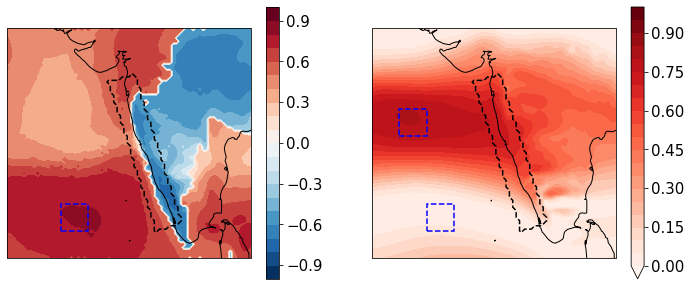

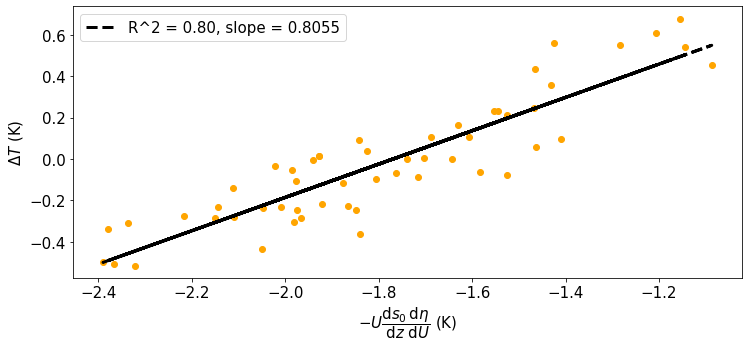

In [79]:
fig,axs = plt.subplots(1,2,figsize=(12,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
MR=Ghats
boxups = [68,70,9,11]
boxwind = [66,68,16,18]

ax=axs[0]
MR.vars['TL_U900_MONTHLY_R2'].plot.contourf(ax=ax,levels=np.linspace(-1,1,21),cmap=plt.cm.RdBu_r)

ax=axs[1]
u = resample_monthly(MR.vars['U900_PERP_DAILY'])
u = u.sel(time=(u['time.year']<=2018))
var_mo = sel_months(MR.vars['T_MONTHLY'],MR.months).sel(level=slice(700,900)).mean('level')

varups_mo = sel_box(var_mo,boxups).mean(['latitude','longitude'])
varabove_mo = sel_months(MR.vars['T_ABOVE_MONTHLY'],MR.months).sel(level=slice(700,900)).mean('level')
dT = varabove_mo-varups_mo

rsq = rsq_xr(u,dT)
rsq.plot.contourf(ax=ax,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)


for i,ax in enumerate(axs):
    ax.coastlines()
    tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    boxes=(boxups,)
    if i>=1:
        boxes=(boxups,boxwind)
    for box in boxes:
        ax.add_patch(mpatches.Rectangle(xy=[box[0], box[2]], width=box[1]-box[0], height=box[3]-box[2],
                                           edgecolor='b',
                                           fill = False,
                                           lw=1.5,
                                           linestyle='--',
                                           transform=ccrs.PlateCarree()))
fig,ax = plt.subplots(1,1,figsize=(12,5))
crossslopeu = sel_box(u,boxwind).mean(['latitude','longitude'])
dsdz_base = 4e-3
detadu = 30
pred = -crossslopeu*detadu*dsdz_base
reg = linregress(pred,dT)

ax.scatter(pred,dT,color='orange')
ax.plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
ax.set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
ax.set_ylabel(r"$\Delta T$ (K)")
ax.legend()


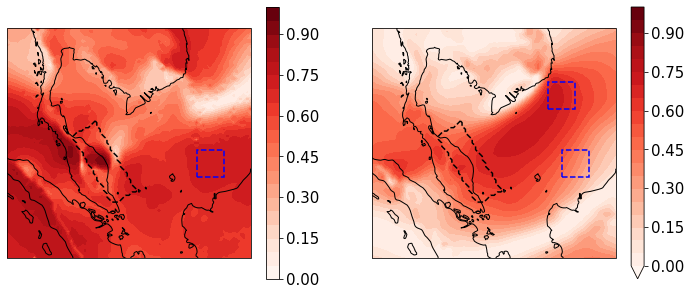

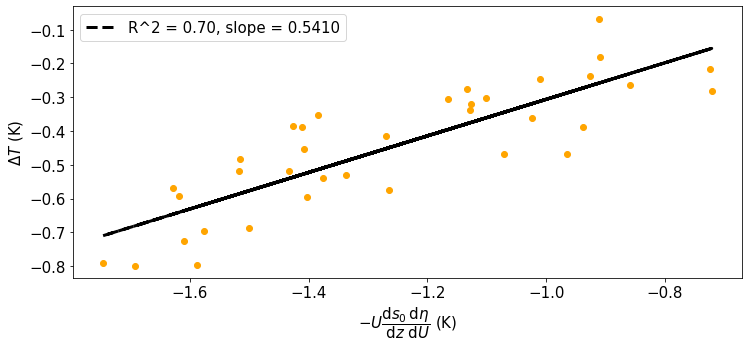

In [50]:
fig,axs = plt.subplots(1,2,figsize=(12,5),subplot_kw={"projection":ccrs.PlateCarree()})#len(levs),1
MR=Malaysia
#boxups = [113,115,20,22]
boxups = [110,112,4,6]
boxwind = [109,111,9,11]

ax=axs[0]
MR.vars['TL_U900_MONTHLY_R2'].plot.contourf(ax=ax,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)

ax=axs[1]
u = resample_monthly(MR.vars['U900_PERP_DAILY'])
u = u.sel(time=(u['time.year']<=2018))
var_mo = sel_months(MR.vars['T_MONTHLY'],MR.months).sel(level=slice(700,900)).mean('level')

varups_mo = sel_box(var_mo,boxups).mean(['latitude','longitude'])
varabove_mo = sel_months(MR.vars['T_ABOVE_MONTHLY'],MR.months).sel(level=slice(700,900)).mean('level')
dT = varabove_mo-varups_mo

rsq = rsq_xr(u,dT)
rsq.plot.contourf(ax=ax,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)


for i,ax in enumerate(axs):
    ax.coastlines()
    tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    boxes=(boxups,)
    if i>=1:
        boxes=(boxups,boxwind)
    for box in boxes:
        ax.add_patch(mpatches.Rectangle(xy=[box[0], box[2]], width=box[1]-box[0], height=box[3]-box[2],
                                           edgecolor='b',
                                           fill = False,
                                           lw=1.5,
                                           linestyle='--',
                                           transform=ccrs.PlateCarree()))
fig,ax = plt.subplots(1,1,figsize=(12,5))
crossslopeu = sel_box(u,boxwind).mean(['latitude','longitude'])
dsdz_base = 4e-3
detadu = 30
pred = -crossslopeu*detadu*dsdz_base
reg = linregress(pred,dT)

ax.scatter(pred,dT,color='orange')
ax.plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
ax.set_xlabel(r"$-U\dfrac{\mathrm{d} s_0}{\mathrm{d} z} \dfrac{\mathrm{d} \eta}{\mathrm{d} U}$ (K)")
ax.set_ylabel(r"$\Delta T$ (K)")
ax.legend()


### Defining wind regions

In [168]:
def customplot(MR,boxups,boxwind,varname='T'):
    fig,axs = plt.subplots(1,2,figsize=(12,5),subplot_kw={"projection":ccrs.PlateCarree()})
    if varname=='T':
        cm=plt.cm.RdBu_r
    elif varname=='Q':
        cm=plt.cm.BrBG
    ax=axs[0]
    MR.vars['{}L_U900_MONTHLY_R2'.format(varname)].plot.contourf(ax=ax,levels=np.linspace(-1,1,21),cmap=cm)
    
    ax=axs[1]
    u = resample_monthly(MR.vars['U900_PERP_DAILY'])
    u = u.sel(time=(u['time.year']<=2018))
    var_mo = sel_months(MR.vars['{}_MONTHLY'.format(varname)],MR.months).sel(level=slice(700,900)).mean('level')
    
    varups_mo = sel_box(var_mo,boxups).mean(['latitude','longitude'])
    varabove_mo = sel_months(MR.vars['{}_ABOVE_MONTHLY'.format(varname)],MR.months).sel(level=slice(700,900)).mean('level')
    dT = varabove_mo-varups_mo
    
    rsq = rsq_xr(u,dT)
    rsq.plot.contourf(ax=ax,levels=np.linspace(0,1,21),cmap=plt.cm.Reds)
    
    
    for i,ax in enumerate(axs):
        ax.coastlines()
        tilted_rect(MR.vars['UL_PERP_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
        boxes=(boxups,)
        if i>=1:
            boxes=(boxups,boxwind)
        for box in boxes:
            ax.add_patch(mpatches.Rectangle(xy=[box[0], box[2]], width=box[1]-box[0], height=box[3]-box[2],
                                               edgecolor='b',
                                               fill = False,
                                               lw=1.5,
                                               linestyle='--',
                                               transform=ccrs.PlateCarree()))

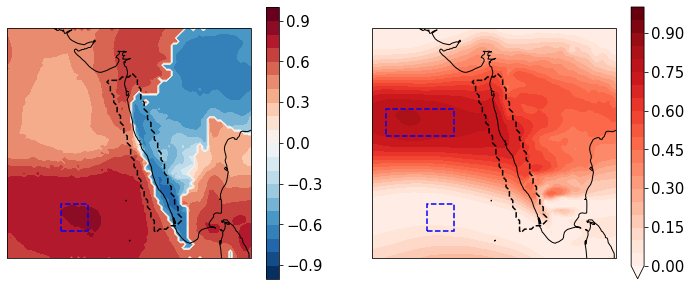

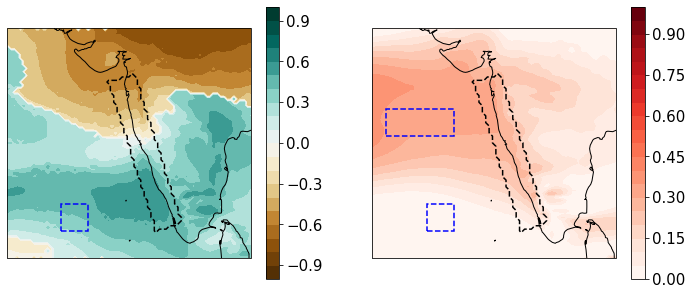

In [211]:
customplot(Ghats,[68,70,9,11],[65,70,16,18])
customplot(Ghats,[68,70,9,11],[65,70,16,18],'Q')
Ghats.box_wind = [65,70,16,18]

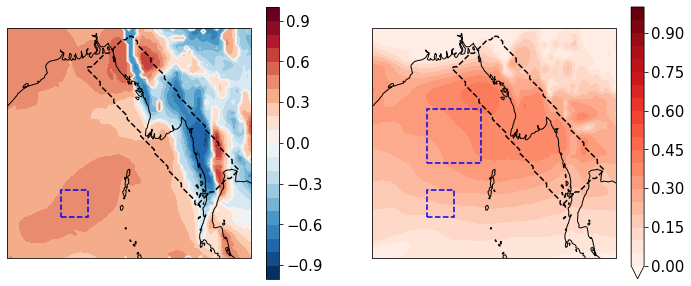

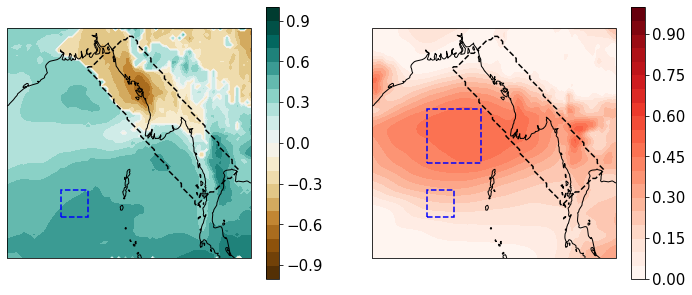

In [212]:
customplot(Myanmar,[88,90,10,12],[88,92,14,18])
customplot(Myanmar,[88,90,10,12],[88,92,14,18],'Q')
Myanmar.box_wind=[88,92,14,18]

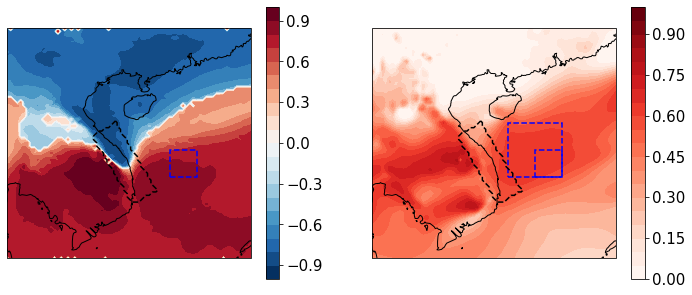

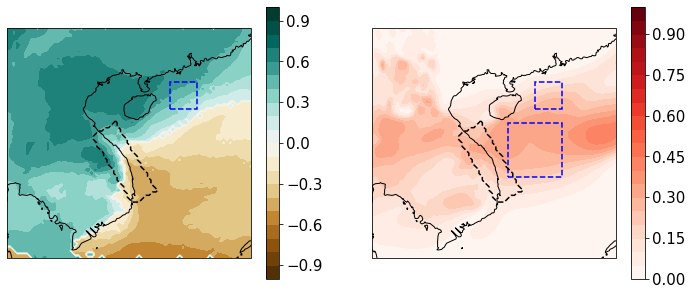

In [213]:
customplot(Vietnam,[112,114,14,16],[110,114,14,18])
customplot(Vietnam,[112,114,19,21],[110,114,14,18],'Q')
Vietnam.box_wind=[110,114,14,18]

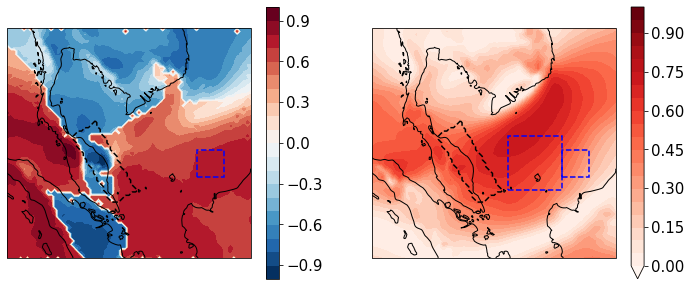

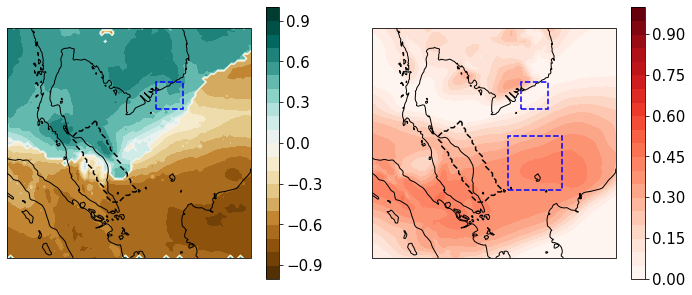

In [214]:
customplot(Malaysia,[110,112,4,6],[106,110,3,7])
customplot(Malaysia,[107,109,9,11],[106,110,3,7],'Q')
Malaysia.box_wind=[106,110,3,7]

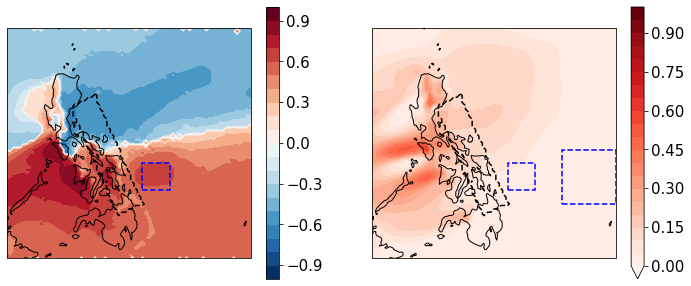

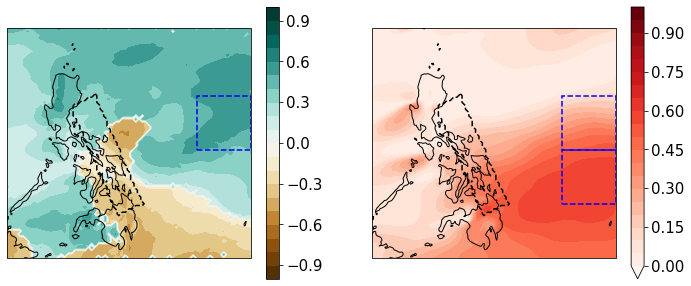

In [215]:
customplot(Philippines,[127,129,10,12],[131,135,9,13])
customplot(Philippines,[131,135,13,17],[131,135,9,13],'Q')
Philippines.box_wind = [131,135,9,13]

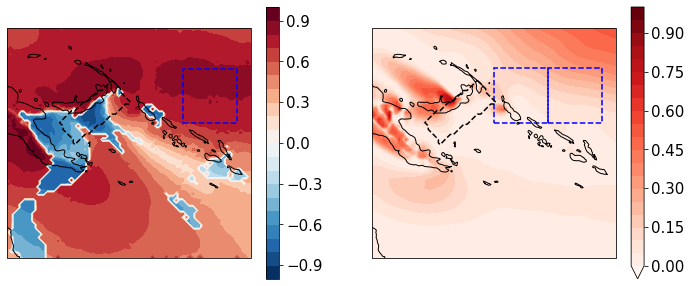

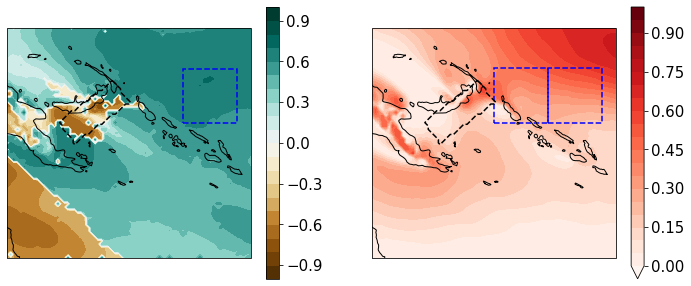

In [216]:
customplot(Newbritain,[158,162,-7,-3],[154,158,-7,-3])
customplot(Newbritain,[158,162,-7,-3],[154,158,-7,-3],'Q')
Newbritain.box_wind=[154,158,-7,-3]

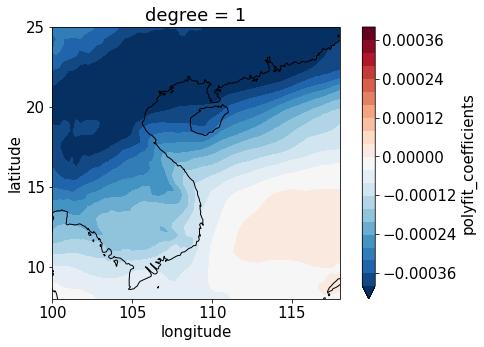

In [139]:
MR = Vietnam
Q_monthly = sel_months(MR.vars['Q_MONTHLY'],MR.months).sel(level=slice(700,900)).mean(['level'])
u = resample_monthly(MR.vars['U900_PERP_DAILY'])
boxwind = [112,114,16,18]
pred = spatial_mean(u.sel(time=(u['time.year']<=2018)),box=boxwind)
reg = Q_monthly.assign_coords({'pred':('time',np.array(pred))}).swap_dims({'time':'pred'}).polyfit('pred',1).polyfit_coefficients.sel(degree=1)

fig,ax = plt.subplots(1,1,figsize=(8,5),subplot_kw={"projection":ccrs.PlateCarree()})
reg.plot.contourf(ax=ax,levels=np.linspace(-4e-4,4e-4,21))
ax.coastlines()
ax.set_xticks(range(100,120,5))
ax.set_yticks(range(10,30,5))

## Precip vs linearized $\Delta B_Ls$

In [36]:
# Evaluating slopes theoretically
alpha = 20.6/3600*2.5e6
dBLdqL = 1/(11.3*3600)*1004*8000/alpha
dBLdTL = -1/(2.7*3600)*1004*8000/alpha
dBLdeb = 1/(11.5*3600)*1004*8000/alpha

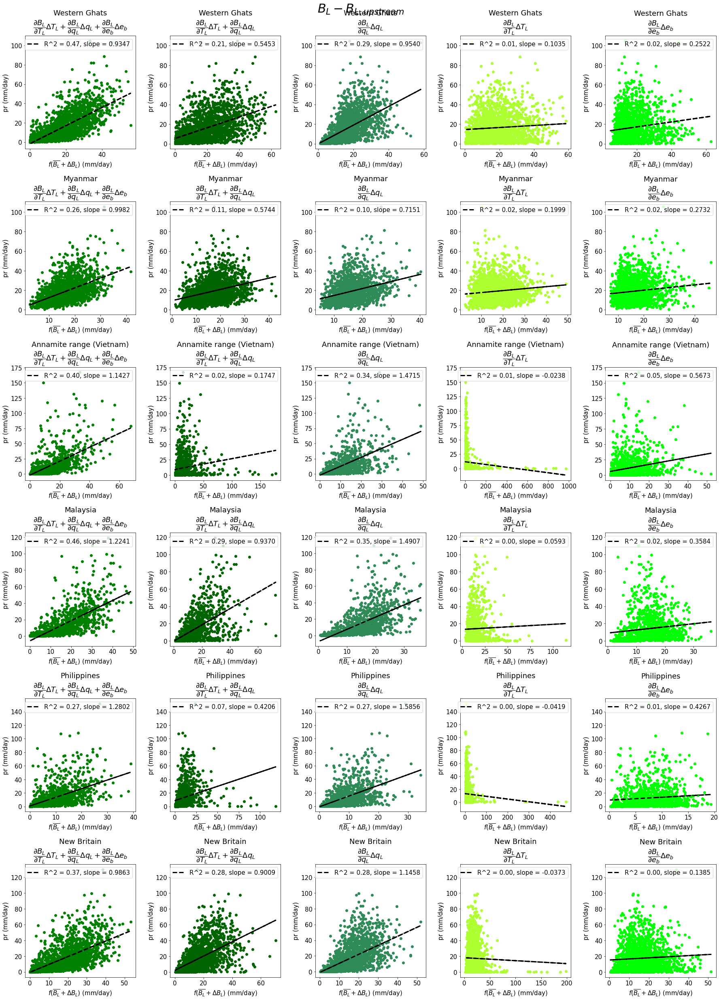

In [45]:
fig,axss = plt.subplots(6,5,figsize=(25,35))
for i,MR in enumerate(MRs):
    axs = axss[i]
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Bl_above = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Bl_rce = Bl_above.mean('time')
    
    predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time'))
    
    for j,(pred,c) in enumerate(zip((predqL+predTL+predeb,predqL+predTL,predqL,predTL,predeb),('g','darkgreen','seagreen','greenyellow','lime'))):
        pred = BL_exp_fit(Bl_rce+pred)
        reg = linregress(pred,pr)
        axs[j].scatter(pred,pr,color=c)
        axs[j].plot(pred,reg.intercept+reg.slope*pred,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(reg.rvalue**2,reg.slope))
        axs[j].set_xlabel("$f(\overline{B_L}+\Delta B_L$) (mm/day)")
        axs[j].set_ylabel(r"pr (mm/day)")
        axs[j].legend()
    axs[0].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L+\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    axs[1].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L+\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
    axs[2].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial q_L}\Delta q_L$")
    axs[3].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial T_L}\Delta T_L$")
    axs[4].set_title(MR.Lname + "\n" + "$\dfrac{\partial B_L}{\partial e_b}\Delta e_b$")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

## Regression maps

In [39]:
from scipy import stats
def linregress_xr(pred,var):
    slope,intercept,rvalue,pvalue,stderr = xr.apply_ufunc(stats.linregress,pred,var,input_core_dims=[['time'],['time']],output_core_dims=[[],[],[],[],[]],vectorize=True)
    return xr.merge((slope.rename('slope'),intercept.rename('intercept'),rvalue.rename('rvalue'),pvalue.rename('pvalue'),stderr.rename('stderr')))

In [40]:
def fdr(pvalues,alpha):
    sortidx = np.argsort(pvalues)
    psorted = pvalues[sortidx]
    nval = len(pvalues)
    ifdr = np.argmin(psorted < alpha*np.arange(1,nval+1)/nval)
    return sortidx[:ifdr]

def fdr_xr_2d(pvalues,alpha):
    pvalues=np.array(pvalues)
    assert len(pvalues.shape)==2
    ntot = pvalues.shape[0]*pvalues.shape[1]
    idxs_1d = fdr(pvalues.reshape(-1),alpha)
    flags = np.zeros(ntot)
    flags[idxs_1d] = 1
    return flags.reshape(pvalues.shape)*pvalues**0

In [41]:
from scipy import special
def linregress_xr_2(x,y):
    nt = len(x.time)
    assert nt==len(y.time)
    ssxm = nt*x.var(dim='time')
    ssym = nt*y.var(dim='time')
    ssxym = nt*xr.cov(x,y,dim='time')
    r = np.maximum(np.minimum(ssxym / np.sqrt(ssxm * ssym),1.),-1)
    slope = ssxym / ssxm
    
    df = nt - 2  # Number of degrees of freedom
    TINY = 1.0e-20
    t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
    
    pval = special.stdtr(df, -np.abs(t))*2 * x.isel(time=0)**0
    
    return xr.merge([slope.rename('slope'),(r**2).rename('rsquared'),pval.rename('pvalue')])

CPU times: user 2.07 s, sys: 387 ms, total: 2.46 s
Wall time: 2.46 s


Text(0.5, 0.98, 'TL_DAILY regressed onto GPM_PR_ABOVE_DAILY')

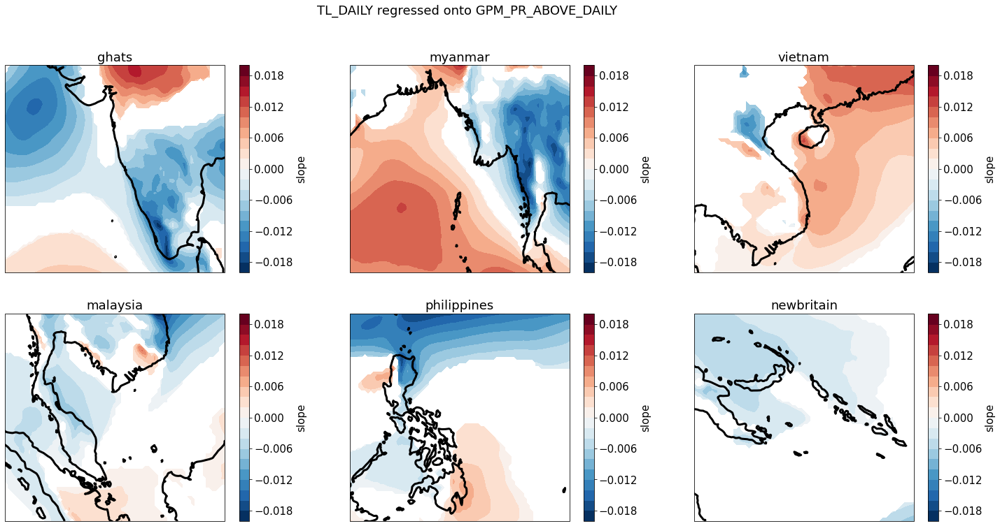

In [171]:
%%time
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'GPM_PR_ABOVE_DAILY'
varname = 'TL_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-0.02,0.02,21)
for (ax,MR) in zip(axs,MRs):
    reg = linregress_xr_2(MR.vars[predname],MR.vars[varname])
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'QL_DAILY regressed onto GPM_PR_ABOVE_DAILY')

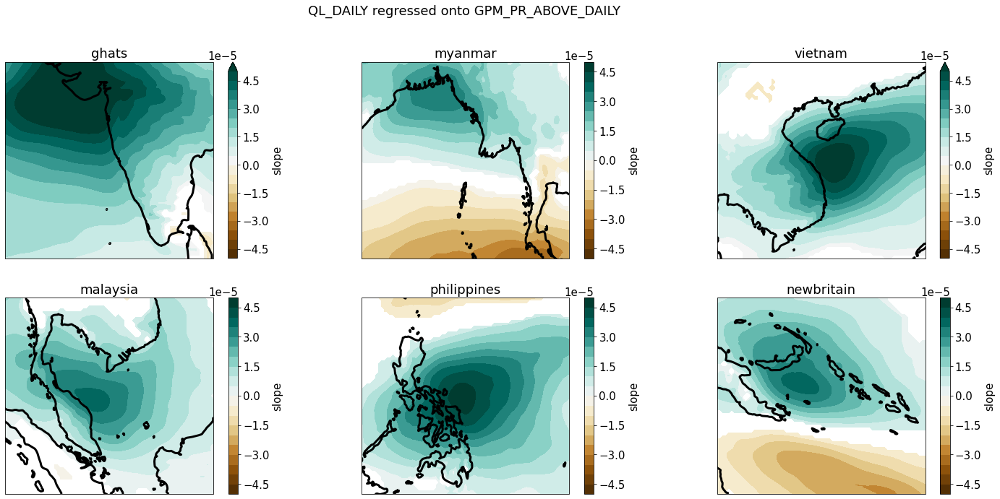

In [172]:
fig,axs = plt.subplots(2,3,figsize=(25,11),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'GPM_PR_ABOVE_DAILY'
varname = 'QL_DAILY'
cm = plt.cm.BrBG
levs = np.linspace(-5e-5,5e-5,21)
for (ax,MR) in zip(axs,MRs):
    reg = linregress_xr_2(MR.vars[predname],MR.vars[varname])
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'EB_DAILY regressed onto GPM_PR_ABOVE_DAILY')

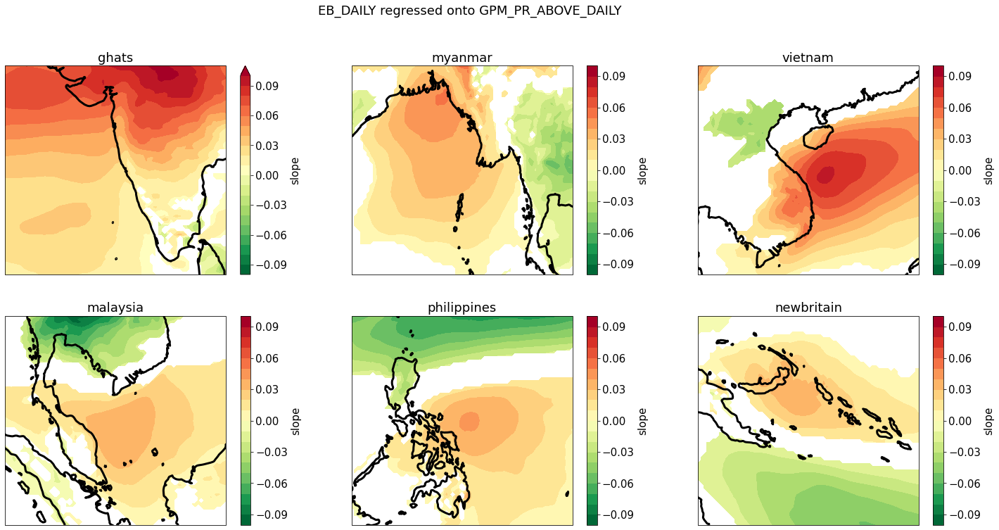

In [173]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'GPM_PR_ABOVE_DAILY'
varname = 'EB_DAILY'
cm = plt.cm.RdYlGn_r
levs = np.linspace(-0.1,0.1,21)
for (ax,MR) in zip(axs,MRs):
    reg = linregress_xr_2(MR.vars[predname],MR.vars[varname])
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'BLSIMPLE_DAILY regressed onto GPM_PR_ABOVE_DAILY')

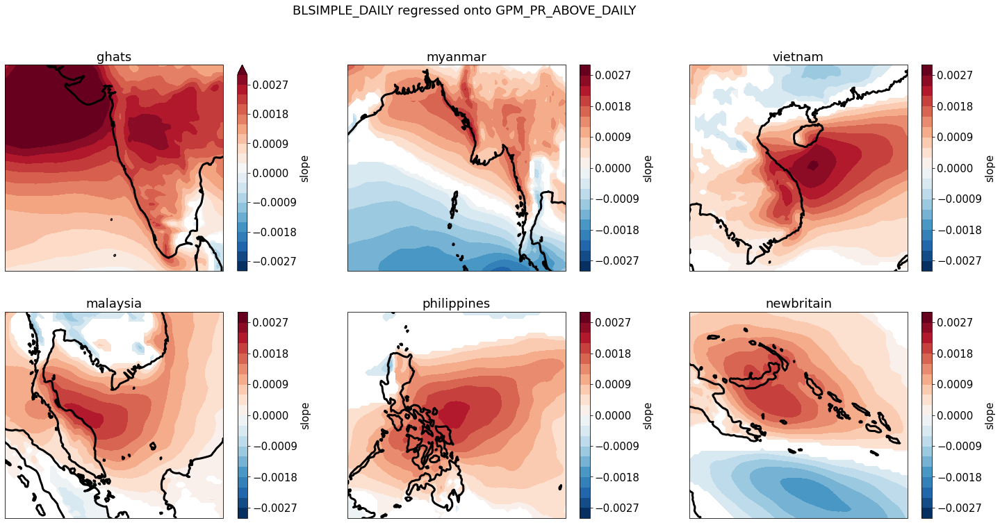

In [174]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'GPM_PR_ABOVE_DAILY'
varname = 'BLSIMPLE_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-3e-3,3e-3,21)
for (ax,MR) in zip(axs,MRs):
    reg = linregress_xr_2(MR.vars[predname],MR.vars[varname])
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
      

Text(0.5, 0.98, 'BLSIMPLE_DAILY regressed onto GPM_PR_ABOVE_DAILY')

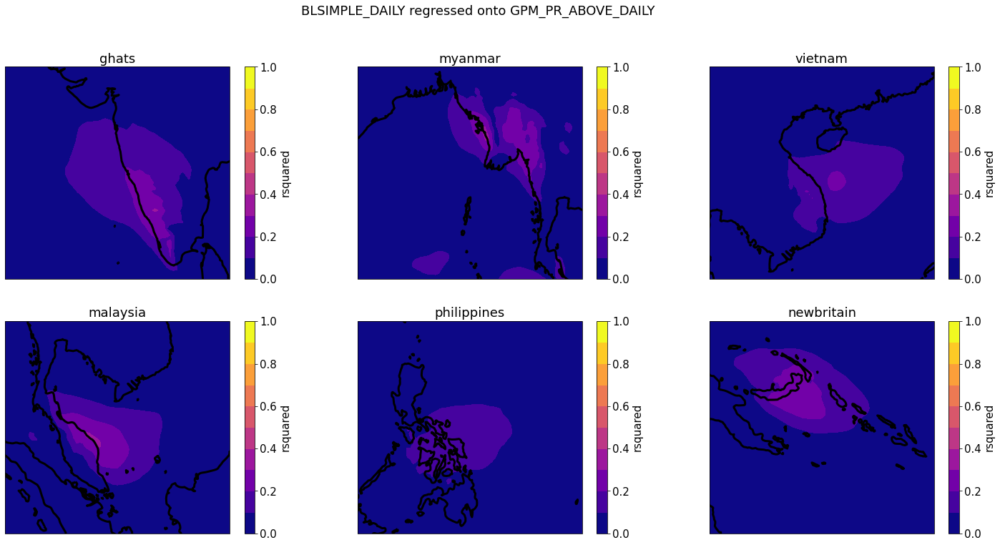

In [42]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'GPM_PR_ABOVE_DAILY'
varname = 'BLSIMPLE_DAILY'
cm = plt.cm.plasma
levs = np.linspace(0,1,11)
for (ax,MR) in zip(axs,MRs):
    rsq = linregress_xr_2(MR.vars[predname],MR.vars[varname]).rsquared
    rsq*=(rsq>=0)
    rsq.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)
    ax.coastlines(linewidth=3)
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
      

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


Text(0.5, 0.98, 'GPM_PR_DAILY regressed onto GPM_PR_ABOVE_DAILY')

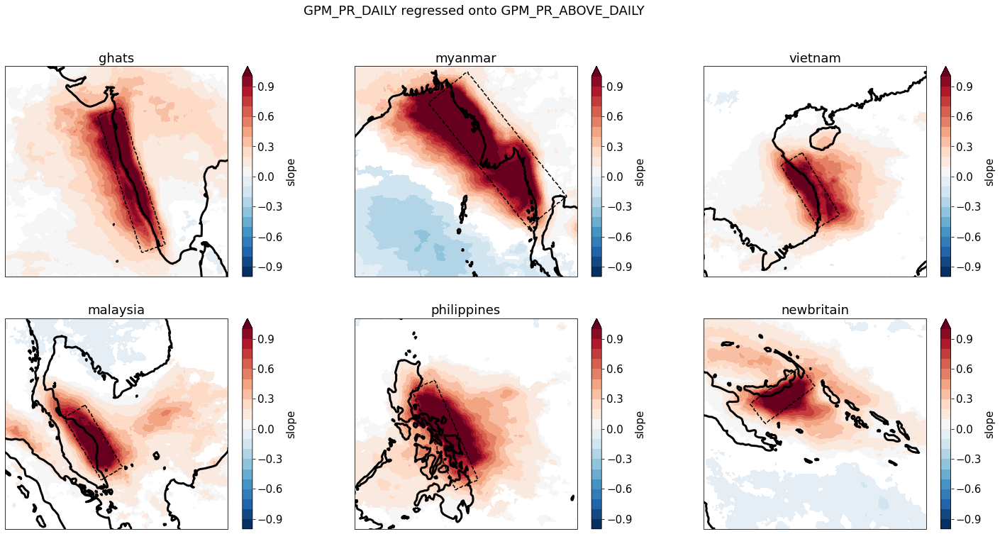

In [175]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'GPM_PR_ABOVE_DAILY'
varname = 'GPM_PR_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-1,1,21)
for (ax,MR) in zip(axs,MRs):
    reg = linregress_xr_2(MR.vars[predname],MR.vars[varname])
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    tilted_rect(reg,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

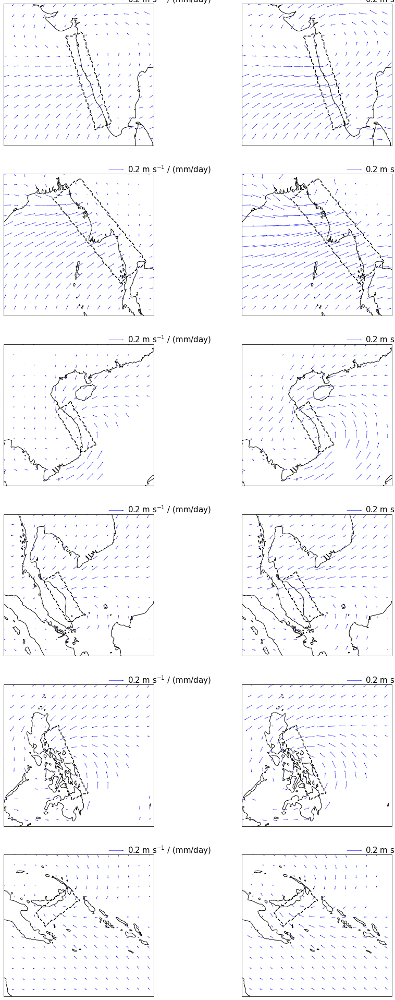

In [177]:
def plot_u_reg(ax,u,v,pr_index):
    reg = linregress_xr_2(pr_index,np.sqrt(u**2+v**2))
    u = u.assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    v = v.assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    
    u = u * 1/(fdr_xr_2d(reg.pvalue,0.1))
    v = v * 1/(fdr_xr_2d(reg.pvalue,0.1))

    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="b",width=0.002,scale=2)
    qk = ax.quiverkey(q, 0.8, 1.03, 0.2, r'0.2 m s$^{-1}$ / (mm/day)', labelpos='E',
                               coordinates='axes',color='b')
    ax.coastlines()
    
fig,axss = plt.subplots(6,2,figsize=(15,35),subplot_kw={"projection":ccrs.PlateCarree()})
for (axs,MR) in zip(axss,MRs):
    plot_u_reg(axs[0],MR.vars['VAR_100U_DAILY'],MR.vars['VAR_100V_DAILY'],MR.vars['GPM_PR_ABOVE_DAILY'])
    plot_u_reg(axs[1],MR.vars['U900_DAILY'],MR.vars['V900_DAILY'],MR.vars['GPM_PR_ABOVE_DAILY'])
    
    axs[0].set_title(MR.name + r'$U_{100m}$')
    axs[1].set_title(MR.name + r'$U_{900hPa}$')
    
    for ax in axs:
        tilted_rect(MR.vars['VAR_100U_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])


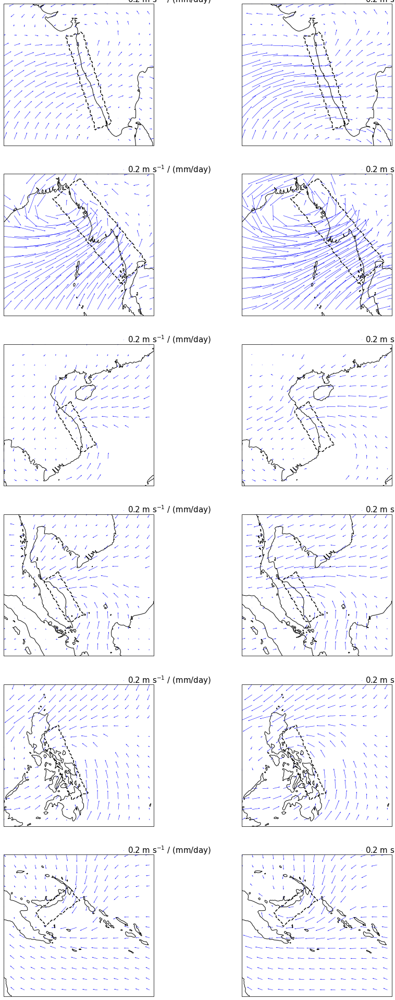

In [178]:
def plot_u_reg(ax,u,v,bl_index):
    reg = linregress_xr_2(bl_index,np.sqrt(u**2+v**2))
    u = u.assign_coords({'pr':('time',np.array(bl_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    v = v.assign_coords({'pr':('time',np.array(bl_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    
    u = u * 1/(fdr_xr_2d(reg.pvalue,0.1))
    v = v * 1/(fdr_xr_2d(reg.pvalue,0.1))

    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="b",width=0.002,scale=400)
    qk = ax.quiverkey(q, 0.8, 1.03, 0.2, r'0.2 m s$^{-1}$ / (mm/day)', labelpos='E',
                               coordinates='axes',color='b')
    ax.coastlines()
    
fig,axss = plt.subplots(6,2,figsize=(15,35),subplot_kw={"projection":ccrs.PlateCarree()})
for (axs,MR) in zip(axss,MRs):
    plot_u_reg(axs[0],MR.vars['VAR_100U_DAILY'],MR.vars['VAR_100V_DAILY'],MR.vars['BLSIMPLE_ABOVE_DAILY'])
    plot_u_reg(axs[1],MR.vars['U900_DAILY'],MR.vars['V900_DAILY'],MR.vars['BLSIMPLE_ABOVE_DAILY'])
    
    axs[0].set_title(MR.name + r'$U_{100m}$')
    axs[1].set_title(MR.name + r'$U_{900hPa}$')
    
    for ax in axs:
        tilted_rect(MR.vars['VAR_100U_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])


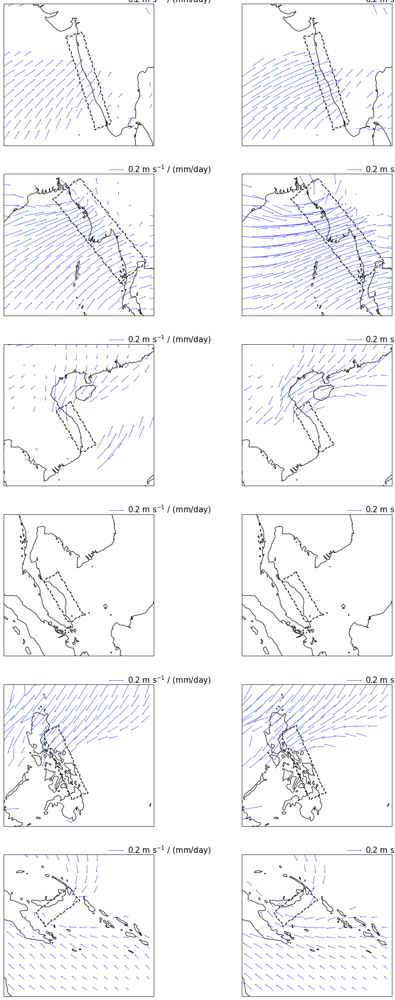

In [179]:
def plot_u_reg(ax,u,v,pr_index):
    u = resample_monthly(u)
    v = resample_monthly(v)
    pr_index = resample_monthly(pr_index)
    reg = linregress_xr_2(pr_index,np.sqrt(u**2+v**2))
    u = u.assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    v = v.assign_coords({'pr':('time',np.array(pr_index))}).swap_dims({'time':'pr'}).polyfit('pr',1).sel(degree=1).polyfit_coefficients
    
    u = u * 1/(fdr_xr_2d(reg.pvalue,0.1))
    v = v * 1/(fdr_xr_2d(reg.pvalue,0.1))

    X = u.latitude.expand_dims({"longitude":u.longitude}).transpose()
    Y = v.longitude.expand_dims({"latitude":u.latitude})
    n=5
    m=5
    q=ax.quiver(np.array(Y)[::n,::m],np.array(X)[::n,::m], np.array(u)[::n,::m], np.array(v)[::n,::m], transform=ccrs.PlateCarree(),color="b",width=0.002,scale=2)
    qk = ax.quiverkey(q, 0.8, 1.03, 0.2, r'0.2 m s$^{-1}$ / (mm/day)', labelpos='E',
                               coordinates='axes',color='b')
    ax.coastlines()
    
fig,axss = plt.subplots(6,2,figsize=(15,35),subplot_kw={"projection":ccrs.PlateCarree()})
for (axs,MR) in zip(axss,MRs):
    plot_u_reg(axs[0],MR.vars['VAR_100U_DAILY'],MR.vars['VAR_100V_DAILY'],MR.vars['GPM_PR_ABOVE_DAILY'])
    plot_u_reg(axs[1],MR.vars['U900_DAILY'],MR.vars['V900_DAILY'],MR.vars['GPM_PR_ABOVE_DAILY'])
    
    axs[0].set_title(MR.name + r'$U_{100m}$')
    axs[1].set_title(MR.name + r'$U_{900hPa}$')
    
    for ax in axs:
        tilted_rect(MR.vars['VAR_100U_DAILY'],*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/xarray/core/computation.py:724: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


Text(0.5, 0.98, 'GPM_PR_DAILY regressed onto U900_PERP_INTERVAL_DAILY')

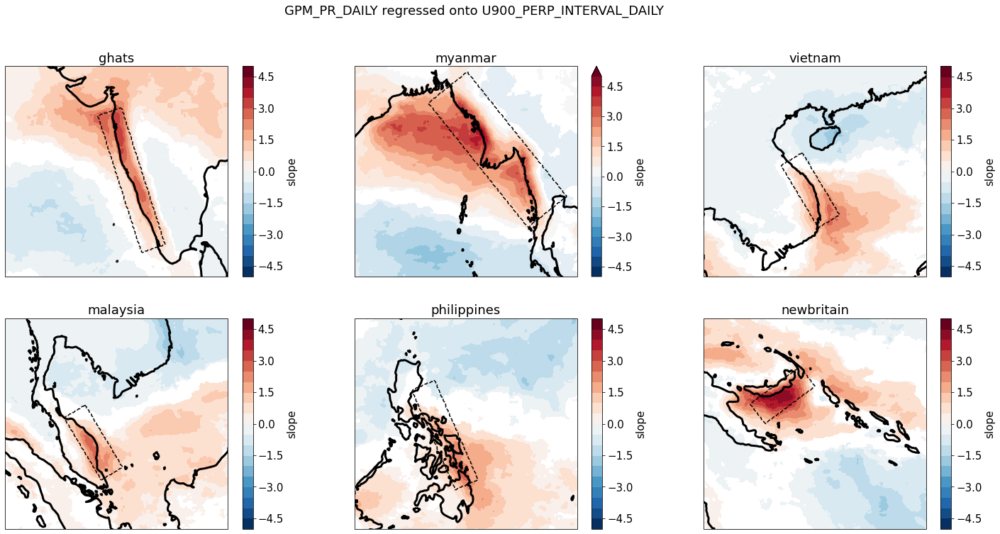

In [180]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'U900_PERP_INTERVAL_DAILY'
varname = 'GPM_PR_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-5,5,21)
for (ax,MR) in zip(axs,MRs):
    reg = linregress_xr_2(MR.vars[predname],MR.vars[varname])
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    tilted_rect(reg,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'BL_LOWERTROP_DAILY regressed onto U900_PERP_INTERVAL_DAILY')

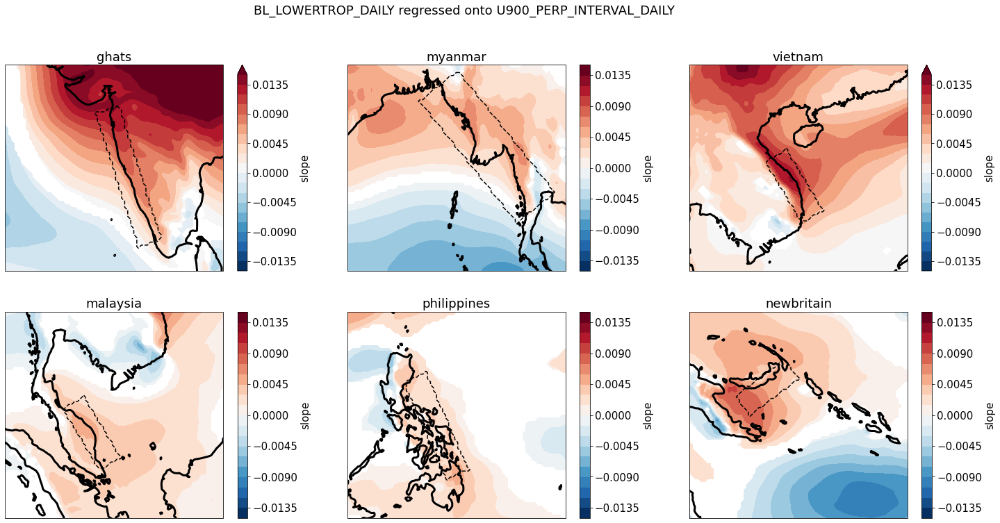

In [183]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'U900_PERP_INTERVAL_DAILY'
varname = 'BL_LOWERTROP_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-0.015,0.015,21)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_DAILY']-MR.vars['QL_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_DAILY']-MR.vars['TL_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_DAILY']-MR.vars['EB_DAILY'].mean('time'))
    var = predqL+predTL
    
    reg = linregress_xr_2(MR.vars[predname],var)
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    tilted_rect(reg,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'BL_LOWERTROP_DAILY regressed onto U900_PERP_INTERVAL_DAILY')

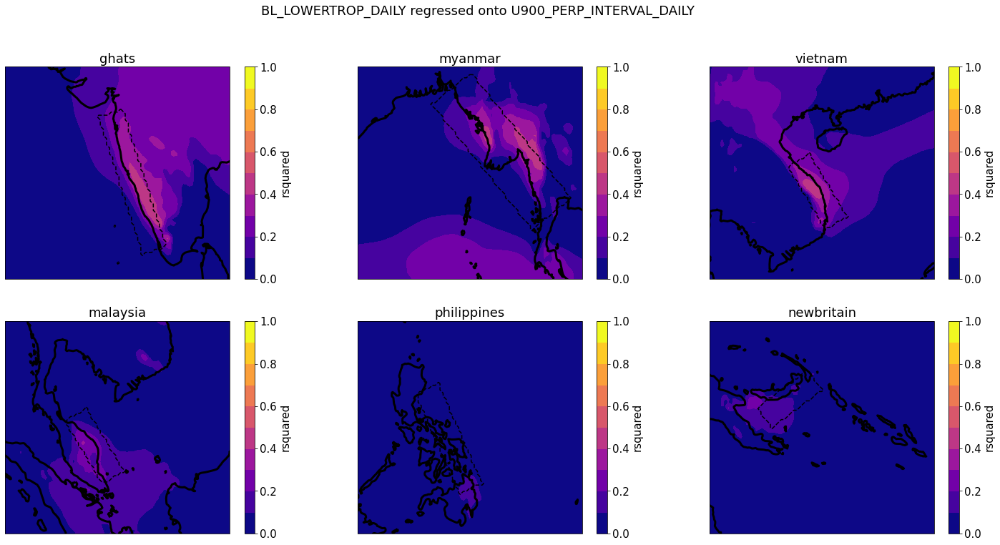

In [184]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'U900_PERP_INTERVAL_DAILY'
varname = 'BL_LOWERTROP_DAILY'
cm = plt.cm.plasma
levs = np.linspace(0,1,11)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_DAILY']-MR.vars['QL_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_DAILY']-MR.vars['TL_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_DAILY']-MR.vars['EB_DAILY'].mean('time'))
    var = predqL+predTL
    
    rsq = linregress_xr_2(MR.vars[predname],var).rsquared
    rsq*=(rsq>=0)
    rsq.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)

    ax.coastlines(linewidth=3)
    tilted_rect(rsq,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'BL_LOWERTROP_DAILY regressed onto U900_PERP_INTERVAL_DAILY')

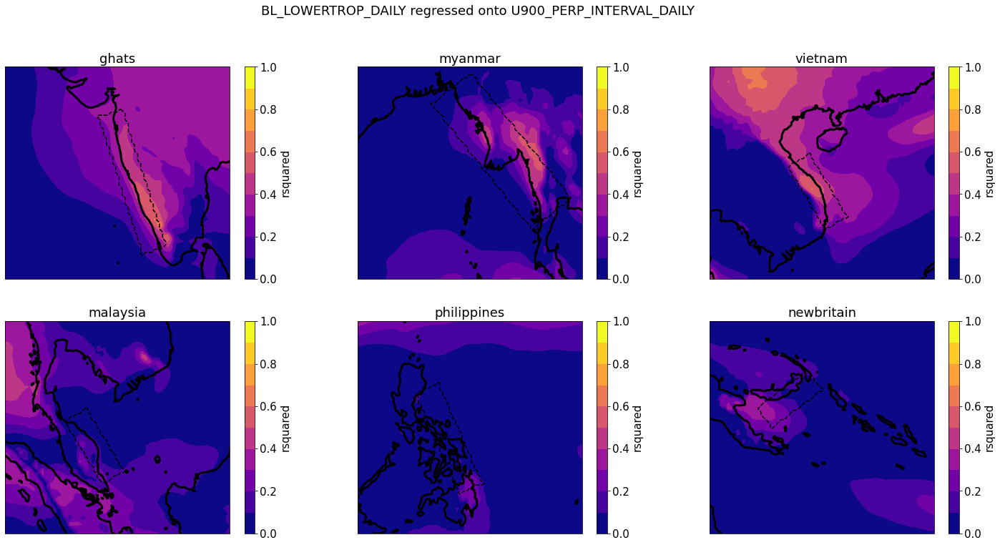

In [221]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'U900_PERP_INTERVAL_DAILY'
varname = 'BL_LOWERTROP_DAILY'
cm = plt.cm.plasma
levs = np.linspace(0,1,11)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_DAILY']-MR.vars['QL_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_DAILY']-MR.vars['TL_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_DAILY']-MR.vars['EB_DAILY'].mean('time'))
    var = predqL+predTL
    
    rsq = linregress_xr_2(resample_monthly(MR.vars[predname]),resample_monthly(var)).rsquared
    rsq*=(rsq>=0)
    rsq.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)

    ax.coastlines(linewidth=3)
    tilted_rect(rsq,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

Text(0.5, 0.98, 'BL_LOWERTROP_DAILY regressed onto VAR_100U_PERP_INTERVAL_DAILY')

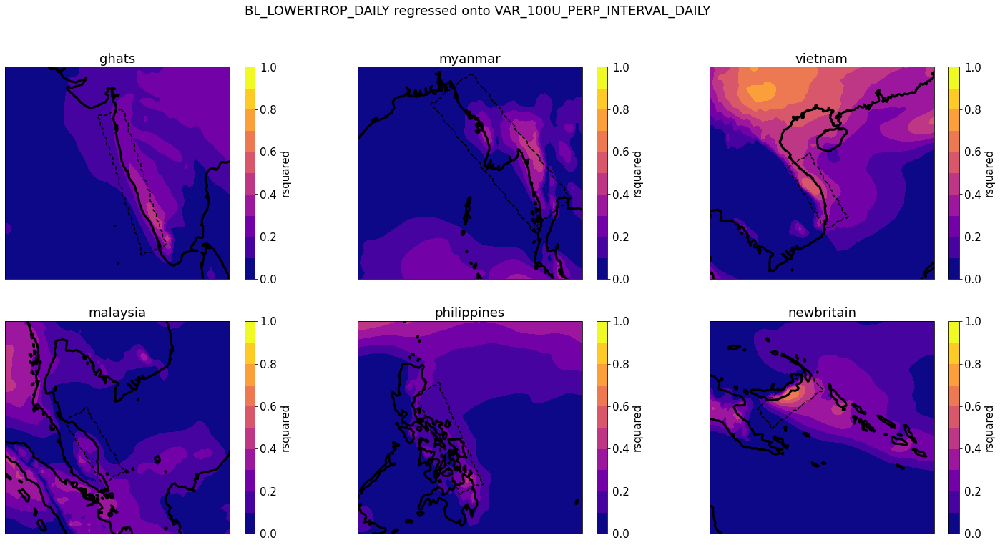

In [ ]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'VAR_100U_PERP_INTERVAL_DAILY'
varname = 'BL_LOWERTROP_DAILY'
cm = plt.cm.plasma
levs = np.linspace(0,1,11)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_DAILY']-MR.vars['QL_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_DAILY']-MR.vars['TL_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_DAILY']-MR.vars['EB_DAILY'].mean('time'))
    var = predqL+predTL
    
    rsq = linregress_xr_2(resample_monthly(MR.vars[predname]),resample_monthly(var)).rsquared
    rsq*=(rsq>=0)
    rsq.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)

    ax.coastlines(linewidth=3)
    tilted_rect(rsq,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

## Precip predictor with wind & $\theta_{eb}$

In [87]:
Ghats.box_wind = [68,71,14,16]
Myanmar.box_wind=[91,94,12,15]
Vietnam.box_wind=[111,114,17,20]
Malaysia.box_wind=[103,105,6,8]
Philippines.box_wind = [123,126,17,19]
Newbritain.box_wind=[150,153,-10,-8]

def plot_box(ax,box):
    ax.add_patch(mpatches.Rectangle(xy=[box[0], box[2]], width=box[1]-box[0], height=box[3]-box[2],
                                   edgecolor='b',
                                   fill = False,
                                   lw=1.5,
                                   linestyle='--',
                                   transform=ccrs.PlateCarree()))
    


Text(0.5, 0.98, 'VAR_100U_PERP_DAILY regressed onto BL_LOWERTROP_DAILY')

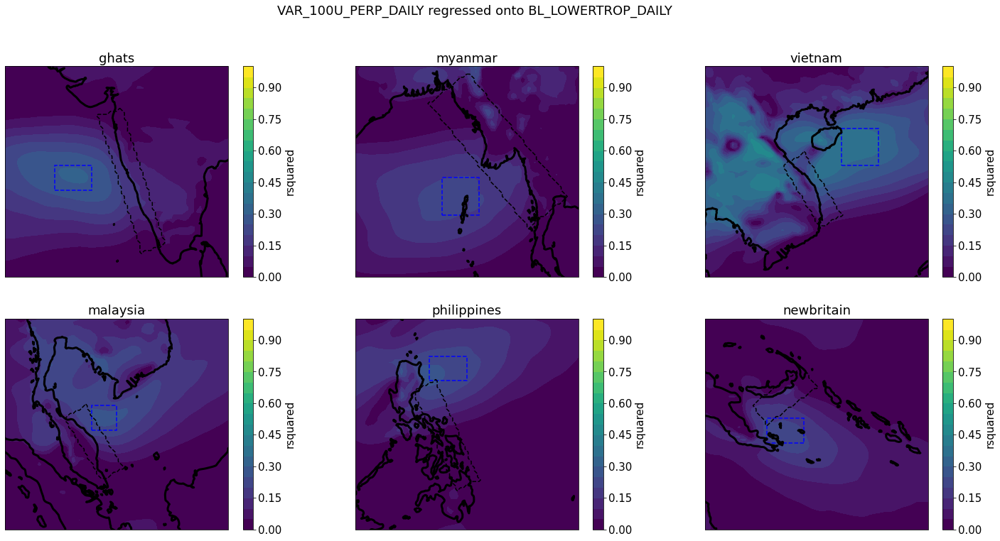

In [82]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'BL_LOWERTROP_DAILY'
varname = 'VAR_100U_PERP_DAILY'
cm = plt.cm.viridis
levs = np.linspace(0,1,21)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
    pred = predqL+predTL
    
    var = MR.vars[varname]
    
    rsq = linregress_xr_2(pred,var).rsquared
    rsq*=(rsq>=0)
    rsq.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)

    ax.coastlines(linewidth=3)
    tilted_rect(rsq,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
    plot_box(ax,MR.box_wind)
fig.suptitle(varname + ' regressed onto ' + predname)
     

[ 0.00863208 -0.09180494]
[ 0.00415109 -0.03564528]
[ 0.01114112 -0.09528587]
[ 0.00629507 -0.0339887 ]
[ 0.00571228 -0.04927439]
[ 0.00783843 -0.06118956]


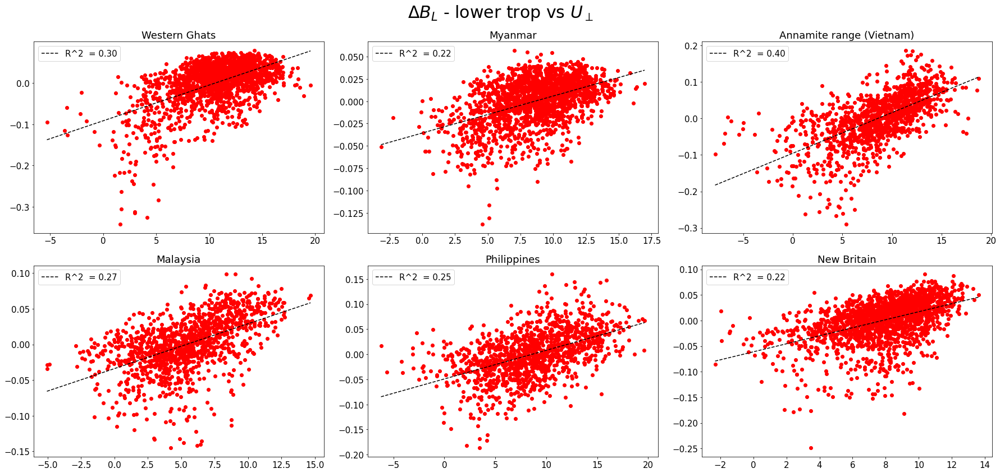

In [126]:
fig,axs = plt.subplots(2,3,figsize=(25,12))
axs=axs.reshape(-1)
for i,MR in enumerate(MRs):
    predqL = dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time'))
    wind = sel_box(MR.vars['VAR_100U_PERP_DAILY'],MR.box_wind).mean(('latitude','longitude'))
    
    axs[i].scatter(wind,predqL+predTL,color='r')
    x,y,rsq,popt = fit_coefs(np.array(wind),np.array(predqL+predTL),'linear')
    MR.linear_coefs_windBL = popt
    axs[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    axs[i].set_title(MR.Lname)
    axs[i].legend()
    print(popt)
    
fig.suptitle(r"$\Delta B_L$ - lower trop vs $U_\perp$",fontsize=30)
fig.tight_layout()

In [115]:
# Evaluating slopes theoretically
alpha = 20.6/3600*2.5e6
dBLdqL = 1/(11.3*3600)*1004*8000/alpha
dBLdTL = -1/(2.7*3600)*1004*8000/alpha
dBLdeb = 1/(11.5*3600)*1004*8000/alpha

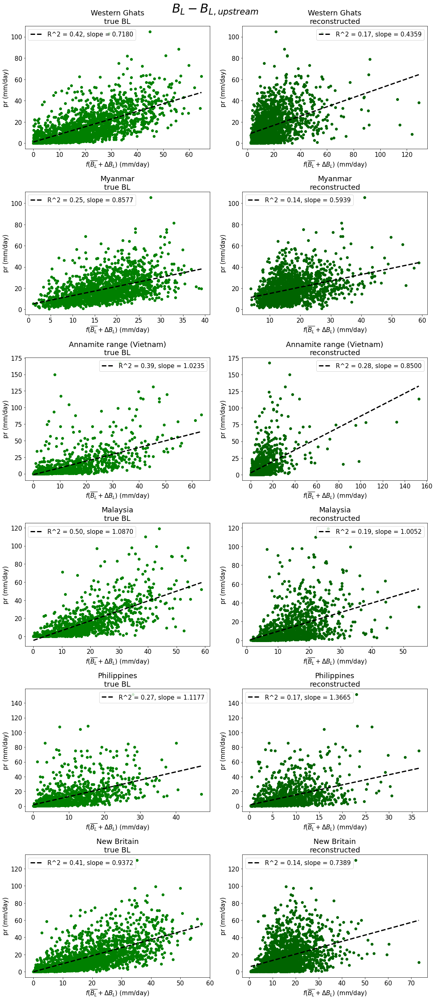

In [129]:
fig,axss = plt.subplots(6,2,figsize=(15,35))
for i,MR in enumerate(MRs):
    axs = axss[i]
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Bl_above = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Bl_rce = Bl_above.mean('time')
    
    wind = sel_box(MR.vars['VAR_100U_PERP_DAILY'],MR.box_wind).mean(('latitude','longitude'))
    predL=MR.linear_coefs_windBL[0]*wind + MR.linear_coefs_windBL[1]
    predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time'))
    
    for j,(pred1,c) in enumerate(zip((Bl_above-Bl_rce,predL+predeb),('g','darkgreen'))):
        pred = BL_exp_fit(Bl_rce+pred1)
        x,y,rsq,popt = fit_coefs(np.array(pred),np.array(pr),'linear')
        axs[j].scatter(pred,pr,color=c)
        axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,popt[0]))
        axs[j].set_xlabel("$f(\overline{B_L}+\Delta B_L$) (mm/day)")
        axs[j].set_ylabel(r"pr (mm/day)")
        axs[j].legend()
    axs[0].set_title(MR.Lname + "\n" + "true BL")
    axs[1].set_title(MR.Lname + "\n" + "reconstructed")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

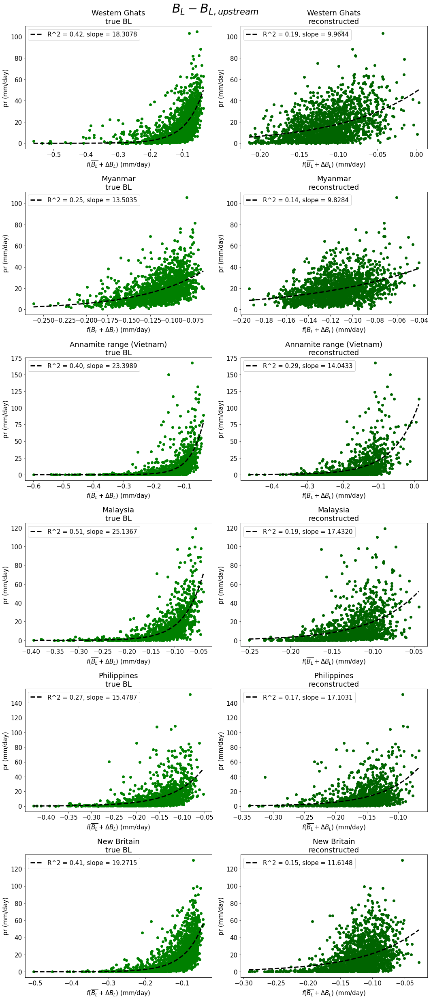

In [130]:
fig,axss = plt.subplots(6,2,figsize=(15,35))
for i,MR in enumerate(MRs):
    axs = axss[i]
    pr = MR.vars['GPM_PR_ABOVE_DAILY']
    Bl_above = MR.vars['BLSIMPLE_ABOVE_DAILY']
    Bl_rce = Bl_above.mean('time')
    
    wind = sel_box(MR.vars['VAR_100U_PERP_DAILY'],MR.box_wind).mean(('latitude','longitude'))
    predL=MR.linear_coefs_windBL[0]*wind + MR.linear_coefs_windBL[1]
    predeb = dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time'))
    
    for j,(pred1,c) in enumerate(zip((Bl_above-Bl_rce,predL+predeb),('g','darkgreen'))):
        pred = Bl_rce+pred1
        x,y,rsq,popt = fit_coefs(np.array(pred),np.array(pr),'exponential')
        axs[j].scatter(pred,pr,color=c)
        axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,popt[0]))
        axs[j].set_xlabel("$f(\overline{B_L}+\Delta B_L$) (mm/day)")
        axs[j].set_ylabel(r"pr (mm/day)")
        axs[j].legend()
    axs[0].set_title(MR.Lname + "\n" + "true BL")
    axs[1].set_title(MR.Lname + "\n" + "reconstructed")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

## $B_L$ regressed onto $dq/dz$ / $N$

In [ ]:
Newbritain.set_3dvar('PHI',"128_129_z")
sample_geopotential = Newbritain.vars['PHI'].mean(['latitude','longitude'])/9.81
dzdp = sample_geopotential.differentiate('level')

for MR in MRs:
    dqdp = MR.vars['Q_UPSTREAM_DAILY'].differentiate('level')
    dqdz_K = 2.5e6/1004. * dqdp/dzdp
    dqdz_K = dqdz_K.sel(level=slice(700,900)).mean('level')
    MR.vars['DQDZ_UPSTREAM_DAILY'] = dqdz_K
    
    dTdp = MR.vars['T_UPSTREAM_DAILY'].differentiate('level')
    dsdz = dTdp/dzdp + 9.81/1004.
    dsdz = dsdz.sel(level=slice(700,900)).mean('level')
    MR.vars['DSDZ_UPSTREAM_DAILY'] = dsdz

Computing PHI ...


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas

Text(0.5, 0.98, 'BL_LOWERTROP_DAILY regressed onto DQDZ_UPSTREAM_DAILY')

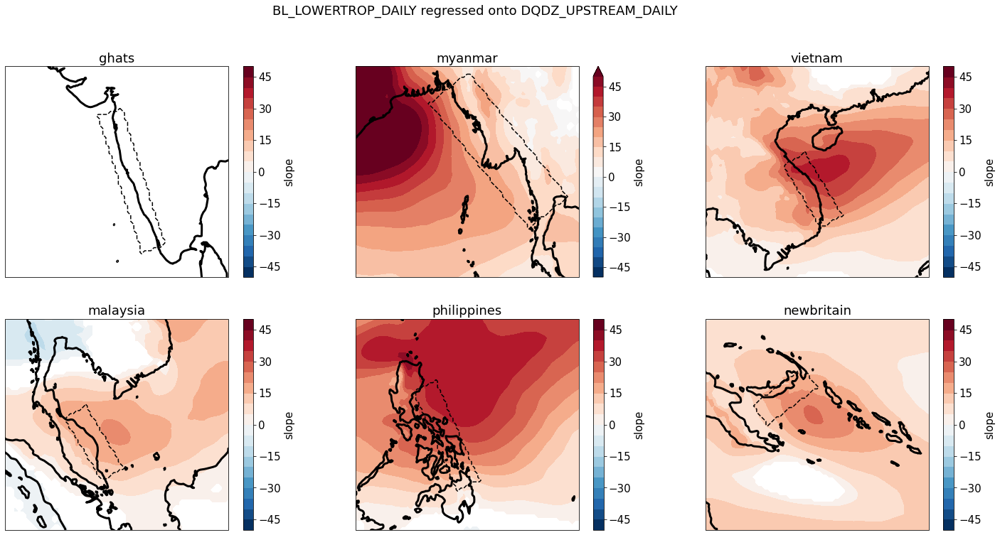

In [237]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'DQDZ_UPSTREAM_DAILY'
varname = 'BL_LOWERTROP_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-50,50,21)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_DAILY']-MR.vars['QL_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_DAILY']-MR.vars['TL_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_DAILY']-MR.vars['EB_DAILY'].mean('time'))
    var = predqL+predTL
    
    reg = linregress_xr_2(MR.vars[predname],var)
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    tilted_rect(reg,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a 

Text(0.5, 0.98, 'BL_LOWERTROP_DAILY regressed onto DSDZ_UPSTREAM_DAILY')

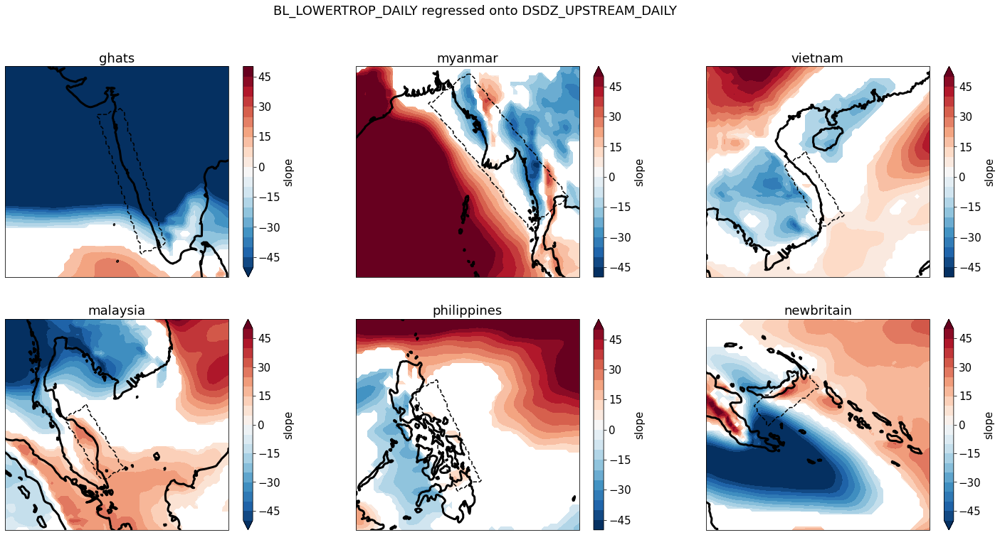

In [239]:
fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={"projection":ccrs.PlateCarree()})
axs=axs.reshape(-1)
predname = 'DSDZ_UPSTREAM_DAILY'
varname = 'BL_LOWERTROP_DAILY'
cm = plt.cm.RdBu_r
levs = np.linspace(-50,50,21)
for (ax,MR) in zip(axs,MRs):
    predqL = dBLdqL*(MR.vars['QL_DAILY']-MR.vars['QL_DAILY'].mean('time'))*2.5e6/1004. 
    predTL = dBLdTL*(MR.vars['TL_DAILY']-MR.vars['TL_DAILY'].mean('time'))
    predeb = dBLdeb*(MR.vars['EB_DAILY']-MR.vars['EB_DAILY'].mean('time'))
    var = predqL+predTL
    
    reg = linregress_xr_2(MR.vars[predname],var)
    plot = reg.slope * 1/(fdr_xr_2d(reg.pvalue,0.1))
    plot.transpose('latitude','longitude').plot.contourf(ax=ax,cmap=cm,levels=levs)
    
    ax.coastlines(linewidth=3)
    tilted_rect(reg,*MR.box_tilted).plot.contour(ax=ax,levels=[0.5],linestyles=['--'],colors=['k'])
    ax.set_title(MR.name)
fig.suptitle(varname + ' regressed onto ' + predname)
     

## Precip CDFs

In [57]:
def plot_cdf(pr,ax,lbl=None):
    pctiles=100*np.concatenate([(1-10.**(-i+1))+10.**(-i)*np.arange(1,10,1) for i in range(1,4)])
    pctages = [float((100*pr.where(pr>float(pr.quantile(pctile/100,"time"))).sum()/pr.sum())) for pctile in pctiles]
    ax.plot(pctiles/100,pctages,'-x',label=lbl)
    ax.legend()
    ax.set_xscale('logit')
    ax.set_xticks([0.1,0.5,0.9,0.99,0.999])
    ax.set_xticklabels([0.1,0.5,0.9,0.99,0.999])  
    ax.set_title("Cumulative fraction of total precipitation by percentile",fontsize=20)
    ax.set_xlabel("Percentile")
    ax.set_ylabel("Precip fraction")
    ax.grid()

CPU times: user 418 ms, sys: 419 µs, total: 419 ms
Wall time: 417 ms


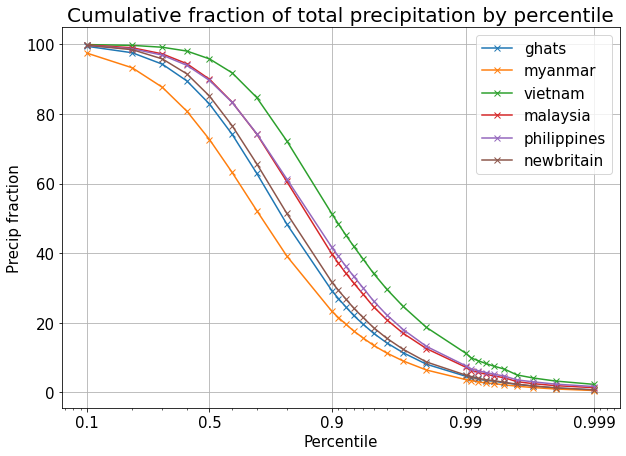

In [59]:
%%time
fig,ax=plt.subplots(1,1,figsize=(10,7))

for MR in MRs:
    plot_cdf(MR.vars['GPM_PR_ABOVE_DAILY'],ax,MR.name)
#plot_cdf(mtnprecip.isel(Time=slice(200,800)).load(),ax,'6-hourly')
#plot_cdf(hourlymtnprecip.isel(Time=slice(1200,4800)).load(),ax,'hourly')

ax.grid()

# Monthly time scales

## SST, $\theta_e$ Variations

Text(0, 0.5, '$\\theta_{eL}^*$')

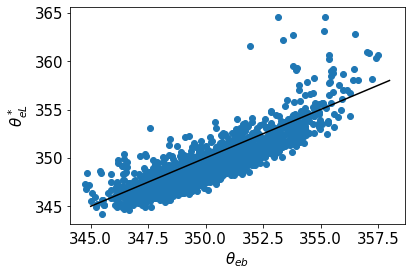

In [52]:
MR = Ghats
mask = tilted_rect(MR.vars['THETAEB_DAILY'],*MR.box_tilted,reverse=False)
thetaeb_timeseries = spatial_mean(MR.vars['THETAEB_DAILY'],box=None,mask=mask)
thetaeLstar_timeseries = spatial_mean(MR.vars['THETAELSTAR_DAILY'],box=None,mask=mask)
plt.scatter(thetaeb_timeseries,thetaeLstar_timeseries)
plt.plot([345,358],[345,358],color='k')
plt.xlabel(r'$\theta_{eb}$');plt.ylabel(r'$\theta_{eL}^*$')

Text(0, 0.5, '$\\theta_{eL}^*$')

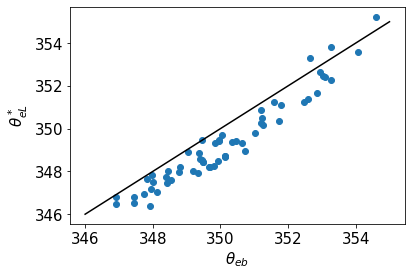

In [53]:
MR = Ghats
mask = tilted_rect(MR.vars['THETAEB_DAILY'],*MR.box_tilted,reverse=False)
thetaeb_timeseries = resample_monthly(spatial_mean(MR.vars['THETAEB_DAILY'],box=None,mask=mask))
thetaeLstar_timeseries = resample_monthly(spatial_mean(MR.vars['THETAELSTAR_DAILY'],box=None,mask=mask))
plt.scatter(thetaeb_timeseries,thetaeLstar_timeseries)
plt.plot([346,355],[346,355],color='k')
plt.xlabel(r'$\theta_{eb}$');plt.ylabel(r'$\theta_{eL}^*$')

Text(0, 0.5, '$\\theta_{eL}^*$')

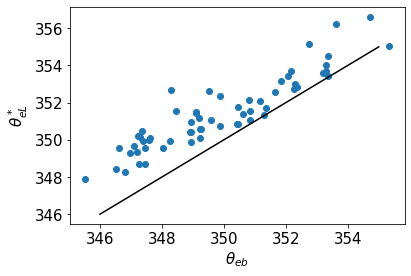

In [72]:
MR = Ghats
thetaeb_timeseries = resample_monthly(spatial_mean(MR.vars['THETAEB_DAILY'],box=MR.box_rce,mask=None))
thetaeLstar_timeseries = resample_monthly(spatial_mean(MR.vars['THETAELSTAR_DAILY'],box=MR.box_rce,mask=None))
plt.scatter(thetaeb_timeseries,thetaeLstar_timeseries)
plt.plot([346,355],[346,355],color='k')
plt.xlabel(r'$\theta_{eb}$');plt.ylabel(r'$\theta_{eL}^*$')

Text(0, 0.5, '$\\theta_{eb}$')

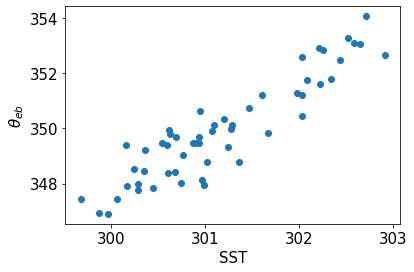

In [55]:
MR = Ghats
mask = tilted_rect(MR.vars['THETAEB_DAILY'],*MR.box_tilted,reverse=False)
thetaeb_timeseries = resample_monthly(spatial_mean(MR.vars['THETAEB_DAILY'],box=None,mask=mask))
thetaeb_timeseries=thetaeb_timeseries.sel(time=((thetaeb_timeseries['time.year']<=2018)))
sst_timeseries = spatial_mean(MR.vars['SST_3D'],box=None,mask=mask)
sst_timeseries=sst_timeseries.sel(time=((sst_timeseries['time.month']>=6)&(sst_timeseries['time.month']<=8)))
plt.scatter(sst_timeseries,thetaeb_timeseries)
plt.xlabel(r'SST');plt.ylabel(r'$\theta_{eb}$')

Text(0, 0.5, '$\\theta_{eL}^*$')

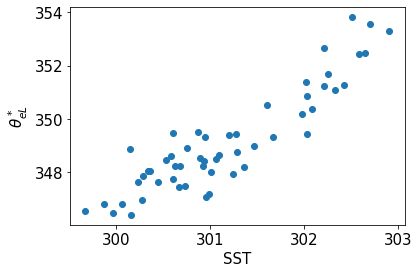

In [56]:
MR = Ghats
mask = tilted_rect(MR.vars['THETAEB_DAILY'],*MR.box_tilted,reverse=False)
thetaeLstar_timeseries = resample_monthly(spatial_mean(MR.vars['THETAELSTAR_DAILY'],box=None,mask=mask))
thetaeLstar_timeseries=thetaeLstar_timeseries.sel(time=((thetaeLstar_timeseries['time.year']<=2018)))
sst_timeseries = spatial_mean(MR.vars['SST_3D'],box=None,mask=mask)
sst_timeseries=sst_timeseries.sel(time=((sst_timeseries['time.month']>=6)&(sst_timeseries['time.month']<=8)))
plt.scatter(sst_timeseries,thetaeLstar_timeseries)
plt.xlabel(r'SST');plt.ylabel(r'$\theta_{eL}^*$')

Text(0, 0.5, '$\\theta_{eL}^*$')

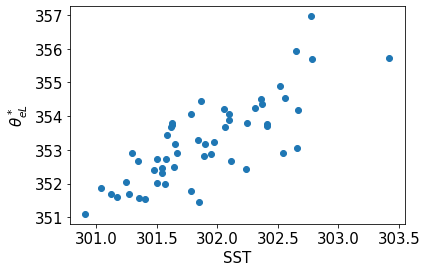

In [57]:
MR = Myanmar
mask = tilted_rect(MR.vars['THETAEB_DAILY'],*MR.box_tilted,reverse=False)
thetaeLstar_timeseries = resample_monthly(spatial_mean(MR.vars['THETAELSTAR_DAILY'],box=None,mask=mask))
thetaeLstar_timeseries=thetaeLstar_timeseries.sel(time=((thetaeLstar_timeseries['time.year']<=2018)))
sst_timeseries = spatial_mean(MR.vars['SST_3D'],box=None,mask=mask)
sst_timeseries=sst_timeseries.sel(time=((sst_timeseries['time.month']>=6)&(sst_timeseries['time.month']<=8)))
plt.scatter(sst_timeseries,thetaeLstar_timeseries)
plt.xlabel(r'SST');plt.ylabel(r'$\theta_{eL}^*$')

Text(0, 0.5, '$\\theta_{eL}^*$')

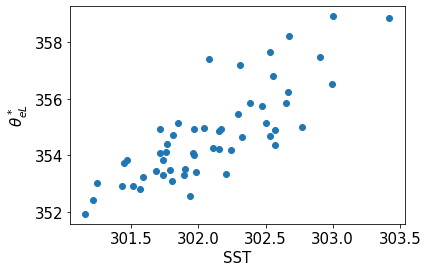

In [58]:
MR = Myanmar
mask = tilted_rect(MR.vars['THETAEB_DAILY'],*MR.box_tilted,reverse=True)
thetaeLstar_timeseries = resample_monthly(spatial_mean(MR.vars['THETAELSTAR_DAILY'],box=None,mask=mask))
thetaeLstar_timeseries=thetaeLstar_timeseries.sel(time=((thetaeLstar_timeseries['time.year']<=2018)))
sst_timeseries = spatial_mean(MR.vars['SST_3D'],box=None,mask=mask)
sst_timeseries=sst_timeseries.sel(time=((sst_timeseries['time.month']>=6)&(sst_timeseries['time.month']<=8)))
plt.scatter(sst_timeseries,thetaeLstar_timeseries)
plt.xlabel(r'SST');plt.ylabel(r'$\theta_{eL}^*$')

## Scatterplots

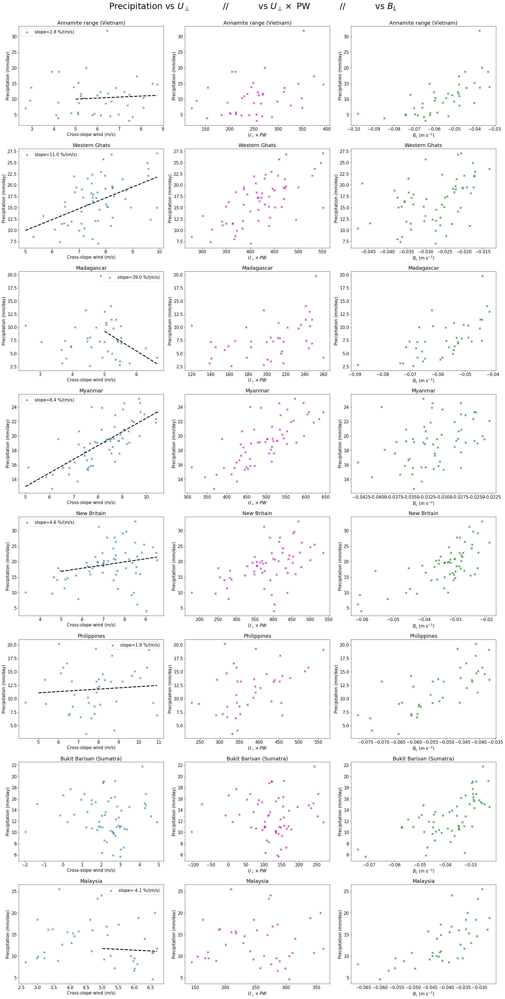

In [58]:
fig,ax = plt.subplots(8,3,figsize=(25,50))
for j,MR in enumerate(MRs):
    pr = resample_monthly(MR.vars['GPM_PR_ABOVE_DAILY'])
    crossslopeu = resample_monthly(MR.vars['VAR_100U_PERP_UPSTREAM_DAILY'])
    Bl = resample_monthly(MR.vars['BL_ABOVE_DAILY'])
    PW = resample_monthly(MR.vars['TCWV_UPSTREAM_DAILY'])

    if np.sum(crossslopeu>5)>=3:
        reg = linregress(crossslopeu[crossslopeu>5],pr[crossslopeu>5])
        uu = np.linspace(5,max(crossslopeu),10)
        ax[j,0].scatter(crossslopeu,pr,marker='x',label=r'slope=%.1f %%/(m/s)'%(100*((11*reg.slope+reg.intercept)/(10*reg.slope+reg.intercept)-1)))
        ax[j,0].plot(uu,reg.intercept+uu*reg.slope,linestyle='--',linewidth=3.,color='k')
        ax[j,0].legend()
    else:
        ax[j,0].scatter(crossslopeu,pr,marker='x')
    ax[j,0].set_xlabel("Cross-slope wind (m/s)")
    ax[j,0].set_ylabel("Precipitation (mm/day)")
    
    ax[j,0].set_title(MR.Lname)
    
    ax[j,1].scatter(crossslopeu*PW,pr,marker='x',color='m')
    ax[j,1].set_xlabel(r"$U_\perp \times PW$")
    ax[j,1].set_ylabel("Precipitation (mm/day)")
    ax[j,1].set_title(MR.Lname)
    
    ax[j,2].scatter(Bl,pr,color='g',marker='x')
    ax[j,2].set_xlabel(r"$B_L$ (m s$^{-2}$)")
    ax[j,2].set_ylabel("Precipitation (mm/day)")
    ax[j,2].set_title(MR.Lname)
       
fig.suptitle(r"Precipitation vs $U_\perp$            //           vs $U_\perp \times$ PW           //           vs $B_L$",fontsize=30)
fig.tight_layout(rect=[0, 0, 1, 0.98])

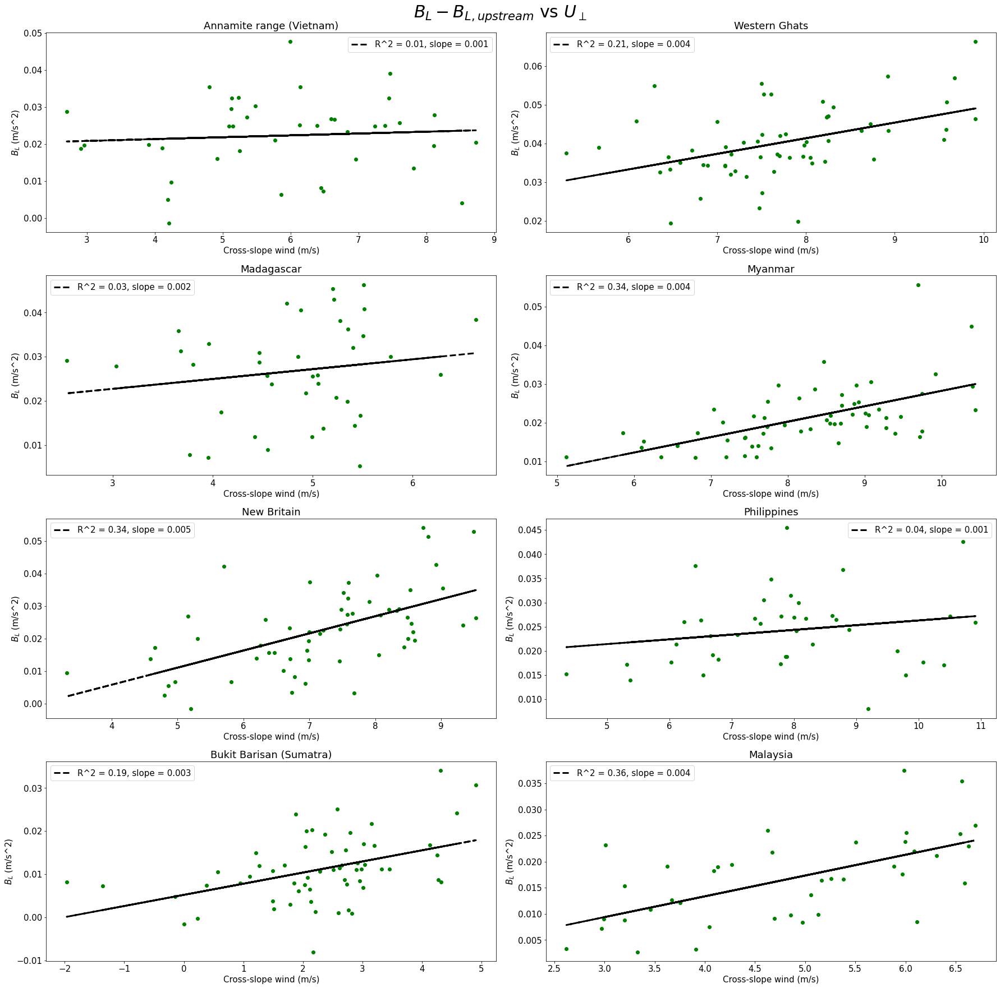

In [12]:
fig,ax = plt.subplots(4,2,figsize=(25,25))
ax = ax.reshape(-1)
ubins = np.arange(-10,20,1)
for j,MR in enumerate(MRs):
    Bl_above = resample_monthly(MR.vars['BL_ABOVE_DAILY'])
    Bl_rce = resample_monthly(MR.vars['BL_RCE_DAILY'])
    crossslopeu =resample_monthly( MR.vars['VAR_100U_PERP_UPSTREAM_DAILY'])
    

    ax[j].scatter(crossslopeu,Bl_above-Bl_rce,color='g')
    reg = linregress(crossslopeu,Bl_above-Bl_rce)
    ax[j].plot(crossslopeu,reg.intercept+reg.slope*crossslopeu,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.3f'%(reg.rvalue**2,reg.slope))
    ax[j].set_xlabel("Cross-slope wind (m/s)")
    ax[j].set_ylabel(r"$B_L$ (m/s^2)")
    ax[j].set_title(MR.Lname)
    ax[j].legend()
fig.suptitle(r"$B_L-B_{L,upstream}$ vs $U_\perp$",fontsize=30)
fig.tight_layout()

In [16]:
gpm_pr_monthly = xr.open_dataarray('/global/cscratch1/sd/qnicolas/temp/GPM-IMERG.monthly.2001-2018.nc')    
era5100u_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.228_246_100u.2001-2018.nc")
era5100v_monthly=xr.open_dataarray("/global/cscratch1/sd/qnicolas/temp/e5.monthly.228_247_100v.2001-2018.nc")

In [17]:
box = [68,80,7.5,17]  
angle = 80
precipitating_month = 7
mountaintop=900. # abscissa of mountain top within rotated frame

box_tilted = [ 75  ,   9  ,  72.5, 16   ,2  ]
box_ref_rce = [68, 69, 11, 14]#[68,69,12,17]            # Small, integer boxes to better assess mtn wave
box_ref_closeupstream = [72,74,11,15]  # Small, integer boxes to better assess mtn wave

Ghats = MountainRange('ghats',box,"Western Ghats",angle,precipitating_month,mountaintop)
Ghats.set_boxes(box_ref_rce,box_ref_closeupstream,box_tilted)

Ghats.set_othervar('VAR_100U_3D',sel_box(era5100u_monthly,Ghats.box))
Ghats.set_othervar('VAR_100V_3D',sel_box(era5100v_monthly,Ghats.box))
Ghats.vars['VAR_100U_3D_PERP'] = crossslopeflow(Ghats.vars['VAR_100U_3D'], Ghats.vars['VAR_100V_3D'],Ghats.angle)

Ghats.set_4dvar('T4D',"128_130_t")
Ghats.set_4dvar('Q4D',"128_133_q")
Ghats.set_othervar('GPM_PR_3D',sel_box(gpm_pr_monthly,Ghats.box))


In [55]:
%%time
mask = 1.*tilted_rect(Ghats.vars['GPM_PR_3D'][0],*Ghats.box_tilted)
mask_era5 = 1.*tilted_rect(Ghats.vars['T4D'][0],*Ghats.box_tilted)

BL_allmonths_box       = BL_plevs(Ghats.vars['T4D'],Ghats.vars['Q4D'],700.).where(mask_era5).mean(['latitude','longitude'])
gpm_pr_allmonths_box   = Ghats.vars['GPM_PR_3D'].where(mask).mean(['latitude','longitude']).load()
uperp100_allmonths_box = Ghats.vars['VAR_100U_3D_PERP'].where(mask_era5).mean(['latitude','longitude']).load()

box_tilted2 = [ 71  ,   9  ,  69.5, 14   ,2  ]
mask_era5 = mask.interp_like(Ghats.vars['T4D'][0])
BL_allmonths_boxups         = BL_plevs(Ghats.vars['T4D'],Ghats.vars['Q4D'],700.).where(mask_era5).mean(['latitude','longitude'])


/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/pint/numpy_func.py:289: RuntimeWarning: invalid value encountered in log
  result_magnitude = func(*stripped_args, **stripped_kwargs)
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/pint/quantity.py:1393: RuntimeWarning: invalid value encountered in power
  return other ** new_self._magnitude
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/metpy/calc/thermo.py:1067: RuntimeWarning: overflow encountered in exp
  th_es = th_l * np.exp((3036. / t - 1.78) * r * (1 + 0.448 * r))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/metpy/calc/thermo.py:1067: RuntimeWarning: overflow encountered in multiply
  th_es = th_l * np.exp((3036. / t - 1.78) * r * (1 + 0.448 * r))
/global/homes/q/qnicolas/.conda/envs/era5/lib/python3.7/site-packages/pint/numpy_func.py:289: RuntimeWarning: invalid value encountered in log
  result_magnitude = func(*stripped_args, **stripped

CPU times: user 16 s, sys: 9.76 s, total: 25.7 s
Wall time: 25.7 s


In [25]:
def sel_month(ds,m):
    return ds.sel(time=(ds['time.month']==m))

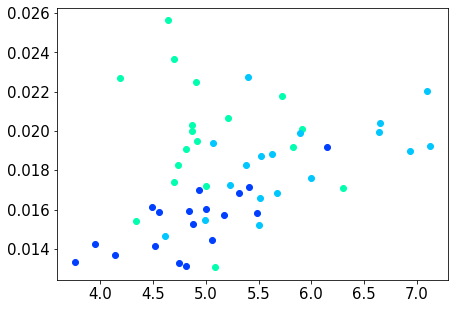

In [57]:
fig,ax = plt.subplots(1,1,figsize=(7,5))
colors=plt.cm.hsv(np.linspace(0,1,12))
for m in range(5,8):
    ax.scatter(sel_month(uperp100_allmonths_box,m+1),sel_month(BL_allmonths_box-BL_allmonths_boxups,m+1),color=colors[m],label=m+1)

## Maps

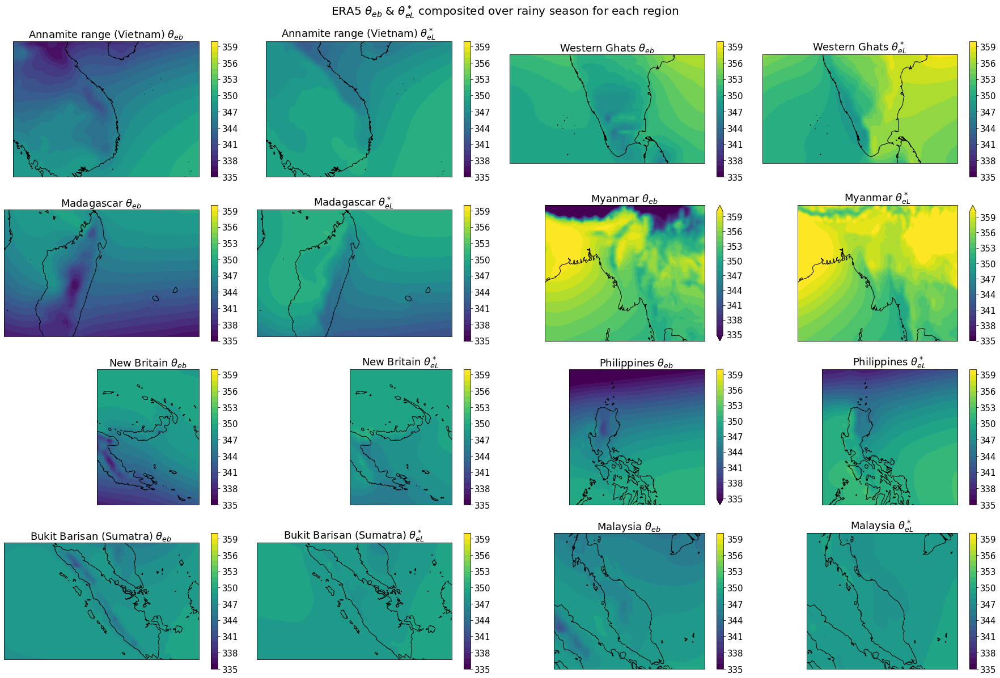

In [48]:
fig,ax = plt.subplots(4,4,figsize=(25,17),subplot_kw={"projection":ccrs.PlateCarree()})
ax = ax.reshape((8,2))
commonlevs= np.arange(335,360.1,1)
for i,MR in enumerate(MRs):
    ax[i,0].coastlines();ax[i,1].coastlines()
    MR.vars['THETAEB_DAILY'].mean('time').plot.contourf(ax=ax[i,0],levels=commonlevs,transform=ccrs.PlateCarree())
    ax[i,0].set_title(MR.Lname +r' $\theta_{eb}$ ')
    MR.vars['THETAELSTAR_DAILY'].mean('time').plot.contourf(ax=ax[i,1],levels=commonlevs,transform=ccrs.PlateCarree())
    ax[i,1].set_title(MR.Lname +r' $\theta_{eL}^*$ ')

fig.tight_layout(rect=[0, 0, 1.0, 0.95])
fig.suptitle(r"ERA5 $\theta_{eb}$ & $\theta_{eL}^*$ composited over rainy season for each region",fontsize=20);None

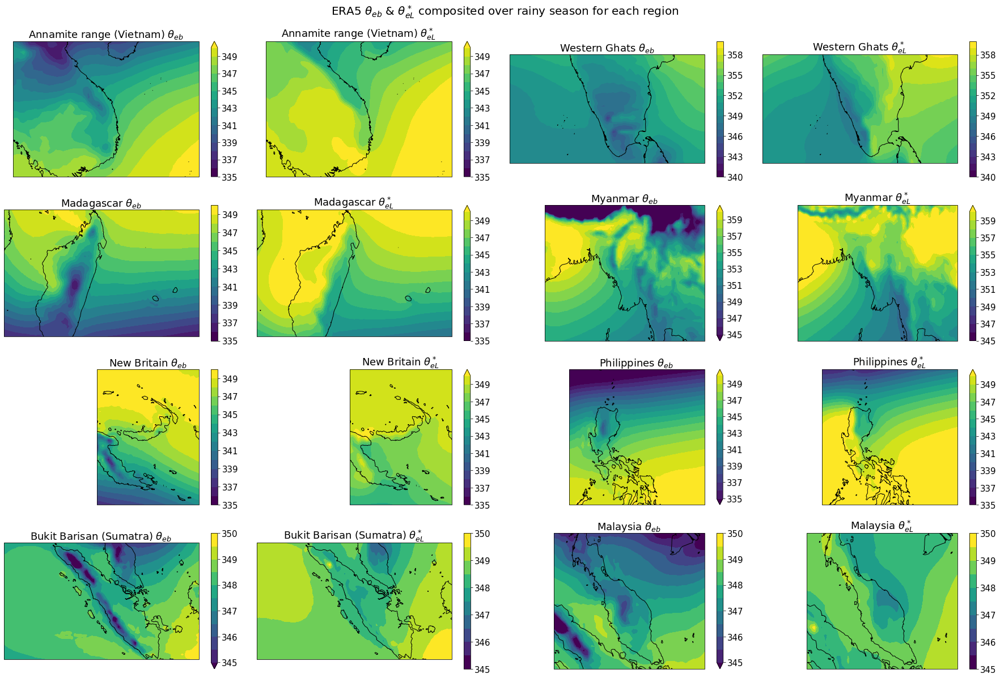

In [55]:
#SAME AS ABOVE WITH TARGETED LEVELS FOR EACH REGION
fig,ax = plt.subplots(4,4,figsize=(25,17),subplot_kw={"projection":ccrs.PlateCarree()})
ax = ax.reshape((8,2))
alllevs=[np.arange(335,350.1,1),
         np.arange(340,360.1,1),
         np.arange(335,350.1,1),
         np.arange(345,360.1,1),
         np.arange(335,350.1,1),
         np.arange(335,350.1,1),
         np.arange(345,350.1,0.5),
         np.arange(345,350.1,0.5),
         ]

for i,MR in enumerate(MRs):
    ax[i,0].coastlines();ax[i,1].coastlines()
    MR.vars['THETAEB_DAILY'].mean('time').plot.contourf(ax=ax[i,0],levels=alllevs[i],transform=ccrs.PlateCarree())
    ax[i,0].set_title(MR.Lname +r' $\theta_{eb}$ ')
    MR.vars['THETAELSTAR_DAILY'].mean('time').plot.contourf(ax=ax[i,1],levels=alllevs[i],transform=ccrs.PlateCarree())
    ax[i,1].set_title(MR.Lname +r' $\theta_{eL}^*$ ')

fig.tight_layout(rect=[0, 0, 1.0, 0.95])
fig.suptitle(r"ERA5 $\theta_{eb}$ & $\theta_{eL}^*$ composited over rainy season for each region",fontsize=20);None

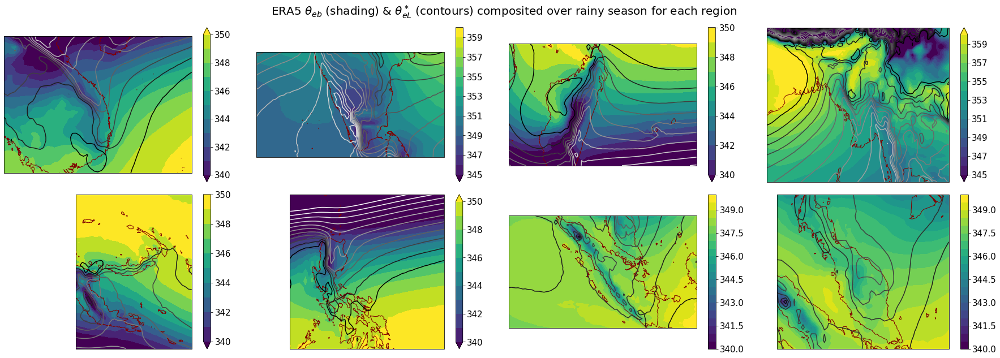

In [62]:
fig,axs = plt.subplots(2,4,figsize=(25,9),subplot_kw={"projection":ccrs.PlateCarree()})
axs = axs.reshape(-1)
alllevs=[np.arange(340,350.1,1.),
         np.arange(345,360.1,1.),
         np.arange(340,350.1,1.),
         np.arange(345,360.1,1.),
         np.arange(340,350.1,1.),
         np.arange(340,350.1,1.),
         np.arange(340,350.1,0.5),
         np.arange(340,350.1,0.5),
         ]
for i,MR in enumerate(MRs):
    ax=axs[i]
    ax.coastlines(color='maroon')
    MR.vars['THETAEB_DAILY'].mean('time').plot.contourf(ax=ax,levels=alllevs[i],transform=ccrs.PlateCarree())
    ax.set_title(MR.Lname)
    MR.vars['THETAELSTAR_DAILY'].mean('time').plot.contour(ax=ax,levels=alllevs[i],cmap=plt.cm.Greys,transform=ccrs.PlateCarree())
    
fig.tight_layout(rect=[0, 0, 1.0, 0.95])
fig.suptitle(r"ERA5 $\theta_{eb}$ (shading) & $\theta_{eL}^*$ (contours) composited over rainy season for each region",fontsize=20);None

## Precip predictor

CPU times: user 2.22 s, sys: 287 ms, total: 2.5 s
Wall time: 2.53 s


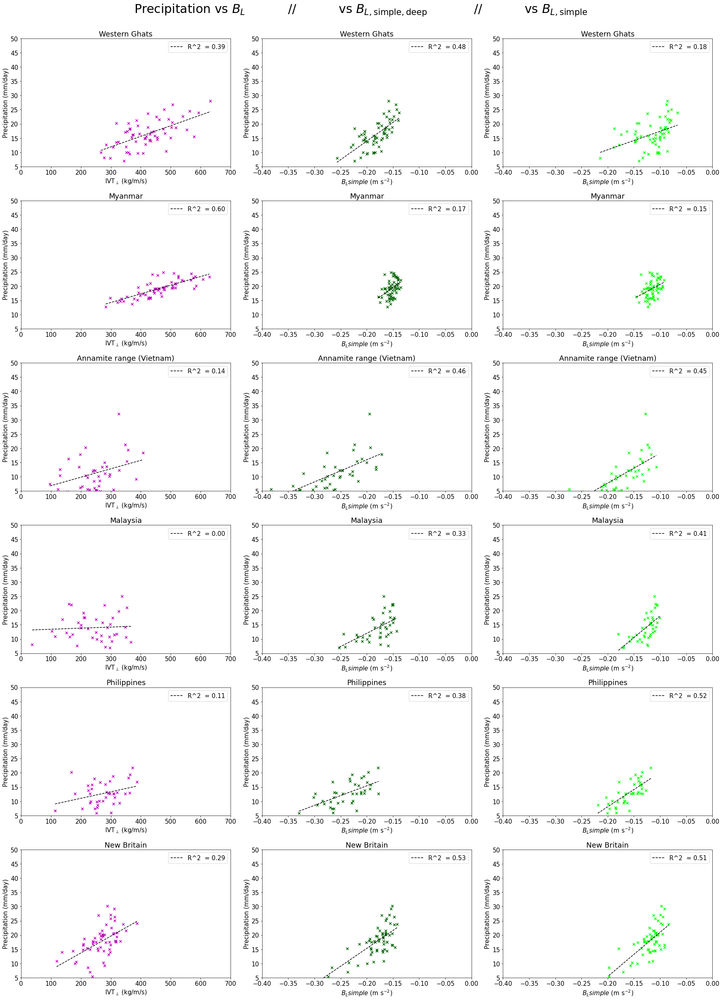

In [11]:
%%time
fig,axs = plt.subplots(6,3,figsize=(25,35))
for j,MR in enumerate(MRs):
    pr           = resample_monthly(MR.vars['GPM_PR_ABOVE_DAILY'])
    viwvperp     = resample_monthly(MR.vars['VIWV_PERP_UPSTREAM_DAILY'])
    Blsimple     = resample_monthly(MR.vars['BLSIMPLE_ABOVE_DAILY'])
    Blsimpledeep = resample_monthly(MR.vars['BLDEEPSIMPLE_ABOVE_DAILY'])
    
    for i,(pred,c,model) in enumerate(zip((viwvperp,Blsimpledeep,Blsimple),('m','darkgreen','lime'),('linear','linear','linear'))):
        axs[j,i].scatter(pred,pr,marker='x',color=c)
        x,y,rsq = fit(pred,pr,model)
        axs[j,i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
        axs[j,i].set_ylabel("Precipitation (mm/day)")
        axs[j,i].set_title(MR.Lname)
        axs[j,i].legend()
        axs[j,i].set_ylim(5,50)
    axs[j,0].set_xlabel(r"IVT$_\perp$ (kg/m/s)")
    axs[j,1].set_xlabel(r"$B_Lsimple$ (m s$^{-2}$)")
    axs[j,2].set_xlabel(r"$B_Lsimple$ (m s$^{-2}$)")
    axs[j,0].set_xlim(0,700)
    axs[j,1].set_xlim(-0.4,0)
    axs[j,2].set_xlim(-0.4,0)

       
fig.suptitle(r"Precipitation vs $B_L$           //           vs $B_{L,\mathrm{simple,deep}}$            //           vs $B_{L,\mathrm{simple}}$",fontsize=30)
fig.tight_layout(rect=[0, 0, 1, 0.98])

In [24]:
# Evaluating slopes theoretically
alpha = 20.6/3600*2.5e6
dBLdqL = 1/(11.3*3600)*1004*8000/alpha
dBLdTL = -1/(2.7*3600)*1004*8000/alpha
dBLdeb = 1/(11.5*3600)*1004*8000/alpha

[ 0.01334477 -0.14222118]
[ 0.00416115 -0.03589363]
[ 0.01304149 -0.11159282]
[ 0.00323957 -0.01750138]
[ 0.00998748 -0.08621578]
[ 0.00931302 -0.07273613]


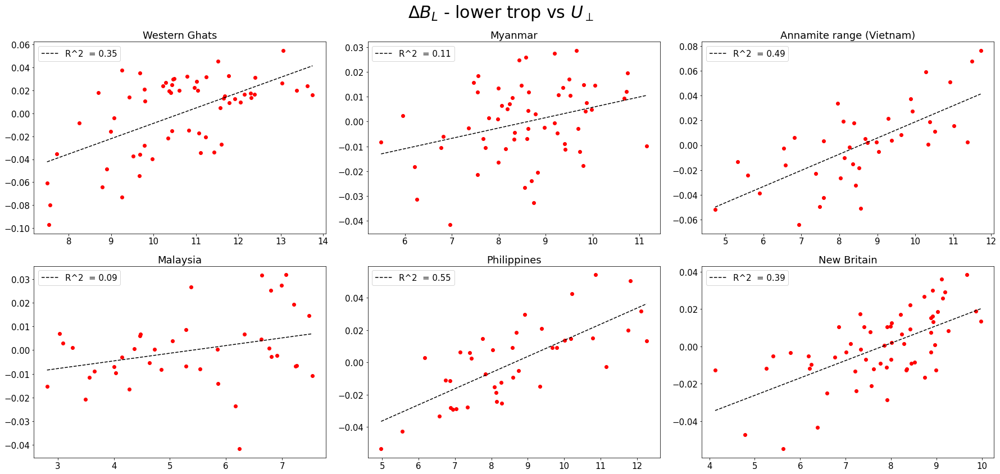

In [25]:
fig,axs = plt.subplots(2,3,figsize=(25,12))
axs=axs.reshape(-1)
for i,MR in enumerate(MRs):
    predqL = resample_monthly(dBLdqL*(MR.vars['QL_ABOVE_DAILY']-MR.vars['QL_ABOVE_DAILY'].mean('time'))*2.5e6/1004. )
    predTL = resample_monthly(dBLdTL*(MR.vars['TL_ABOVE_DAILY']-MR.vars['TL_ABOVE_DAILY'].mean('time')))
    wind =   resample_monthly(sel_box(MR.vars['VAR_100U_PERP_DAILY'],MR.box_wind).mean(('latitude','longitude')))
    
    axs[i].scatter(wind,predqL+predTL,color='r')
    x,y,rsq,popt = fit_coefs(np.array(wind),np.array(predqL+predTL),'linear')
    MR.linear_coefs_windBL = popt
    axs[i].plot(x,y,color='k',linestyle='--',label='R^2  = %.2f'%rsq)
    axs[i].set_title(MR.Lname)
    axs[i].legend()
    print(popt)
    
fig.suptitle(r"$\Delta B_L$ - lower trop vs $U_\perp$",fontsize=30)
fig.tight_layout()

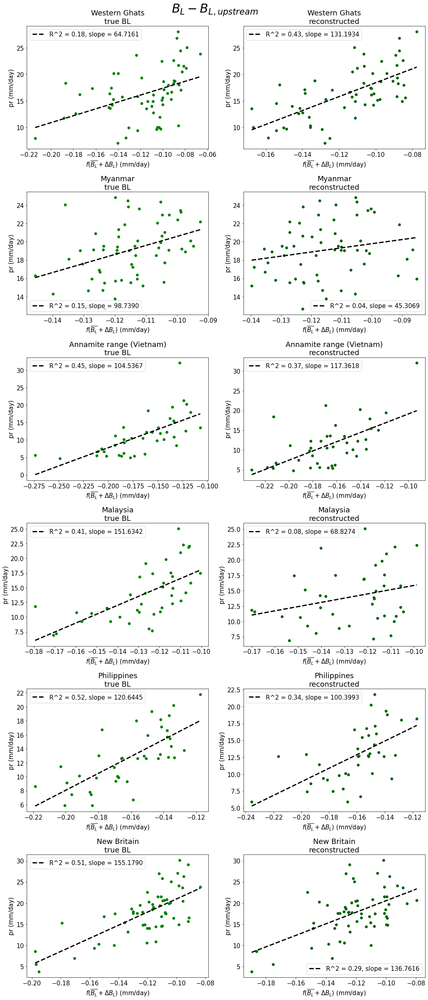

In [27]:
fig,axss = plt.subplots(6,2,figsize=(15,35))
for i,MR in enumerate(MRs):
    axs = axss[i]
    pr       = resample_monthly(MR.vars['GPM_PR_ABOVE_DAILY'])
    Bl_above = resample_monthly(MR.vars['BLSIMPLE_ABOVE_DAILY'])
    Bl_rce   = Bl_above.mean('time')
    
    wind   = resample_monthly(sel_box(MR.vars['VAR_100U_PERP_DAILY'],MR.box_wind).mean(('latitude','longitude')))
    predL  = resample_monthly(MR.linear_coefs_windBL[0]*wind + MR.linear_coefs_windBL[1])
    predeb = resample_monthly(dBLdeb*(MR.vars['EB_ABOVE_DAILY']-MR.vars['EB_ABOVE_DAILY'].mean('time')))
    
    for j,(pred1,c) in enumerate(zip((Bl_above-Bl_rce,predL+predeb),('g','darkgreen'))):
        pred = Bl_rce+pred1
        x,y,rsq,popt = fit_coefs(np.array(pred),np.array(pr),'linear')
        axs[j].scatter(pred,pr,color=c)
        axs[j].plot(x,y,color='k',linewidth=3,linestyle='--',label = 'R^2 = %.2f, slope = %.4f'%(rsq,popt[0]))
        axs[j].set_xlabel("$f(\overline{B_L}+\Delta B_L$) (mm/day)")
        axs[j].set_ylabel(r"pr (mm/day)")
        axs[j].legend()
    axs[0].set_title(MR.Lname + "\n" + "true BL")
    axs[1].set_title(MR.Lname + "\n" + "reconstructed")
    
fig.suptitle(r"$B_L-B_{L,upstream}$",fontsize=30)
fig.tight_layout()

# Diurnal cycle

In [52]:
Ghats      .oldname = "ghatswide"      
Myanmar    .oldname = "myanmarwide"    
Vietnam    .oldname = "vietnam"    
Malaysia   .oldname = "malaysia"   
Philippines.oldname = "philippines"
#Newbritain .oldname = "newbritainwide"

In [54]:
%%time
for MR in MRs:
    MR.pr_dc={}
    MR.uperp_dc={}
    for m in MR.months:
        trmmpr = xr.open_zarr("/global/cscratch1/sd/qnicolas/regionsData/trmm.2010-2013.{:02}.{}.zarr".format(m,MR.oldname)).pr*86400
        MR.pr_dc[m] = trmmpr.groupby('time.hour').mean().load()
        
        u100 = xr.open_zarr("/global/cscratch1/sd/qnicolas/regionsData/e5.oper.an.sfc.228_246_100u.ll025sc.2001-2020.{:02}.{}.zarr".format(m,MR.oldname)).VAR_100U
        u100 = u100.sel(time=((u100['time.year']>=2010)&(u100['time.year']<=2013)))
        v100 = xr.open_zarr("/global/cscratch1/sd/qnicolas/regionsData/e5.oper.an.sfc.228_247_100v.ll025sc.2001-2020.{:02}.{}.zarr".format(m,MR.oldname)).VAR_100V
        v100 = v100.sel(time=((v100['time.year']>=2010)&(v100['time.year']<=2013)))
        u = u100.groupby('time.hour').mean().load()
        v = v100.groupby('time.hour').mean().load()
        MR.uperp_dc[m] = crossslopeflow(u,v,MR.angle)
    

CPU times: user 10 s, sys: 3.48 s, total: 13.5 s
Wall time: 18.9 s


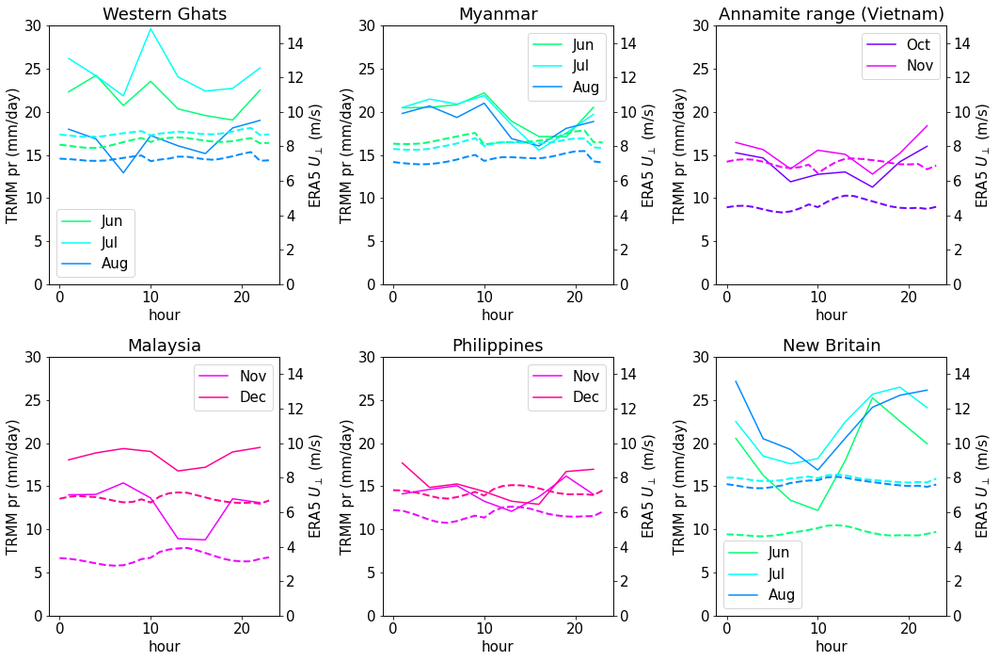

In [122]:
monthnames=['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

fig,axs=plt.subplots(2,3,figsize=(15,10))
axs=axs.reshape(-1)
colors = plt.cm.hsv(np.linspace(0,1,13)[:-1])
for i,MR in enumerate(MRs):
    ax=axs[i]
    ax2=ax.twinx()
    for m in MR.months:
        MR.pr_dc[m].plot(ax=ax,color=colors[m-1],label=monthnames[m-1])
        MR.uperp_dc[m].plot(ax=ax2,color=colors[m-1],linestyle='--',linewidth=2)
    ax.set_title(MR.Lname)
    ax.legend()
    ax.set_ylim(0,30)
    ax2.set_ylim(0,15)
    ax.set_ylabel("TRMM pr (mm/day)")
    ax2.set_ylabel(r"ERA5 $U_\perp$ (m/s)")
fig.tight_layout()

In [135]:
from sklearn import linear_model
def diurnal_regression(var):
    var = var.transpose('hour','latitude','longitude')
    nh,nlat,nlon = var.shape 
    omega = 2*np.pi/24
    preds = np.vstack((np.cos(omega*var.hour),np.sin(omega*var.hour))).transpose()
    model_ols =  linear_model.LinearRegression()
    model_ols.fit(preds,np.array(var).reshape((nh,-1)))
    dummy_ar = var.isel(hour=0)**0
    beta1 = dummy_ar * (model_ols.coef_[:,0]).reshape((nlat,nlon))
    beta2 = dummy_ar * (model_ols.coef_[:,1]).reshape((nlat,nlon))
    intercept = dummy_ar * (model_ols.intercept_).reshape((nlat,nlon))
    amplitude = np.sqrt(beta1**2+beta2**2).rename('amplitude')
    phase = np.mod( ((np.arctan(beta2/beta1) + (np.sign(beta1)<0)*np.pi)/omega) , 24).rename('phase')
    intercept = intercept.rename('intercept')
    return xr.merge((amplitude,phase,intercept))

In [140]:
for MR in MRs:
    MR.meanprdc = sum((MR.pr_dc[m] for m in MR.months))
    MR.dreg = diurnal_regression(MR.meanprdc)

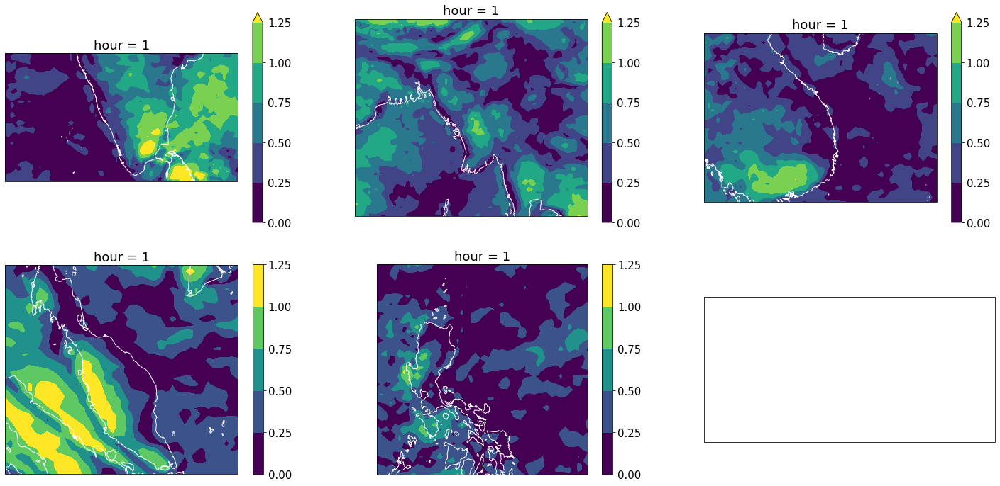

In [151]:

fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={'projection':ccrs.PlateCarree()})
axs=axs.reshape(-1)
for i,MR in enumerate(MRs):
    ax=axs[i]
    ax.coastlines(color='w')
    (MR.dreg.amplitude/MR.dreg.intercept).plot.contourf(ax=ax,levels=np.arange(0,1.3,0.25),transform = ccrs.PlateCarree())
    #dl=5
    #lons=range(dl*(1+(int(box[0])-1)//dl),dl*(int(box[1])//dl)+1,dl)
    #ax.set_xticks(lons)
    #ax.set_xticklabels(lons)
    #lats=range(dl*(1+(int(box[2])-1)//dl),dl*(int(box[3])//dl)+1,dl)
    #ax.set_yticks(lats)
    #ax.set_yticklabels(lats)
    #ax.set_xlabel("")
    #ax.set_ylabel("")
    #ax.set_title(MR.Lname,fontsize=15)

#fig.tight_layout()

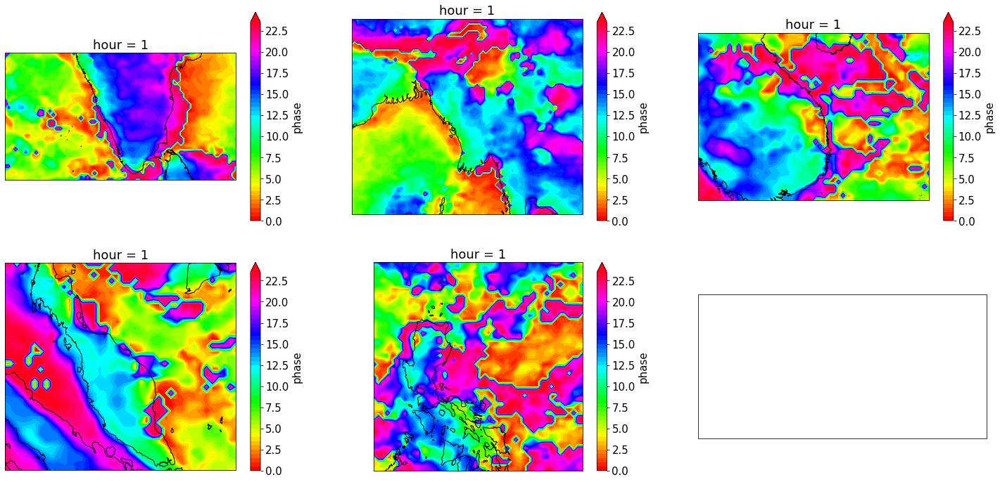

In [155]:

fig,axs = plt.subplots(2,3,figsize=(25,12),subplot_kw={'projection':ccrs.PlateCarree()})
axs=axs.reshape(-1)
for i,MR in enumerate(MRs):
    ax=axs[i]
    ax.coastlines(color='k')
    (MR.dreg.phase).plot.contourf(ax=ax,levels=np.arange(0,24,0.5),transform = ccrs.PlateCarree(),cmap=plt.cm.hsv)


#fig.tight_layout()

In [136]:
dreg = 


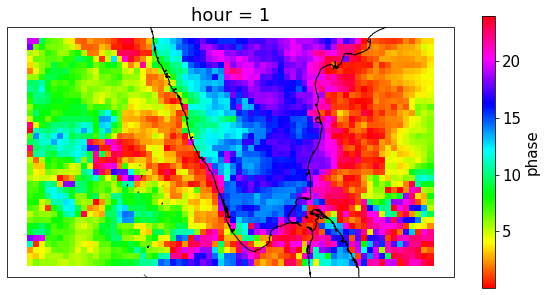

In [138]:

fig,ax = plt.subplots(1,1,figsize=(10,5),subplot_kw={'projection':ccrs.PlateCarree()})
ax.coastlines()
dreg.phase.plot(ax=ax,transform=ccrs.PlateCarree(),cmap = plt.cm.hsv)
